In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import utm
import folium

## Datos Bomberos

In [4]:
data_2022 = pd.read_csv("Datasets/ActuacionesBomberos_2022.csv", sep=';')
data_2023 = pd.read_csv("Datasets/ActuacionesBomberos_2023.csv", sep=';')

combined_data = pd.concat([data_2022, data_2023])

combined_data.head()

,AÑO,MES,DISTRITO,FUEGOS,DAÑOS EN CONSTRUCCION,SALVAMENTOS Y RESCATES,DAÑOS POR AGUA,INCIDENTES DIVERSOS,SALIDAS SIN INTERVENCION,SERVICIOS VARIOS,TOTAL
0,2022,diciembre,CENTRO,26,40,56,41,70,84,14,331
1,2022,diciembre,ARGANZUELA,6,11,12,10,6,34,2,81
2,2022,diciembre,RETIRO,4,9,15,12,10,16,2,68
3,2022,diciembre,SALAMANCA,7,15,31,13,23,29,8,126
4,2022,diciembre,CHAMARTIN,13,7,21,20,21,21,3,106


In [89]:
# Resumen estadístico del conjunto de datos
summary_statistics = combined_data.describe()

summary_statistics


,AÑO,FUEGOS,DAÑOS EN CONSTRUCCION,SALVAMENTOS Y RESCATES,DAÑOS POR AGUA,INCIDENTES DIVERSOS,SALIDAS SIN INTERVENCION,SERVICIOS VARIOS,TOTAL
count,505.000000,505.000000,505.000000,505.000000,505.000000,505.000000,505.000000,505.000000,505.000000
mean,2022.479208,26.720792,10.524752,37.257426,15.239604,35.029703,18.827723,6.392079,149.992079
std,0.500063,47.049654,23.773232,66.998201,29.951946,69.790369,21.850139,12.023651,260.543243
min,2022.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,2022.000000,10.000000,3.000000,16.000000,5.000000,11.000000,6.000000,2.000000,70.000000
50%,2022.000000,16.000000,6.000000,25.000000,9.000000,20.000000,14.000000,4.000000,103.000000
75%,2023.000000,26.000000,10.000000,34.000000,14.000000,33.000000,24.000000,7.000000,134.000000
max,2023.000000,444.000000,352.000000,721.000000,315.000000,675.000000,266.000000,130.000000,2903.000000


In [90]:
# Verificación de valores nulos en el conjunto de datos
null_values = combined_data.isnull().sum()

null_values


AÑO                         0
MES                         0
DISTRITO                    0
FUEGOS                      0
DAÑOS EN CONSTRUCCION       0
SALVAMENTOS Y RESCATES      0
DAÑOS POR AGUA              0
INCIDENTES DIVERSOS         0
SALIDAS SIN INTERVENCION    0
SERVICIOS VARIOS            0
TOTAL                       0
dtype: int64

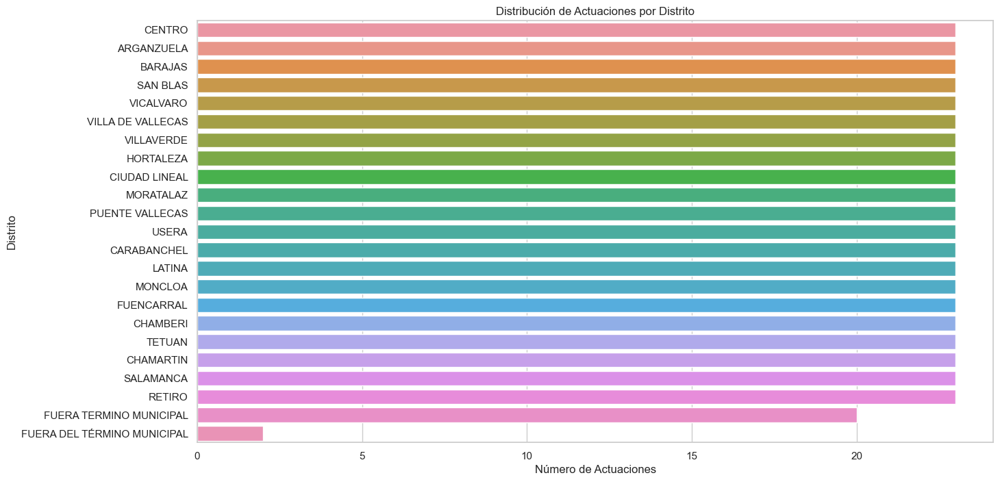

In [91]:
# Configuración de estilos de gráficos
sns.set(style="whitegrid")

# Distribución de actuaciones por distrito
plt.figure(figsize=(15, 8))
sns.countplot(data=combined_data, y='DISTRITO', order = combined_data['DISTRITO'].value_counts().index)
plt.title('Distribución de Actuaciones por Distrito')
plt.xlabel('Número de Actuaciones')
plt.ylabel('Distrito')
plt.show()

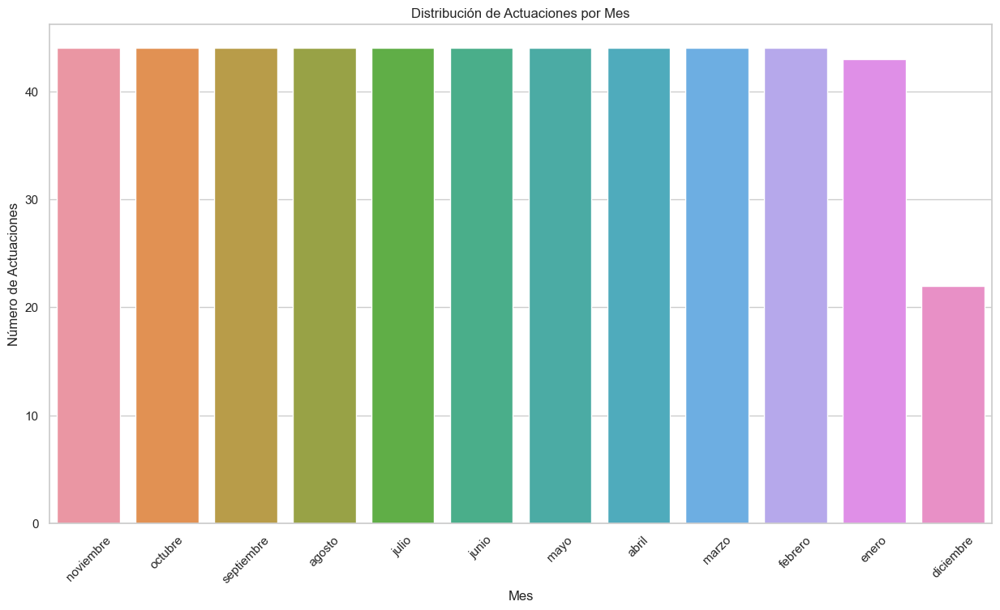

In [92]:
# Distribución de actuaciones por mes
plt.figure(figsize=(15, 8))
sns.countplot(data=combined_data, x='MES', order = combined_data['MES'].value_counts().index)
plt.title('Distribución de Actuaciones por Mes')
plt.xlabel('Mes')
plt.ylabel('Número de Actuaciones')
plt.xticks(rotation=45)
plt.show()

/home/duo/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/duo/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/duo/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/home/duo/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating inste

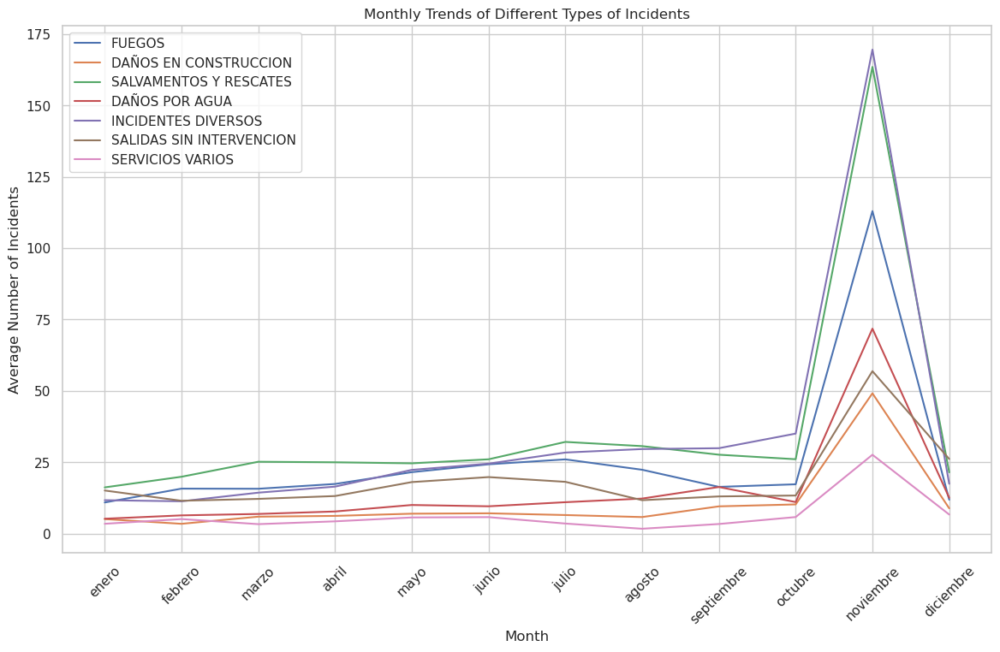

In [20]:

monthly_trends = combined_data.groupby('MES')[incident_columns].mean()

month_order = ['enero', 'febrero', 'marzo', 'abril', 'mayo', 'junio',
               'julio', 'agosto', 'septiembre', 'octubre', 'noviembre', 'diciembre']
monthly_trends = monthly_trends.reindex(month_order)

plt.figure(figsize=(14, 8))
for column in incident_columns:
    sns.lineplot(data=monthly_trends, x=monthly_trends.index, y=column, label=column)
plt.xticks(rotation=45)
plt.title('Monthly Trends of Different Types of Incidents')
plt.ylabel('Average Number of Incidents')
plt.xlabel('Month')
plt.legend()
plt.show()


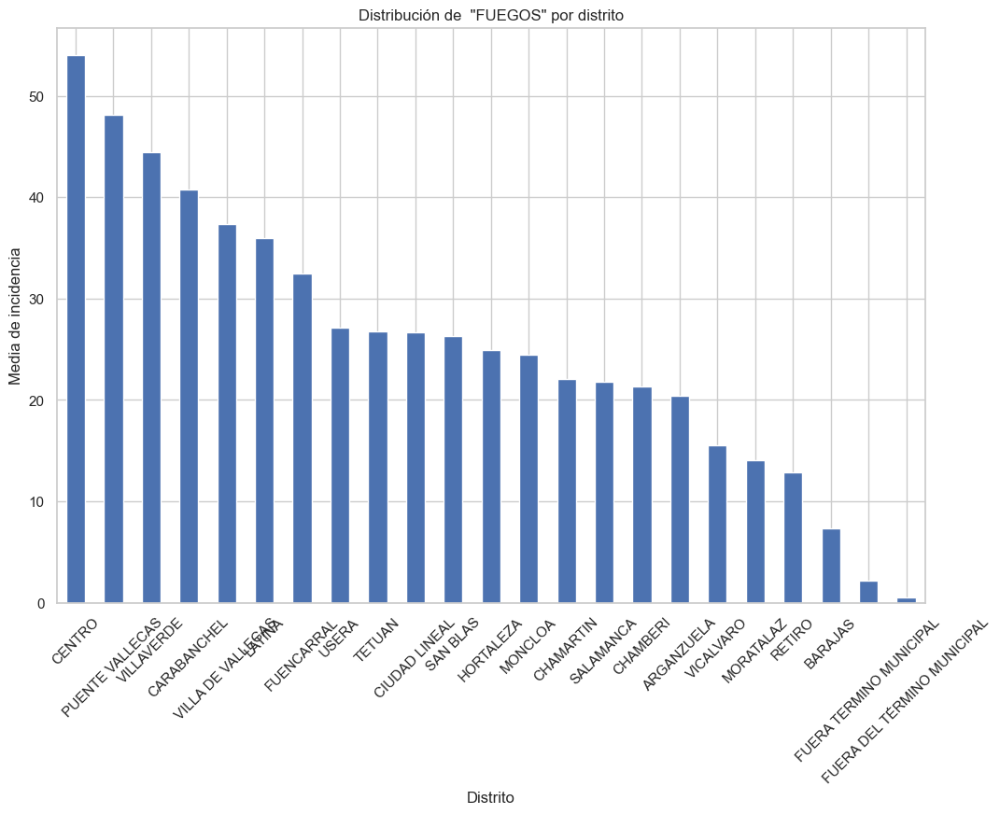

In [95]:
# For demonstration, let's choose 'FUEGOS' as the incident type
incident_type = 'FUEGOS'

# Grouping the data by district and calculating the mean for the selected type of incident
district_distribution = combined_data.groupby('DISTRITO')[incident_type].mean().sort_values(ascending=False)

# Plotting the distribution
plt.figure(figsize=(12, 8))
district_distribution.plot(kind='bar')
plt.title(f'Distribución de  "{incident_type}" por distrito')
plt.ylabel('Media de incidencia')
plt.xlabel('Distrito')
plt.xticks(rotation=45)
plt.show()

<Figure size 1200x800 with 0 Axes>

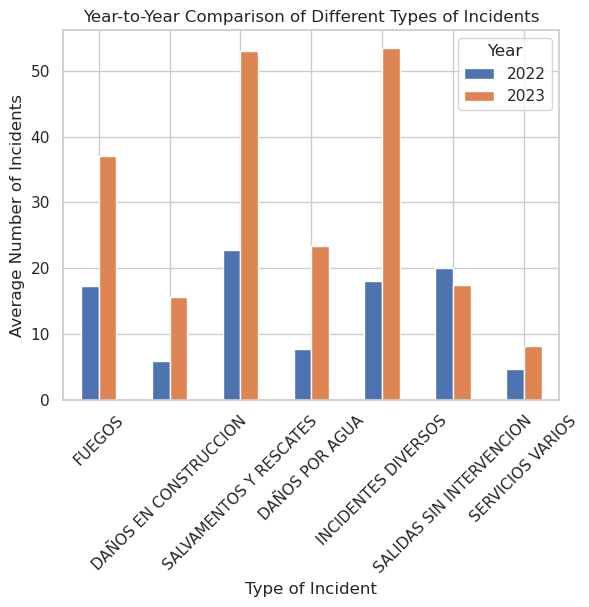

In [22]:
yearly_comparison = combined_data.groupby('AÑO')[incident_columns].mean()
plt.figure(figsize=(12, 8))
yearly_comparison.T.plot(kind='bar')
plt.title('Comparación año a año de incidentes')
plt.ylabel('Media de incidentes')
plt.xlabel('Tipo')
plt.xticks(rotation=45)
plt.legend(title='Año')
plt.show()

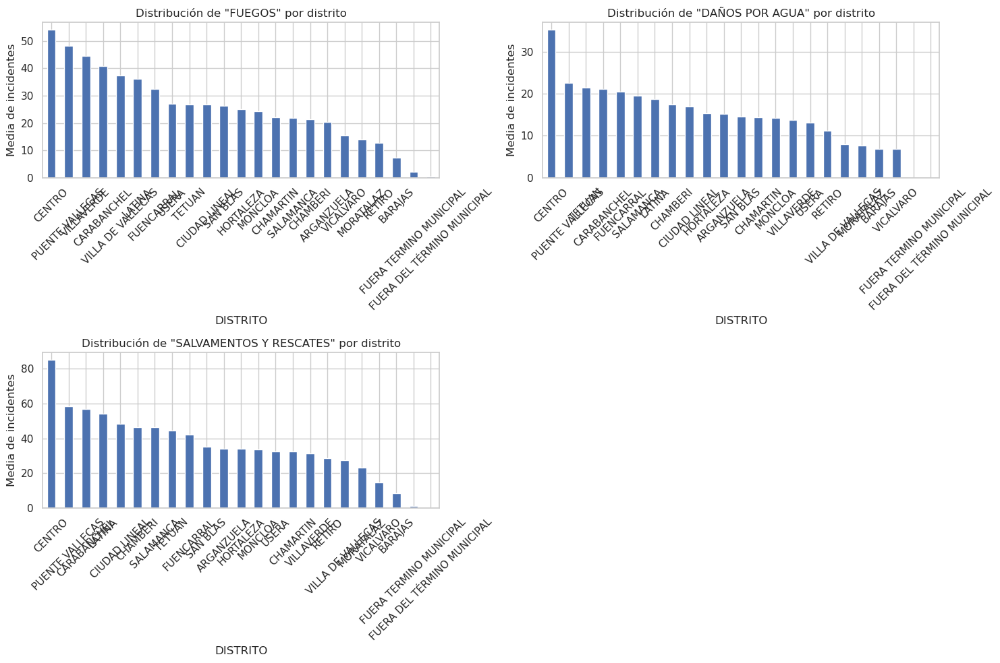

In [37]:

selected_incidents = ['FUEGOS', 'DAÑOS POR AGUA', 'SALVAMENTOS Y RESCATES']

# Grouping the data by district and calculating the mean for the selected types of incidents
district_incident_analysis = combined_data.groupby('DISTRITO')[selected_incidents].mean()

# Plotting the distribution
plt.figure(figsize=(15, 10))

for i, incident in enumerate(selected_incidents, 1):
    plt.subplot(2, 2, i)
    district_incident_analysis[incident].sort_values(ascending=False).plot(kind='bar')
    plt.title(f'Distribución de "{incident}" por distrito')
    plt.ylabel('Media de incidentes')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


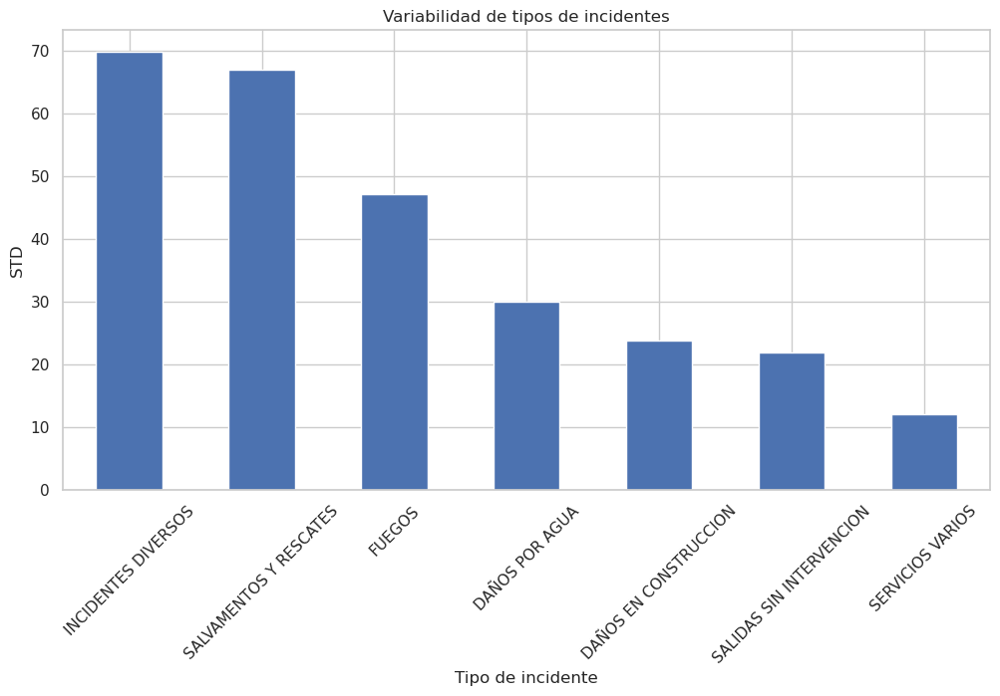

In [28]:

incident_variability = combined_data[incident_columns].std().sort_values(ascending=False)

# Plotting the incidents with their variability
plt.figure(figsize=(12, 6))
incident_variability.plot(kind='bar')
plt.title('Variabilidad de tipos de incidentes')
plt.ylabel('STD')
plt.xlabel('Tipo de incidente')
plt.xticks(rotation=45)
plt.show()


# Limpiado de Datos

## Accidentalidad 2022-2023

El fichero 202X_Accidentalidad.csv recoge los datos de Accidentes de tráfico en la Ciudad de Madrid registrados por la Policía Municipal.

1. Tomamos los datos de los ficheros 2022_Accidentalidad.csv y 2023_Accidentalidad.csv y creamos dataframes con los datos de los ficheros

In [63]:
accidentes_2022 = pd.read_csv('./Datasets/2022_Accidentalidad.csv', sep = ';')
accidentes_2022.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,Mujer,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,Hombre,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,Hombre,NaN,NaN,"441155,351","4474129,588",S,NaN,NaN,NaN
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,Mujer,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,Hombre,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN


In [64]:
accidentes_2023 = pd.read_csv('./Datasets/2023_Accidentalidad.csv', sep = ';')
accidentes_2023.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga
0,2023S000001,01/01/2023,1:15:00,"AVDA. ALFONSO XIII, 33",33,5.0,CHAMARTÍN,Alcance,Despejado,Todo terreno,Conductor,De 55 a 59 años,Mujer,14.0,Sin asistencia sanitaria,443397.166,4478129.388,N,NaN
1,2023S000001,01/01/2023,1:15:00,"AVDA. ALFONSO XIII, 33",33,5.0,CHAMARTÍN,Alcance,Despejado,Todo terreno,Pasajero,De 21 a 24 años,Hombre,14.0,Sin asistencia sanitaria,443397.166,4478129.388,N,NaN
2,2023S000001,01/01/2023,1:15:00,"AVDA. ALFONSO XIII, 33",33,5.0,CHAMARTÍN,Alcance,Despejado,Todo terreno,Pasajero,De 21 a 24 años,Hombre,14.0,Sin asistencia sanitaria,443397.166,4478129.388,N,NaN
3,2023S000001,01/01/2023,1:15:00,"AVDA. ALFONSO XIII, 33",33,5.0,CHAMARTÍN,Alcance,Despejado,Todo terreno,Pasajero,De 21 a 24 años,Mujer,7.0,Asistencia sanitaria sólo en el lugar del acci...,443397.166,4478129.388,N,NaN
4,2023S000001,01/01/2023,1:15:00,"AVDA. ALFONSO XIII, 33",33,5.0,CHAMARTÍN,Alcance,Despejado,Todo terreno,Pasajero,De 55 a 59 años,Hombre,7.0,Asistencia sanitaria sólo en el lugar del acci...,443397.166,4478129.388,N,NaN


2. Combinamos los dataframes en uno solo para facilitar el trabajo y si hay filas duplicadas o filas completamente nulas las eliminamos para evitar tener datos repetidos

In [65]:
combined_data = pd.concat([accidentes_2022, accidentes_2023])
# Restablecer índices para evitar índices duplicados
combined_data.reset_index(drop=True, inplace=True)
# Limpiar los datos
combined_data.drop_duplicates(inplace=True)
combined_data.dropna(how='all', inplace=True)

### Cazar valores nulos
Buscamos nulos en las distintas columnas para mantener la integridad de los datos, conseguir precisión en el análisis, lograr compatibilidad con algoritmos y optimizar recursos

In [66]:
filas_con_nulos = combined_data['tipo_persona'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20


In [67]:
filas_con_nulos = combined_data['tipo_vehiculo'].isnull()
combined_data[filas_con_nulos].head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
291,2022S000148,04/01/2022,18:15:00,CALL. EDUARDO BARREIROS / AVDA. POBLADOS,5,12.0,USERA,Colisión lateral,Lluvia débil,NaN,...,Desconocido,Desconocido,NaN,NaN,"440801,217","4469164,69",NaN,NaN,NaN,NaN
341,2022S000180,04/01/2022,20:25:00,AVDA LOS POBLADOS - C/ EXPROPIACIÓN,146,12.0,USERA,Colisión lateral,Nublado,NaN,...,Desconocido,Desconocido,NaN,NaN,"440082,365","4469234,182",N,NaN,NaN,NaN
634,2022S000342,08/01/2022,0:00:00,"CALL. PUERTO RICO, 6A",6A,5.0,CHAMARTÍN,Colisión lateral,Despejado,NaN,...,Desconocido,Desconocido,NaN,NaN,"442801,043","4478205,366",NaN,NaN,NaN,NaN
661,2022S000356,08/01/2022,15:07:00,CALL. FRANCISCO JOSE ARROYO / CALL. ARMONIA,2,16.0,HORTALEZA,Colisión múltiple,Despejado,NaN,...,Desconocido,Desconocido,NaN,NaN,"448109,781","4478305,503",N,NaN,NaN,NaN
764,2022S000413,09/01/2022,12:46:00,CALL. ESTRONCIO / CALL. BENITA LOPEZ,17,17.0,VILLAVERDE,Colisión múltiple,NaN,NaN,...,Desconocido,Desconocido,NaN,NaN,"441498,93","4466555,878",N,NaN,NaN,NaN


In [68]:
filas_con_nulos = combined_data['fecha'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20


In [69]:
filas_con_nulos = combined_data['tipo_accidente'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
73578,2023S025389,14/07/2023,23:45:00,"CALL. EDUARDO BARREIROS, 29",29,12.0,USERA,NaN,NaN,NaN,...,De 35 a 39 años,Hombre,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN


Observamos que solo es una columna en la cual el tipo de accidente es nulo y, aunque sea solo una entre 74,961, ese registro carece de información crucial para el análisis. La falta de datos en 'tipo_accidente' puede generar interpretaciones erróneas o distorsionar los resultados al analizar las causas y naturaleza de los accidentes e inferir con el análisis.

In [70]:
combined_data.dropna(subset=['tipo_accidente'], inplace=True)
combined_data.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,Mujer,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,Hombre,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,Hombre,NaN,NaN,"441155,351","4474129,588",S,NaN,NaN,NaN
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,Mujer,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,Hombre,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN


In [71]:
filas_con_nulos = combined_data['sexo'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20


In [72]:
filas_con_nulos = combined_data['positiva_alcohol'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
291,2022S000148,04/01/2022,18:15:00,CALL. EDUARDO BARREIROS / AVDA. POBLADOS,5,12.0,USERA,Colisión lateral,Lluvia débil,NaN,...,Desconocido,Desconocido,NaN,NaN,"440801,217","4469164,69",NaN,NaN,NaN,NaN
634,2022S000342,08/01/2022,0:00:00,"CALL. PUERTO RICO, 6A",6A,5.0,CHAMARTÍN,Colisión lateral,Despejado,NaN,...,Desconocido,Desconocido,NaN,NaN,"442801,043","4478205,366",NaN,NaN,NaN,NaN
658,2022S000354,07/01/2022,23:15:00,AVDA. ILUSTRACION / CALL. GINZO DE LIMIA,0,8.0,FUENCARRAL-EL PARDO,Colisión lateral,Despejado,Turismo,...,Desconocido,Desconocido,NaN,NaN,"440196,519","4481492,133",NaN,NaN,NaN,NaN
1479,2022S000832,15/01/2022,22:35:00,"CTRA. M-111, ROTONDA SALIDA AVENIDA DE LOGROÑO",+00300E,21.0,BARAJAS,Colisión fronto-lateral,NaN,Turismo,...,Desconocido,Desconocido,NaN,NaN,"452984,27","4482774,785",NaN,NaN,NaN,NaN
1907,2022S001130,19/01/2022,20:09:00,"CALL. LA DEL MANOJO DE ROSAS, 69",69,17.0,VILLAVERDE,Colisión fronto-lateral,NaN,Furgoneta,...,Desconocido,Desconocido,NaN,NaN,"440748,938","4467397,024",NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
77537,2023S027875,24/08/2023,16:45:00,"CALL. LINNEO, 5",5,2.0,ARGANZUELA,Atropello a persona,Despejado,NaN,...,Desconocido,Desconocido,NaN,NaN,438869.987,4473821.066,NaN,NaN,NaN,NaN
77628,2023S027925,25/08/2023,9:35:00,CALLE BOYER CON CALLE VIGIL,26,19.0,VICÁLVARO,Colisión fronto-lateral,Despejado,Motocicleta hasta 125cc,...,Desconocido,Desconocido,NaN,NaN,450240.246,4472879.377,NaN,NaN,NaN,NaN
77629,2023S027925,25/08/2023,9:35:00,CALLE BOYER CON CALLE VIGIL,26,19.0,VICÁLVARO,Colisión fronto-lateral,Despejado,Turismo,...,Desconocido,Desconocido,NaN,NaN,450240.246,4472879.377,NaN,NaN,NaN,NaN
77701,2023S027997,26/08/2023,19:45:00,CALL. JULIA GARCIA BOUTAN / CALL. SUECIA,35A,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Turismo,...,Desconocido,Desconocido,NaN,NaN,448648.202,4475686.579,NaN,NaN,NaN,NaN


In [73]:
filas_con_nulos = combined_data['positiva_droga'].isnull()
combined_data[filas_con_nulos]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,Unnamed: 19,Unnamed: 20
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,Mujer,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,Hombre,NaN,NaN,"443359,226","4472082,272",N,NaN,NaN,NaN
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,Hombre,NaN,NaN,"441155,351","4474129,588",S,NaN,NaN,NaN
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,Mujer,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,Hombre,NaN,NaN,"441155,351","4474129,588",N,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78206,2023S028337,31/08/2023,23:20:00,"CALL. GOLFO DE SALONICA, 12",12,16.0,HORTALEZA,Otro,Despejado,Turismo,...,De 55 a 59 años,Mujer,14.0,Sin asistencia sanitaria,443580.365,4480912.376,N,NaN,NaN,NaN
78207,2023S028341,31/08/2023,22:30:00,CALLE SAN SERAPIO,1,12.0,USERA,Alcance,Despejado,Motocicleta hasta 125cc,...,De 30 a 34 años,Hombre,7.0,Asistencia sanitaria sólo en el lugar del acci...,440795.55,4471044.789,N,NaN,NaN,NaN
78208,2023S028341,31/08/2023,22:30:00,CALLE SAN SERAPIO,1,12.0,USERA,Alcance,Despejado,Turismo,...,De 35 a 39 años,Hombre,14.0,Sin asistencia sanitaria,440795.55,4471044.789,N,NaN,NaN,NaN
78209,2023S028352,31/08/2023,14:40:00,"AUTOV. M-30, 00NC06",00NC06,5.0,CHAMARTÍN,Caída,Despejado,Motocicleta hasta 125cc,...,De 40 a 44 años,Hombre,1.0,Atención en urgencias sin posterior ingreso,442825.5,4481003.193,N,NaN,NaN,NaN


Eliminamos unas columnas no deseadas 'Unnamed', ya que probablemente haya sido un error del autor y nos molesta

In [74]:
combined_data.drop(columns=[col for col in combined_data.columns if col.startswith("Unnamed")], inplace=True)
combined_data.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,Conductor,De 30 a 34 años,Mujer,NaN,NaN,"443359,226","4472082,272",N,NaN
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,Conductor,De 45 a 49 años,Hombre,NaN,NaN,"443359,226","4472082,272",N,NaN
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,Conductor,De 30 a 34 años,Hombre,NaN,NaN,"441155,351","4474129,588",S,NaN
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,Pasajero,De 35 a 39 años,Mujer,NaN,NaN,"441155,351","4474129,588",N,NaN
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,Conductor,De 40 a 44 años,Hombre,NaN,NaN,"441155,351","4474129,588",N,NaN


## Uniformidad

1. Cambiamos los nulos de positiva_droga por un 0 y en positiva_alcohol 'S' por 1 y 'N' por 0 para mantener la uniformidad

In [75]:
# Cambiamos en 'positiva_alcohol'
combined_data['positiva_alcohol'].replace({'S': 1, 'N': 0}, inplace=True)
# Cambiamos en 'positiva_droga' y 'positiva_alcohol los nulls
combined_data['positiva_alcohol'].fillna(0, inplace=True)
combined_data['positiva_droga'].fillna(0, inplace=True)
# Verificamos los cambios y si todavía hay valores nulos en la columna 'positiva_droga'
combined_data['positiva_alcohol'].value_counts(), combined_data['positiva_droga'].isnull().sum()

(0.0    72591
 1.0     2370
 Name: positiva_alcohol, dtype: int64,
 0)

In [76]:
combined_data.filter(['rango_edad','tipo_persona', 'tipo_vehiculo']).groupby('rango_edad').value_counts()

rango_edad       tipo_persona  tipo_vehiculo              
De 10 a 14 años  Pasajero      Turismo                        426
                 Peatón        Turismo                         96
                 Conductor     VMU eléctrico                   36
                               Bicicleta                       35
                 Pasajero      Furgoneta                       15
                                                             ... 
Más de 74 años   Pasajero      Autobus EMT                      1
                 Conductor     Cuadriciclo ligero               1
                               Moto de tres ruedas > 125cc      1
                               Otros vehículos con motor        1
                               Sin especificar                  1
Length: 752, dtype: int64

In [77]:
combined_data[combined_data['rango_edad'].isin(['Menor de 5 años'])][combined_data['tipo_persona']=='Conductor']

C:\Users\Usuario\AppData\Local\Temp\ipykernel_17948\1998939041.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  combined_data[combined_data['rango_edad'].isin(['Menor de 5 años'])][combined_data['tipo_persona']=='Conductor']


,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga
2136,2022S001261,21/01/2022,15:09:00,"AUTOV. M-30, CALZADA 1, PK 11,3",+01100I,2.0,ARGANZUELA,Alcance,NaN,Furgoneta,Conductor,Menor de 5 años,Hombre,NaN,NaN,"442301,329","4471190,762",0.0,0.0
2275,2022S001385,22/01/2022,7:40:00,"CALL. ARTURO SORIA, 168",168,15.0,CIUDAD LINEAL,Choque contra obstáculo fijo,Despejado,Turismo,Conductor,Menor de 5 años,Mujer,NaN,NaN,"444369,976","4478512,823",0.0,0.0
5968,2022S003847,17/02/2022,15:05:00,"PASEO. PINTOR ROSALES, 38",38,9.0,MONCLOA-ARAVACA,Alcance,Despejado,Turismo,Conductor,Menor de 5 años,Hombre,NaN,NaN,"438869,786","4475495,238",0.0,0.0
6209,2022S004121,19/02/2022,2:25:00,CALL. PRINCESA / CALL. ALBERTO AGUILERA,56,1.0,CENTRO,Colisión fronto-lateral,Despejado,Turismo,Conductor,Menor de 5 años,Hombre,14.0,Sin asistencia sanitaria,"439261,101","4475789,368",0.0,0.0
7862,2022S005583,03/03/2022,19:45:00,CALL. SATURNINO TEJERA / CALL. JUANA UROSA,2,11.0,CARABANCHEL,Colisión fronto-lateral,Nublado,Turismo,Conductor,Menor de 5 años,Hombre,NaN,NaN,"436832,954","4470736,494",0.0,0.0
9718,2022S007410,18/03/2022,17:10:00,"CALL. OFELIA NIETO, 21",21,9.0,MONCLOA-ARAVACA,Colisión fronto-lateral,Despejado,Turismo,Conductor,Menor de 5 años,Hombre,NaN,NaN,"439772,859","4478977,338",0.0,0.0
9809,2022S007547,18/03/2022,10:40:00,"GTA. RICARDO VELAZQUEZ BOSCO, 2",2,20.0,SAN BLAS-CANILLEJAS,Colisión lateral,Nublado,Turismo,Conductor,Menor de 5 años,Hombre,NaN,NaN,"446897,241","4477599,013",0.0,0.0
10364,2022S008033,23/03/2022,18:50:00,"CALL. PRECIADOS, 35",35,1.0,CENTRO,Choque contra obstáculo fijo,Nublado,Furgoneta,Conductor,Menor de 5 años,Hombre,NaN,NaN,"440006,944","4474581,853",0.0,0.0
11130,2022S008620,25/03/2022,21:10:00,"CALL. NUESTRA SEÑORA DE LUJAN, 1",1,5.0,CHAMARTÍN,Colisión lateral,LLuvia intensa,Todo terreno,Conductor,Menor de 5 años,Hombre,NaN,NaN,"442214,205","4478930,37",0.0,0.0
12484,2022S009704,08/04/2022,4:05:00,CALL. TOLEDO / CALL. ARGANZUELA,86,1.0,CENTRO,Alcance,Despejado,Turismo,Conductor,Menor de 5 años,Hombre,NaN,NaN,"439722,112","4473371,721",0.0,0.0


### Agregamos columna 'numero_pasajeros' y Reemplazamos datos erroneos
Estos datos tienen que ser erróneos sí o sí, ya que la ley dicta que ningún menor de 18 años puede conducir en España. Para arreglar este problema, todos los casos que la edad sea 'Menor de 5 años', 'De 10 a 14 años', 'De 15 a 17 años' y sean conductores de vehículos, excluyendo: **'Bicicleta EPAC (pedaleo asistido)', 'Bicicleta', 'VMU eléctrico', 'Cuadriciclo ligero', 'Motocicleta hasta 125cc', 'Ciclomotor' y 'Ciclo'**, ya que está permitido conducir dichos vehículos para menores de 18 los dividiremos en 2 casos:
1. Si existe más de 1 pasajero en el vehículo cambiamos el tipo de persona a 'Pasajero'
2. Cuando sea el único pasajero del vehículo cambiamos la edad a 'Desconocido', ya que se concluye que hubo un error al introducir la edad

In [78]:
# Agregando la columna 'numero_pasajeros'
combined_data['numero_pasajeros'] = combined_data.groupby('num_expediente')['num_expediente'].transform('count')

# Filtrando datos para encontrar los registros donde el rango de edad es 'Menor de 5 años', el tipo de persona es 'Conductor',
# y el tipo de vehículo no es ni 'Bicicleta EPAC (pedaleo asistido)', 'Bicicleta', 'VMU eléctrico', 'Cuadriciclo ligero'
# 'Motocicleta hasta 125cc', 'Ciclomotor' o 'Ciclo'
faulty_data = combined_data[
    ((combined_data['rango_edad'] == 'Menor de 5 años') |
     (combined_data['rango_edad'] == 'De 10 a 14 años') |
     (combined_data['rango_edad'] == 'De 15 a 17 años')) &
    (combined_data['tipo_persona'] == 'Conductor') &
    (~combined_data['tipo_vehiculo'].isin(['Bicicleta EPAC (pedaleo asistido)', 'Bicicleta', 'VMU eléctrico', 'Cuadriciclo ligero'
                                           , 'Motocicleta hasta 125cc', 'Ciclomotor', 'Ciclo']))
    ]


# Revisando si hay más de un pasajero en los registros filtrados y realizando los reemplazos correspondientes
if faulty_data['numero_pasajeros'].gt(1).any():
    # Cambiar 'tipo_persona' a 'Pasajero' para registros donde hay más de un pasajero
    combined_data.loc[faulty_data.index, 'tipo_persona'] = 'Pasajero'
else:
    # Cambiar 'rango_edad' a 'Desconocido' si no hay más de un pasajero
    combined_data.loc[faulty_data.index, 'rango_edad'] = 'Desconocido'




# Filtrar por tipo_persona 'Conductor' y por los rangos de edad de interés
conductores_rangos_edad = combined_data[
    (combined_data['tipo_persona'] == 'Conductor') &
    (combined_data['rango_edad'].isin(['De 10 a 14 años', 'De 15 a 17 años', 'Menor de 5 años']))
    ]

conductores_rangos_edad.groupby(['rango_edad', 'tipo_vehiculo']).size()

rango_edad       tipo_vehiculo                    
De 10 a 14 años  Bicicleta                            35
                 VMU eléctrico                        36
De 15 a 17 años  Bicicleta                            28
                 Bicicleta EPAC (pedaleo asistido)     9
                 Ciclo                                 2
                 Ciclomotor                           16
                 Cuadriciclo ligero                   19
                 Motocicleta hasta 125cc              11
                 VMU eléctrico                        82
Menor de 5 años  Bicicleta                             1
                 Bicicleta EPAC (pedaleo asistido)     1
dtype: int64

In [79]:
combined_data.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,Conductor,De 30 a 34 años,Mujer,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,Conductor,De 45 a 49 años,Hombre,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,Conductor,De 30 a 34 años,Hombre,NaN,NaN,"441155,351","4474129,588",1.0,0.0,3
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,Pasajero,De 35 a 39 años,Mujer,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,Conductor,De 40 a 44 años,Hombre,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3


In [96]:
#combined_data.to_csv('./Datasets/Data_Combinada.csv', index=False)

In [2]:
df_Limpieza1 = pd.read_csv('Datasets/Data_Combinada.csv')

/tmp/ipykernel_7362/4064952317.py:1: DtypeWarning: Columns (15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('Datasets/Data_Combinada.csv')


In [3]:
df_Limpieza1[df_Limpieza1['cod_distrito'].isnull()]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
54805,2023S009762,16/03/2023,22:40:00,GTA. ISIDRO GONZALEZ VELAZQUEZ / CALL. FRANCIS...,NaN,NaN,NaN,Choque contra obstáculo fijo,Despejado,Turismo,...,De 45 a 49 años,M,NaN,NaN,446979.419,4481398.946,0.0,0.0,1,No


Se realiza una búsqueda en google de la dirección para saber el distrito. Resulta que es distrito de barajas
Con código postal 28055

In [4]:
df_Limpieza1[df_Limpieza1['distrito'] == 'BARAJAS'].head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
172,2022S000091,03/01/2022,9:50:00,"AEROP. TERMINAL T-2, 0",0,21.0,BARAJAS,Colisión lateral,Despejado,Turismo,...,De 35 a 39 años,H,NaN,NaN,"451350,93","4479345,54",0.0,0.0,2,No
173,2022S000091,03/01/2022,9:50:00,"AEROP. TERMINAL T-2, 0",0,21.0,BARAJAS,Colisión lateral,Despejado,Turismo,...,De 55 a 59 años,H,NaN,NaN,"451350,93","4479345,54",0.0,0.0,2,No
422,2022S000240,06/01/2022,10:00:00,SALIDA M-11,1,21.0,BARAJAS,Caída,Despejado,Motocicleta hasta 125cc,...,De 40 a 44 años,H,1.0,Atención en urgencias sin posterior ingreso,"447558,404","4480407,883",0.0,0.0,1,No
546,2022S000298,07/01/2022,16:35:00,GTA. ERMITA DE LA VIRGEN DE LA SOLEDAD / AVDA....,0,21.0,BARAJAS,Alcance,Despejado,Turismo,...,De 25 a 29 años,M,14.0,Sin asistencia sanitaria,"450586,357","4479813,482",0.0,0.0,2,No
547,2022S000298,07/01/2022,16:35:00,GTA. ERMITA DE LA VIRGEN DE LA SOLEDAD / AVDA....,0,21.0,BARAJAS,Alcance,Despejado,Turismo,...,De 40 a 44 años,M,7.0,Asistencia sanitaria sólo en el lugar del acci...,"450586,357","4479813,482",0.0,0.0,2,No


In [5]:
df_Limpieza1.loc[54805, 'cod_distrito'] = 21
df_Limpieza1.loc[54805, 'distrito'] = 'BARAJAS'
df_Limpieza1.loc[54805]

num_expediente                                                2023S009762
fecha                                                          16/03/2023
hora                                                             22:40:00
localizacion            GTA. ISIDRO GONZALEZ VELAZQUEZ / CALL. FRANCIS...
numero                                                                NaN
cod_distrito                                                         21.0
distrito                                                          BARAJAS
tipo_accidente                               Choque contra obstáculo fijo
estado_meteorológico                                            Despejado
tipo_vehiculo                                                     Turismo
tipo_persona                                                    Conductor
rango_edad                                                De 45 a 49 años
sexo                                                                    M
cod_lesividad                         

In [6]:
df_Limpieza1.to_csv('Datasets/Data_Combinada.csv', index=False)

# Deteccion de Fugados en accidentes

## Hemos detectado que se repetía una serie de datos nulos en varias columnas, siempre coincidiendo

Al momento de observar los nulos en la columna 'tipo_vehiculo' nos dimos cuenta que coincidía que 6 columnas son nulas, nuestra teoría es que son personas fugadas, además solo añade los conductores

Visto el dataframe anterior observamos que nuestra teoría de que estas entradas podrían representar a personas que huyeron de la escena del accidente tiene sentido por:

1. **Falta de información detallada**: La ausencia de detalles como el tipo de vehículo y el sexo del conductor sugiere que no hubo una interacción exhaustiva con estas personas después del accidente. La presencia de resultados negativos en las pruebas de drogas y alcohol, en medio de otros datos desconocidos, puede indicar errores humanos, ya sea por parte del oficial que atendió el accidente o de la persona que recopiló y registró los datos en el CSV.

2. **Resultados negativos en pruebas, pero falta de otros detalles**: Si bien algunos conductores dieron negativo en las pruebas de drogas y alcohol, la falta de información complementaria es llamativa. Es raro que un conductor que cooperó lo suficiente como para someterse a una prueba luego no proporcionara otros detalles esenciales. Esto puede sugerir un error en la recolección o registro de la información, o posiblemente que el conductor huyó después de la prueba.

3. **Información sobre el tipo de accidente**: Aunque falta información detallada sobre el conductor, sí hay datos sobre el tipo de accidente. Esto podría indicar que, aunque el conductor en cuestión no proporcionó detalles o se fugó, otros involucrados en el accidente o testigos pudieron haber dado testimonio sobre la naturaleza del choque, lo que permitió clasificar el tipo de accidente.

Una vez analizado lo anterior añadimos una columna para los conductores fugados

# Deteccion de Fugados en accidentes

## Hemos detectado que se repetía una serie de datos nulos en varias columnas, siempre coincidiendo

Al momento de observar los nulos en la columna 'tipo_vehiculo' nos dimos cuenta que coincidía que 6 columnas son nulas, nuestra teoría es que son personas fugadas, además solo añade los conductores

Visto el dataframe anterior observamos que nuestra teoría de que estas entradas podrían representar a personas que huyeron de la escena del accidente tiene sentido por:

1. **Falta de información detallada**: La ausencia de detalles como el tipo de vehículo y el sexo del conductor sugiere que no hubo una interacción exhaustiva con estas personas después del accidente. La presencia de resultados negativos en las pruebas de drogas y alcohol, en medio de otros datos desconocidos, puede indicar errores humanos, ya sea por parte del oficial que atendió el accidente o de la persona que recopiló y registró los datos en el CSV.

2. **Resultados negativos en pruebas, pero falta de otros detalles**: Si bien algunos conductores dieron negativo en las pruebas de drogas y alcohol, la falta de información complementaria es llamativa. Es raro que un conductor que cooperó lo suficiente como para someterse a una prueba luego no proporcionara otros detalles esenciales. Esto puede sugerir un error en la recolección o registro de la información, o posiblemente que el conductor huyó después de la prueba.

3. **Información sobre el tipo de accidente**: Aunque falta información detallada sobre el conductor, sí hay datos sobre el tipo de accidente. Esto podría indicar que, aunque el conductor en cuestión no proporcionó detalles o se fugó, otros involucrados en el accidente o testigos pudieron haber dado testimonio sobre la naturaleza del choque, lo que permitió clasificar el tipo de accidente.

Una vez analizado lo anterior añadimos una columna para los conductores fugados

In [3]:
# Crear la columna 'fugado' con valores por defecto en 'No'
combined_data['fugado'] = 'No'

# Identificar las filas que cumplen con las condiciones que sugieren un posible fugado y asignarles 'Sí'
condition = (combined_data['tipo_persona'] == 'Conductor') & (combined_data['tipo_vehiculo'].isnull()) & (combined_data['sexo'] == 'Desconocido')
combined_data.loc[condition, 'fugado'] = 'Si'

combined_data['fugado'].value_counts()

fugado
No    74576
Si      385
Name: count, dtype: int64

Observamos que de los 74961 incidentes en informe, al menos 385 son fugados. Lo que conforma el 0.51% de los datos

Cambiamos el 'tipo_vehiculo' de los peatones a 'No' para eliminar datos nulos

In [4]:
combined_data['tipo_persona'].replace({'Peatón': 'No'}, inplace=True)

Verificamos si siguen existiendo nulos en 'tipo_vehiculo' que no sean fugados ni peatones

In [5]:
filas_con_nulos = combined_data['tipo_vehiculo'].isnull()
combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']

/tmp/ipykernel_7226/1340320582.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']
/tmp/ipykernel_7226/1340320582.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']


,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
5391,2022S003477,11/02/2022,19:25:00,CALL. PEDRO RICO / CALL. ARZOBISPO MORCILLO,25,8.0,FUENCARRAL-EL PARDO,Colisión fronto-lateral,Despejado,NaN,...,De 30 a 34 años,Mujer,NaN,NaN,"441574,126","4481237,895",0.0,0.0,2,No
44829,2022S041133,30/12/2022,9:15:00,"CALL. CAVANILLES, 46",46,3.0,RETIRO,Colisión lateral,Despejado,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,"442968,147","4472839,466",0.0,0.0,2,No
44830,2022S041133,30/12/2022,9:15:00,"CALL. CAVANILLES, 46",46,3.0,RETIRO,Colisión lateral,Despejado,NaN,...,De 55 a 59 años,Mujer,NaN,NaN,"442968,147","4472839,466",0.0,0.0,2,No
56861,2023S012840,01/04/2023,8:00:00,"AUTOV. M-30 KM 22,700 CALZADA 1",22NC70,9.0,MONCLOA-ARAVACA,Colisión lateral,Despejado,NaN,...,De 50 a 54 años,Hombre,14.0,Sin asistencia sanitaria,437049.594,4478099.656,0.0,0.0,2,No
60411,2023S017628,28/04/2023,14:07:00,"CALL. DOCTOR TOLOSA LATOUR, 16",16,12.0,USERA,Alcance,NaN,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,440392.542,4469516.026,0.0,0.0,2,No
60423,2023S017637,28/04/2023,16:35:00,CARRETERA VILLAVERDE VALLECAS,0,13.0,PUENTE DE VALLECAS,Colisión fronto-lateral,NaN,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,443682.366,4468805.152,0.0,0.0,2,No
64985,2023S021600,02/06/2023,11:35:00,CALL. MENDEZ ALVARO / METRO. AVENIDA DE LA PAZ,97,13.0,PUENTE DE VALLECAS,Colisión fronto-lateral,Despejado,NaN,...,Desconocido,Hombre,NaN,NaN,442514.278,4471555.855,0.0,0.0,2,No


### Reemplazar datos nulos de 'tipo_vehiculo'

Reemplazamos los datos de las personas con 'tipo_vehiculo' null dependiendo de la frecuencia del tipo de vehículo y el sexo, excluyendo los que sean sexo 'Desconocido', ya que como corroboramos arriba son los fugados

In [6]:
# Primero, calculamos la frecuencia de 'tipo_vehiculo' para cada 'sexo', excluyendo 'sexo' == 'Desconocido'
vehicle_type_freq = combined_data[combined_data['sexo'] != 'Desconocido'].groupby('sexo')['tipo_vehiculo'].value_counts(normalize=True).unstack().fillna(0)

# A continuación, para cada sexo, seleccionamos el tipo de vehículo más frecuente
most_frequent_vehicle = vehicle_type_freq.idxmax(axis=1)

# Rellenamos los datos nulos de 'tipo_vehiculo' basándonos en la frecuencia del tipo de vehículo para cada sexo
for sex, vehicle in most_frequent_vehicle.items():
    condition = (combined_data['sexo'] == sex) & (combined_data['tipo_vehiculo'].isnull())
    combined_data.loc[condition, 'tipo_vehiculo'] = vehicle

# Verificamos si aún hay valores nulos en 'tipo_vehiculo'
combined_data['tipo_vehiculo'].isnull().sum()


385

Observamos que la cantidad de nulos actuales en 'tipo_vehiculo' coincide con la cantidad de fugados

## Predecimos los sexos desconocidos

In [7]:
count_sexo = combined_data['sexo'].value_counts()
total_desconocidos = count_sexo['Desconocido']
total_desconocidos

6337

In [8]:
nulls_in_sexo = combined_data['sexo'].isnull().sum()

print(f"Valores nulos en 'sexo' : {nulls_in_sexo}")

nulls_in_alcohol = combined_data['positiva_alcohol'].isnull().sum()

print(f"Valores nulos en 'alcohol' : {nulls_in_alcohol}")

Valores nulos en 'sexo' : 0
Valores nulos en 'alcohol' : 0


In [9]:
# Crear tabla de contingencia
contingencia_alcohol = pd.crosstab(combined_data['sexo'], combined_data['positiva_alcohol'], dropna=False)
contingencia_alcohol

positiva_alcohol,0.0,1.0
sexo,,
Desconocido,6337,0
Hombre,44467,2035
Mujer,21787,335


Calculamos el total de registros que dieron positivo en la prueba de alcoholemia, excluyendo a los "Desconocidos". Determinamos la proporción de hombres y mujeres que dieron positivo en la prueba. Basándonos en estas proporciones, distribuimos los registros "Desconocido" para inferir cuántos de ellos serían hombres y cuántas mujeres.

In [10]:
# Calcular la proporción de hombres y mujeres que dieron positivo
total_positiva_alcohol = contingencia_alcohol[1].sum()
proporcion_hombres_positiva_alcohol = contingencia_alcohol.loc['Hombre', 1] / total_positiva_alcohol
proporcion_mujeres_positiva_alcohol = 1 - proporcion_hombres_positiva_alcohol

# Distribuir los registros "Desconocido"
registros_desconocidos = contingencia_alcohol.loc['Desconocido', 0] # Solo considero 0 porque 1 para 'Desconocido' es 0
hombres_inferidos = round(registros_desconocidos * proporcion_hombres_positiva_alcohol)
mujeres_inferidas = registros_desconocidos - hombres_inferidos

(hombres_inferidos, mujeres_inferidas)


(5441, 896)

Aproximando que 5441 de los desconocidos son hombres y 896 mujeres; sustituimos los valores de los desconocidos

In [11]:
# Sustituimos los valores desconocidos de manera aleatoria
nuevos_valores_sexo = ['Hombre'] * hombres_inferidos + ['Mujer'] * mujeres_inferidas
np.random.shuffle(nuevos_valores_sexo)
indices_desconocidos = combined_data[combined_data['sexo'] == 'Desconocido'].index
combined_data.loc[indices_desconocidos, 'sexo'] = nuevos_valores_sexo

# Verificar el cambio en la distribución de la columna 'sexo'
combined_data['sexo'].value_counts()

sexo
Hombre    51943
Mujer     23018
Name: count, dtype: int64

Cambiamos 'Hombre' y 'Mujer' por M y H respectivamente para facilitar la escritura y la velocidad de procesamiento

In [12]:
combined_data['sexo'].replace({'Hombre': 'H', 'Mujer': 'M'}, inplace=True)

# Verificar los cambios
combined_data['sexo'].value_counts()

sexo
H    51943
M    23018
Name: count, dtype: int64

Observamos que de los 74961 incidentes en informe, al menos 385 son fugados. Lo que conforma el 0.51% de los datos

Cambiamos el 'tipo_vehiculo' de los peatones a 'No' para eliminar datos nulos

In [4]:
combined_data['tipo_persona'].replace({'Peatón': 'No'}, inplace=True)

Verificamos si siguen existiendo nulos en 'tipo_vehiculo' que no sean fugados ni peatones

In [5]:
filas_con_nulos = combined_data['tipo_vehiculo'].isnull()
combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']

/tmp/ipykernel_7226/1340320582.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']
/tmp/ipykernel_7226/1340320582.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  combined_data[filas_con_nulos][combined_data['fugado'] == 'No'][combined_data['tipo_persona'] != 'No']


,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
5391,2022S003477,11/02/2022,19:25:00,CALL. PEDRO RICO / CALL. ARZOBISPO MORCILLO,25,8.0,FUENCARRAL-EL PARDO,Colisión fronto-lateral,Despejado,NaN,...,De 30 a 34 años,Mujer,NaN,NaN,"441574,126","4481237,895",0.0,0.0,2,No
44829,2022S041133,30/12/2022,9:15:00,"CALL. CAVANILLES, 46",46,3.0,RETIRO,Colisión lateral,Despejado,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,"442968,147","4472839,466",0.0,0.0,2,No
44830,2022S041133,30/12/2022,9:15:00,"CALL. CAVANILLES, 46",46,3.0,RETIRO,Colisión lateral,Despejado,NaN,...,De 55 a 59 años,Mujer,NaN,NaN,"442968,147","4472839,466",0.0,0.0,2,No
56861,2023S012840,01/04/2023,8:00:00,"AUTOV. M-30 KM 22,700 CALZADA 1",22NC70,9.0,MONCLOA-ARAVACA,Colisión lateral,Despejado,NaN,...,De 50 a 54 años,Hombre,14.0,Sin asistencia sanitaria,437049.594,4478099.656,0.0,0.0,2,No
60411,2023S017628,28/04/2023,14:07:00,"CALL. DOCTOR TOLOSA LATOUR, 16",16,12.0,USERA,Alcance,NaN,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,440392.542,4469516.026,0.0,0.0,2,No
60423,2023S017637,28/04/2023,16:35:00,CARRETERA VILLAVERDE VALLECAS,0,13.0,PUENTE DE VALLECAS,Colisión fronto-lateral,NaN,NaN,...,De 50 a 54 años,Hombre,NaN,NaN,443682.366,4468805.152,0.0,0.0,2,No
64985,2023S021600,02/06/2023,11:35:00,CALL. MENDEZ ALVARO / METRO. AVENIDA DE LA PAZ,97,13.0,PUENTE DE VALLECAS,Colisión fronto-lateral,Despejado,NaN,...,Desconocido,Hombre,NaN,NaN,442514.278,4471555.855,0.0,0.0,2,No


### Reemplazar datos nulos de 'tipo_vehiculo'

Reemplazamos los datos de las personas con 'tipo_vehiculo' null dependiendo de la frecuencia del tipo de vehículo y el sexo, excluyendo los que sean sexo 'Desconocido', ya que como corroboramos arriba son los fugados

In [6]:
# Primero, calculamos la frecuencia de 'tipo_vehiculo' para cada 'sexo', excluyendo 'sexo' == 'Desconocido'
vehicle_type_freq = combined_data[combined_data['sexo'] != 'Desconocido'].groupby('sexo')['tipo_vehiculo'].value_counts(normalize=True).unstack().fillna(0)

# A continuación, para cada sexo, seleccionamos el tipo de vehículo más frecuente
most_frequent_vehicle = vehicle_type_freq.idxmax(axis=1)

# Rellenamos los datos nulos de 'tipo_vehiculo' basándonos en la frecuencia del tipo de vehículo para cada sexo
for sex, vehicle in most_frequent_vehicle.items():
    condition = (combined_data['sexo'] == sex) & (combined_data['tipo_vehiculo'].isnull())
    combined_data.loc[condition, 'tipo_vehiculo'] = vehicle

# Verificamos si aún hay valores nulos en 'tipo_vehiculo'
combined_data['tipo_vehiculo'].isnull().sum()


385

Observamos que la cantidad de nulos actuales en 'tipo_vehiculo' coincide con la cantidad de fugados

## PARTE IA

## PARTE IA

## PARTE IA

## PARTE IA

## PARTE IA

## Predecimos los sexos desconocidos

In [7]:
count_sexo = combined_data['sexo'].value_counts()
total_desconocidos = count_sexo['Desconocido']
total_desconocidos

6337

In [8]:
nulls_in_sexo = combined_data['sexo'].isnull().sum()

print(f"Valores nulos en 'sexo' : {nulls_in_sexo}")

nulls_in_alcohol = combined_data['positiva_alcohol'].isnull().sum()

print(f"Valores nulos en 'alcohol' : {nulls_in_alcohol}")

Valores nulos en 'sexo' : 0
Valores nulos en 'alcohol' : 0


In [9]:
# Crear tabla de contingencia
contingencia_alcohol = pd.crosstab(combined_data['sexo'], combined_data['positiva_alcohol'], dropna=False)
contingencia_alcohol

positiva_alcohol,0.0,1.0
sexo,,
Desconocido,6337,0
Hombre,44467,2035
Mujer,21787,335


Calculamos el total de registros que dieron positivo en la prueba de alcoholemia, excluyendo a los "Desconocidos". Determinamos la proporción de hombres y mujeres que dieron positivo en la prueba. Basándonos en estas proporciones, distribuimos los registros "Desconocido" para inferir cuántos de ellos serían hombres y cuántas mujeres.

In [10]:
# Calcular la proporción de hombres y mujeres que dieron positivo
total_positiva_alcohol = contingencia_alcohol[1].sum()
proporcion_hombres_positiva_alcohol = contingencia_alcohol.loc['Hombre', 1] / total_positiva_alcohol
proporcion_mujeres_positiva_alcohol = 1 - proporcion_hombres_positiva_alcohol

# Distribuir los registros "Desconocido"
registros_desconocidos = contingencia_alcohol.loc['Desconocido', 0] # Solo considero 0 porque 1 para 'Desconocido' es 0
hombres_inferidos = round(registros_desconocidos * proporcion_hombres_positiva_alcohol)
mujeres_inferidas = registros_desconocidos - hombres_inferidos

(hombres_inferidos, mujeres_inferidas)


(5441, 896)

Aproximando que 5441 de los desconocidos son hombres y 896 mujeres; sustituimos los valores de los desconocidos

In [11]:
# Sustituimos los valores desconocidos de manera aleatoria
nuevos_valores_sexo = ['Hombre'] * hombres_inferidos + ['Mujer'] * mujeres_inferidas
np.random.shuffle(nuevos_valores_sexo)
indices_desconocidos = combined_data[combined_data['sexo'] == 'Desconocido'].index
combined_data.loc[indices_desconocidos, 'sexo'] = nuevos_valores_sexo

# Verificar el cambio en la distribución de la columna 'sexo'
combined_data['sexo'].value_counts()

sexo
Hombre    51943
Mujer     23018
Name: count, dtype: int64

Cambiamos 'Hombre' y 'Mujer' por M y H respectivamente para facilitar la escritura y la velocidad de procesamiento

In [12]:
combined_data['sexo'].replace({'Hombre': 'H', 'Mujer': 'M'}, inplace=True)

# Verificar los cambios
combined_data['sexo'].value_counts()

sexo
H    51943
M    23018
Name: count, dtype: int64

# Porcentaje de accidentes con alcohol y sin alcohol

In [3]:
# Analizando la relación entre accidentes con y sin alcohol, y con y sin drogas
# Contando los casos

# Accidentes con y sin alcohol
accidentes_con_alcohol = df_descr_1[df_descr_1['positiva_alcohol'] == 1].shape[0]
accidentes_sin_alcohol = df_descr_1[df_descr_1['positiva_alcohol'] == 0].shape[0]

# Accidentes con y sin drogas
accidentes_con_drogas = df_descr_1[df_descr_1['positiva_droga'] == 1].shape[0]
accidentes_sin_drogas = df_descr_1[df_descr_1['positiva_droga'] == 0].shape[0]

(accidentes_con_alcohol, accidentes_sin_alcohol, accidentes_con_drogas, accidentes_sin_drogas)


(2338, 58155, 268, 60225)

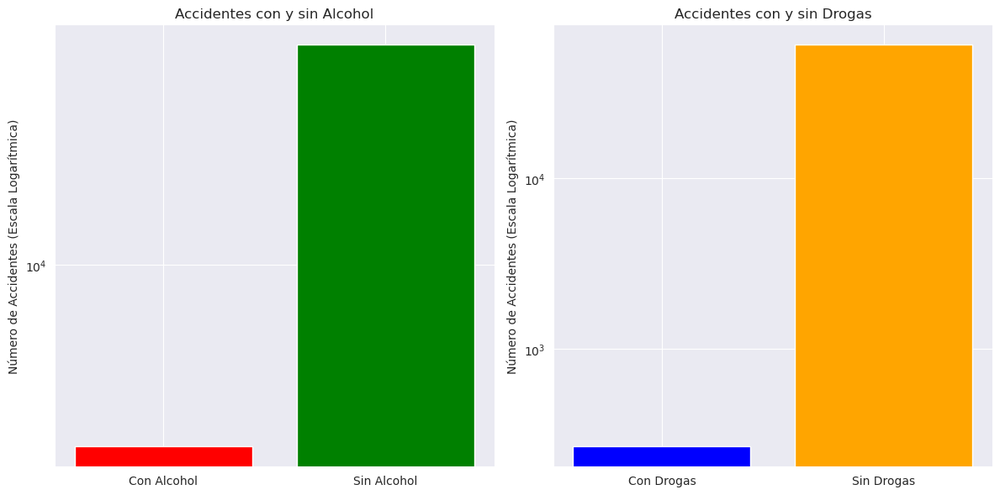

In [4]:
# Preparando los datos para las gráficas
categorias_alcohol = ['Con Alcohol', 'Sin Alcohol']
valores_alcohol = [accidentes_con_alcohol, accidentes_sin_alcohol]

categorias_drogas = ['Con Drogas', 'Sin Drogas']
valores_drogas = [accidentes_con_drogas, accidentes_sin_drogas]

# Creando las gráficas con escala logarítmica
plt.figure(figsize=(12, 6))

# Gráfica para alcohol
plt.subplot(1, 2, 1)
plt.bar(categorias_alcohol, valores_alcohol, color=['red', 'green'])
plt.yscale('log')
plt.title('Accidentes con y sin Alcohol')
plt.ylabel('Número de Accidentes (Escala Logarítmica)')

# Gráfica para drogas
plt.subplot(1, 2, 2)
plt.bar(categorias_drogas, valores_drogas, color=['blue', 'orange'])
plt.yscale('log')
plt.title('Accidentes con y sin Drogas')
plt.ylabel('Número de Accidentes (Escala Logarítmica)')

# Mostrando las gráficas
plt.tight_layout()
plt.show()


Cargamos datacombinada viejo para deshacer los cambios en el código de tipo de vehículo

In [5]:
df_legacy = pd.read_csv('Datasets/Data_Combinada.csv', low_memory=False)
unique_values = df_legacy['tipo_vehiculo'].unique()
dictionary = {code: type_of for code, type_of in enumerate(unique_values)}

df_descr_1['tipo_vehiculo'] = df_descr_1['tipo_vehiculo'].map(dictionary)

In [6]:
dictionary

{0: 'Turismo',
 1: 'Motocicleta hasta 125cc',
 2: 'Motocicleta > 125cc',
 3: 'Furgoneta',
 4: 'Camión rígido',
 5: 'Todo terreno',
 6: 'Bicicleta EPAC (pedaleo asistido)',
 7: 'VMU eléctrico',
 8: 'Maquinaria de obras',
 9: 'Ciclomotor',
 10: 'Autobús articulado',
 11: 'Vehículo articulado',
 12: nan,
 13: 'Otros vehículos con motor',
 14: 'Autocaravana',
 15: 'Autobús',
 16: 'Tractocamión',
 17: 'Bicicleta',
 18: 'Cuadriciclo ligero',
 19: 'Sin especificar',
 20: 'Autobús articulado EMT',
 21: 'Autobus EMT',
 22: 'Cuadriciclo no ligero',
 23: 'Camión de bomberos',
 24: 'Ambulancia SAMUR',
 25: 'Ciclo',
 26: 'Moto de tres ruedas > 125cc',
 27: 'Ciclomotor de dos ruedas L1e-B',
 28: 'Moto de tres ruedas hasta 125cc',
 29: 'Semiremolque',
 30: 'Patinete no eléctrico',
 31: 'Remolque',
 32: 'Otros vehículos sin motor',
 33: 'Microbús <= 17 plazas',
 34: 'Tren/metro'}

## Inicio del Análisis Descriptivo sobre el Dataset de Accidentalidad

In [81]:
df_descr_1 = pd.read_csv('./Datasets/Data_Combinada.v2')
df_descr_1.head()

,Unnamed: 0,num_implicados,minutes_from_midnight,cod_distrito,tipo_accidente,tipo_vehiculo,sexo,positiva_alcohol,positiva_droga,bool_laborable,marca_de_clase_edad,day,month,media_edad_pasajeros,numero_pasajeros
0,0,2,90,13.0,0,0,0,0.0,0.0,0,32.0,1,1,39.5,2
1,1,2,90,13.0,0,0,1,0.0,0.0,0,47.0,1,1,39.5,2
2,2,2,30,3.0,1,1,1,1.0,0.0,0,32.0,1,1,37.0,3
3,4,2,30,3.0,1,0,1,0.0,0.0,0,42.0,1,1,37.0,3
4,5,1,110,1.0,2,2,1,0.0,0.0,0,19.0,1,1,19.0,2


In [8]:
accidentes_por_tipo_vehiculo = df_descr_1['tipo_vehiculo'].value_counts()

df_accidentes_por_tipo_vehiculo = accidentes_por_tipo_vehiculo.reset_index()
df_accidentes_por_tipo_vehiculo.columns = ['Tipo de Vehículo', 'Número de Accidentes']

df_accidentes_por_tipo_vehiculo.sort_values(by='Número de Accidentes', inplace=True, ascending=False)

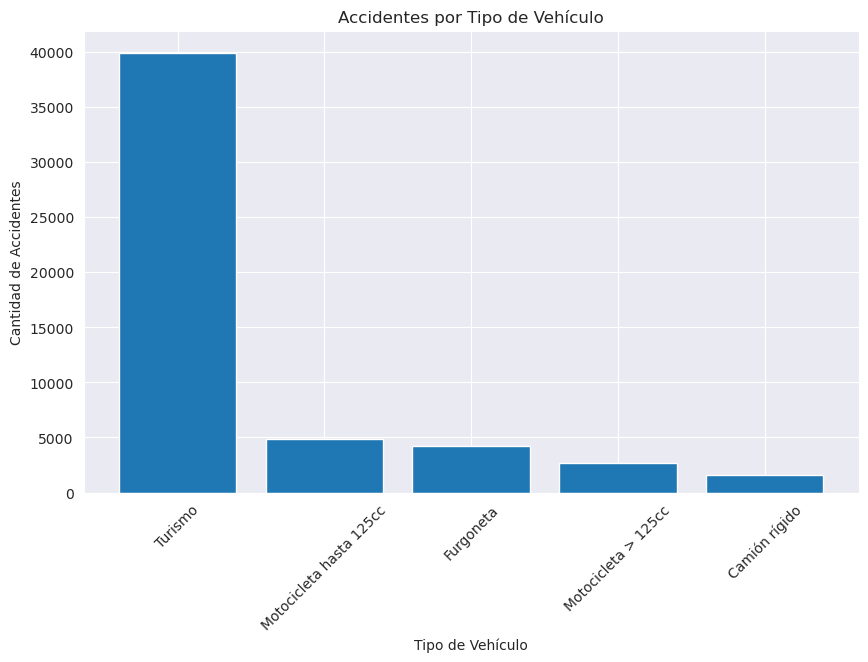

In [9]:
plt.figure(figsize=(10, 6))
plt.bar(df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'].head(),
        df_accidentes_por_tipo_vehiculo['Número de Accidentes'].head())
plt.xlabel('Tipo de Vehículo')
plt.ylabel('Cantidad de Accidentes')
plt.title('Accidentes por Tipo de Vehículo')
plt.xticks(rotation=45)
plt.show()

Por desgracia la DGT solo presentó los datos de los tipos de vehículos en un pdf y no en un csv, así que se introducirán a mano
Años Camiones y furgonetas Autobuses    Turismos Motocicletas Tractores industriales Otros vehículos * Total
2021        168.824         2.092       953.624     173.435     17.345               10.373            1.325.693

In [10]:
type_vehicles = {'Autobuses': 2092,
                 'Camiones y furgonetas': 168824,
                 'Turismos': 953624,
                 'Motocicletas': 173435,
                 'Tractores': 17345,
                 'Otros': 10373}
total_vehicles = 1325693

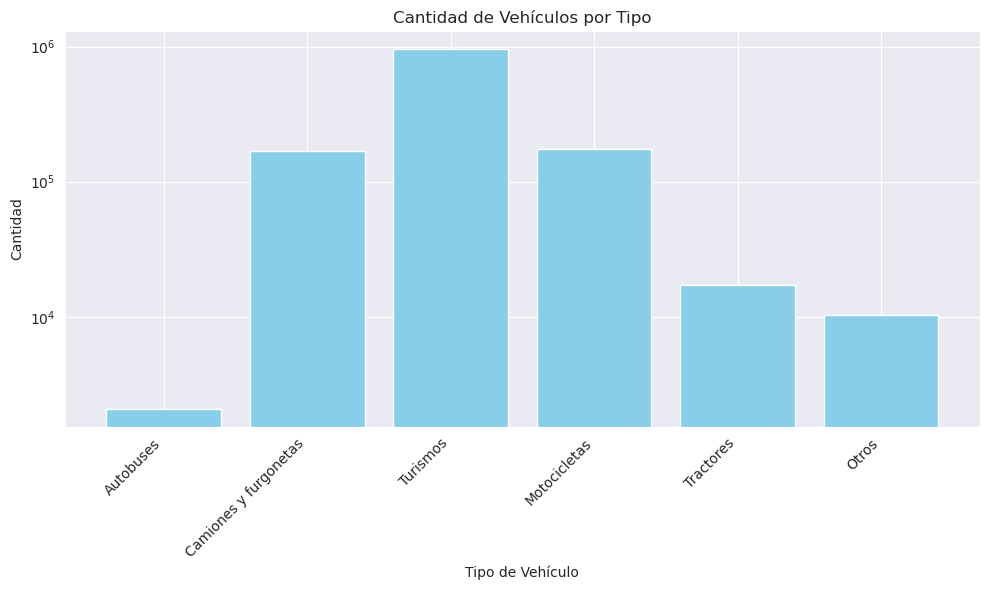

In [11]:
category = list(type_vehicles.keys())
valores = list(type_vehicles.values())

plt.figure(figsize=(10, 6))
plt.bar(category, valores, color='skyblue')
plt.xlabel('Tipo de Vehículo')
plt.ylabel('Cantidad')
plt.yscale('log')
plt.title('Cantidad de Vehículos por Tipo')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

In [36]:
df_accidentes_por_tipo_vehiculo['Tipo de Vehículo']

0                               Turismo
1               Motocicleta hasta 125cc
2                             Furgoneta
3                   Motocicleta > 125cc
4                         Camión rígido
5                               Autobús
6                             Bicicleta
7                         VMU eléctrico
8                            Ciclomotor
9                          Todo terreno
10                         Tractocamión
11    Bicicleta EPAC (pedaleo asistido)
12                  Maquinaria de obras
13            Otros vehículos con motor
14                  Vehículo articulado
15                      Sin especificar
16                   Autobús articulado
17                          Autobus EMT
18                   Cuadriciclo ligero
19                                Ciclo
20                Cuadriciclo no ligero
21                         Autocaravana
22                     Ambulancia SAMUR
23          Moto de tres ruedas > 125cc
24                Patinete no eléctrico


In [56]:
# Ratio calculation for 'Furgoneta' and 'Camión rígido'
df_accidentes_por_tipo_vehiculo['Ratio'] = np.where(
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Furgoneta') |
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Camión rígido'),
    df_accidentes_por_tipo_vehiculo['Número de Accidentes'] / type_vehicles['Camiones y furgonetas'],
    0
)# TODO fix this as this has to take into account the sum, not only some of them

# Adding Ratio for 'Turismo'
df_accidentes_por_tipo_vehiculo['Ratio'] += np.where(
    df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Turismo',
    df_accidentes_por_tipo_vehiculo['Número de Accidentes'] / type_vehicles['Turismos'],
    0
)

df_accidentes_por_tipo_vehiculo['Ratio'] += np.where(
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Autobús'),
    df_accidentes_por_tipo_vehiculo['Número de Accidentes'] / type_vehicles['Autobuses'],
    0
)

df_accidentes_por_tipo_vehiculo['Ratio'] += np.where(
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Motocicleta > 125cc') |
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Moto de tres ruedas > 125cc') |
    (df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Motocicleta hasta 125cc'),
    df_accidentes_por_tipo_vehiculo['Número de Accidentes'] / type_vehicles['Motocicletas'],
    0
)

df_accidentes_por_tipo_vehiculo['Ratio'] += np.where(
    ~df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'].isin(
        ['Furgoneta', 'Camión rígido', 'Turismo', 'Autobús', 'Motocicleta > 125cc', 'Moto de tres ruedas > 125cc',
         'Motocicleta hasta 125cc']),
    df_accidentes_por_tipo_vehiculo['Número de Accidentes'] / type_vehicles['Otros'],
    0
)

In [65]:
type_vehicles['Autobuses']

2092

In [64]:
df_accidentes_por_tipo_vehiculo[df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'] == 'Autobús']

,Tipo de Vehículo,Número de Accidentes,Ratio
5,Autobús,1317,0.629541


In [57]:
df_accidentes_por_tipo_vehiculo['Ratio']

0     0.041867
1     0.028247
2     0.024925
3     0.015579
4     0.009252
5     0.629541
6     0.104406
7     0.103152
8     0.092259
9     0.085992
10    0.029692
11    0.023715
12    0.022366
13    0.022173
14    0.012725
15    0.007712
16    0.006845
17    0.003856
18    0.003567
19    0.003085
20    0.001928
21    0.001832
22    0.000675
23    0.000040
24    0.000578
25    0.000578
26    0.000482
27    0.000482
28    0.000289
29    0.000193
30    0.000193
31    0.000096
32    0.000096
33    0.000096
Name: Ratio, dtype: float64

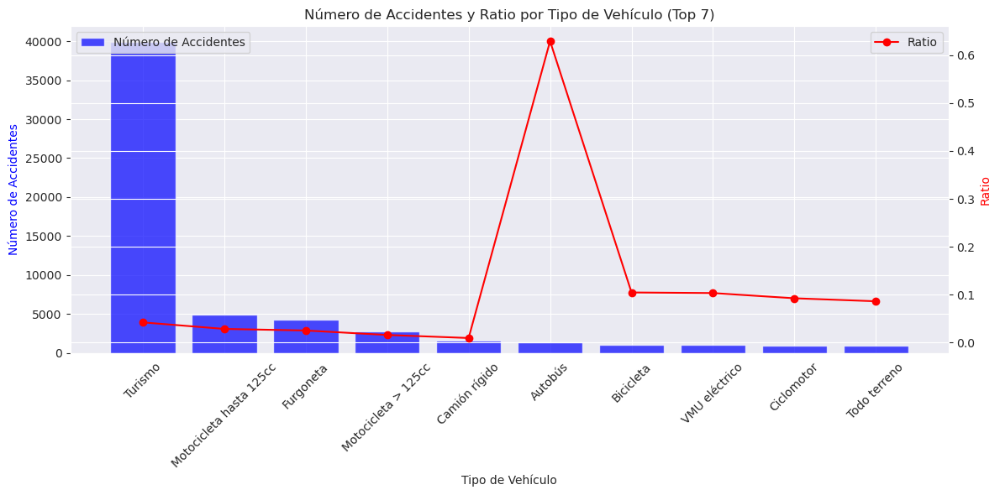

In [61]:
# Sort the DataFrame by 'Número de Accidentes' in descending order and select the top 7
top_10_accidents = df_accidentes_por_tipo_vehiculo.sort_values(by='Número de Accidentes', ascending=False).head(10)

# Extract data for the top 7 categories
ratio_data = top_10_accidents['Ratio']
vehicle_type_data = top_10_accidents['Tipo de Vehículo']
num_accidents_data = top_10_accidents['Número de Accidentes']

# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot the data for 'Número de Accidentes'
ax1.bar(vehicle_type_data, num_accidents_data, label='Número de Accidentes', color='blue', alpha=0.7)

# Set labels and legend for the first y-axis
ax1.set_xlabel('Tipo de Vehículo')
ax1.set_ylabel('Número de Accidentes', color='blue')
ax1.set_title('Número de Accidentes y Ratio por Tipo de Vehículo (Top 7)')
ax1.legend(loc='upper left')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Create a secondary y-axis for 'Ratio'
ax2 = ax1.twinx()
ax2.plot(vehicle_type_data, ratio_data, marker='o', color='red', label='Ratio', linestyle='-')

# Set labels and legend for the secondary y-axis
ax2.set_ylabel('Ratio', color='red')
ax2.legend(loc='upper right')

# Show the plot
plt.tight_layout()
plt.show()

                     Tipo de Vehículo  Número de Accidentes  \
0                             Turismo                 39925   
1             Motocicleta hasta 125cc                  4899   
2                           Furgoneta                  4208   
3                 Motocicleta > 125cc                  2702   
4                       Camión rígido                  1562   
5                             Autobús                  1317   
6                           Bicicleta                  1083   
7                       VMU eléctrico                  1070   
8                          Ciclomotor                   957   
9                        Todo terreno                   892   
10                       Tractocamión                   308   
11  Bicicleta EPAC (pedaleo asistido)                   246   
12                Maquinaria de obras                   232   
13          Otros vehículos con motor                   230   
14                Vehículo articulado                  

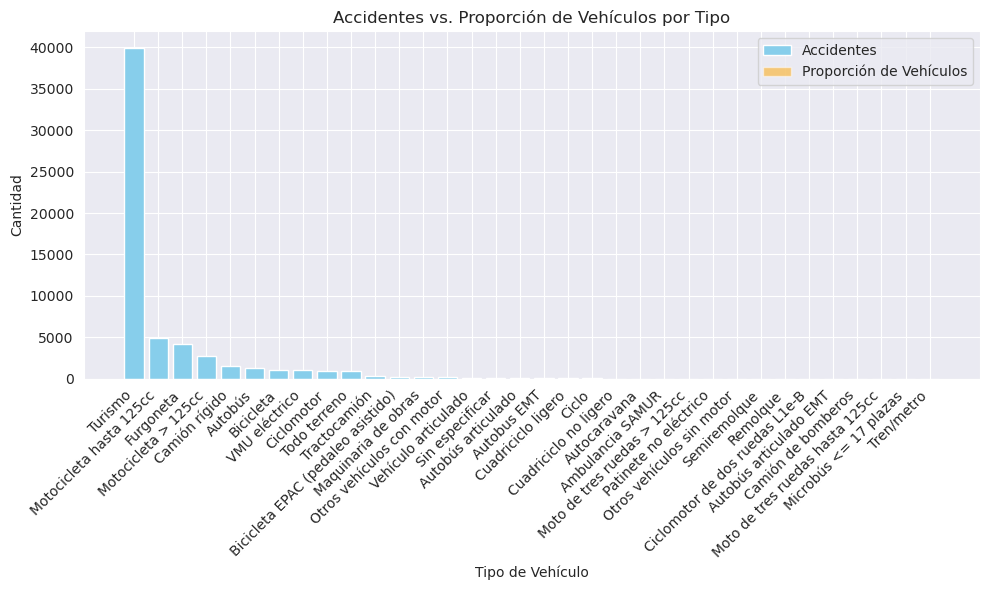

In [20]:
proporciones = {tipo: (cantidad / total_vehicles) for tipo, cantidad in type_vehicles.items()}

df_accidentes_por_tipo_vehiculo = accidentes_por_tipo_vehiculo.reset_index()
df_accidentes_por_tipo_vehiculo.columns = ['Tipo de Vehículo', 'Número de Accidentes']

df_accidentes_por_tipo_vehiculo.sort_values(by='Número de Accidentes', inplace=True, ascending=False)

df_accidentes_por_tipo_vehiculo['Proporción de Vehículos'] = df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'].map(
    proporciones)

print(df_accidentes_por_tipo_vehiculo)

plt.figure(figsize=(10, 6))
plt.bar(df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'], df_accidentes_por_tipo_vehiculo['Número de Accidentes'],
        color='skyblue', label='Accidentes')
plt.bar(df_accidentes_por_tipo_vehiculo['Tipo de Vehículo'],
        df_accidentes_por_tipo_vehiculo['Proporción de Vehículos'] * max(
            df_accidentes_por_tipo_vehiculo['Número de Accidentes']), color='orange', alpha=0.5,
        label='Proporción de Vehículos')
plt.xlabel('Tipo de Vehículo')
plt.ylabel('Cantidad')
plt.title('Accidentes vs. Proporción de Vehículos por Tipo')
plt.xticks(rotation=45, ha='right')
plt.legend()
plt.tight_layout()

plt.show()

In [89]:
df_accidentes_por_sexo = df_descr_1['sexo'].value_counts()
df_accidentes_por_sexo

sexo
1    45752
0    14741
Name: count, dtype: int64

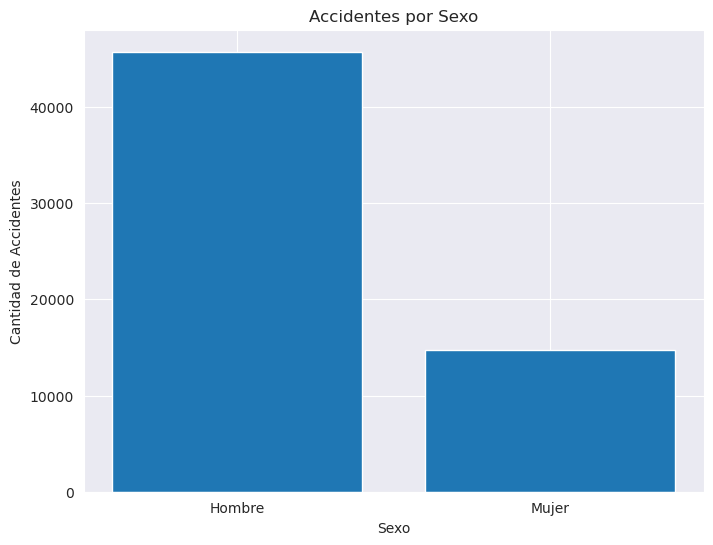

In [90]:
plt.figure(figsize=(8, 6))
plt.bar(['Hombre', 'Mujer'], df_accidentes_por_sexo)
plt.xlabel('Sexo')
plt.ylabel('Cantidad de Accidentes')
plt.title('Accidentes por Sexo')
plt.show()


In [97]:
contingencia_alcohol = pd.crosstab(df_descr_1['sexo'], df_descr_1['positiva_alcohol'], dropna=False)
contingencia_alcohol.rename({0: 'Mujer', 1: 'Hombre'}, inplace=True)

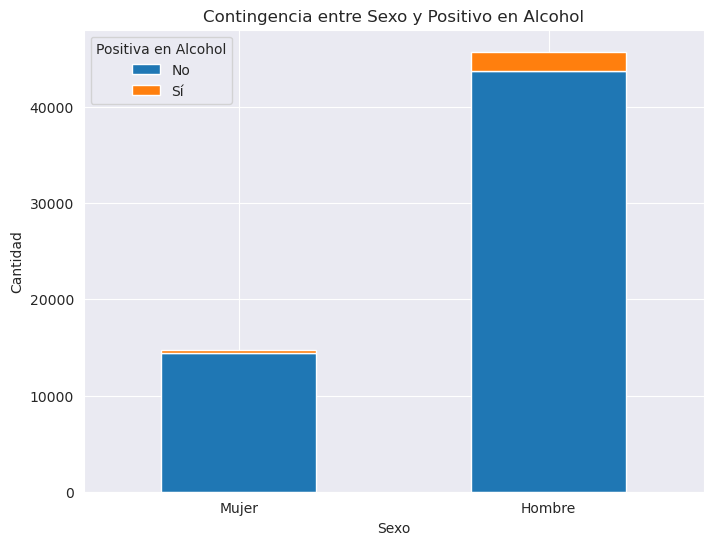

In [101]:
contingencia_alcohol.plot(kind='bar', stacked=True, figsize=(8, 6))
plt.xlabel('Sexo')
plt.xticks(rotation=0)
plt.ylabel('Cantidad')
plt.title('Contingencia entre Sexo y Positivo en Alcohol')
plt.legend(title='Positiva en Alcohol', labels=['No', 'Sí'])
plt.show()

Calculamos los porcentajes relativos tanto para hombre como para mujer

In [114]:
df_sexo_alcohol = df_descr_1.filter(items=['sexo', 'positiva_alcohol'])

In [147]:
numero_accidentes_sexo = np.array(df_sexo_alcohol.groupby(['sexo']).size())
positivos_accidentes_sexo = np.array(df_sexo_alcohol[df_sexo_alcohol['positiva_alcohol'] == 1].groupby(['sexo']).size())

In [148]:
numero_accidentes_sexo

array([14741, 45752])

In [149]:
positivos_accidentes_sexo / numero_accidentes_sexo

array([0.02218303, 0.04395436])

Por lo que concluimos que es el doble de probable que los implicados varones den positivo alcohol que las implicadas mujeres

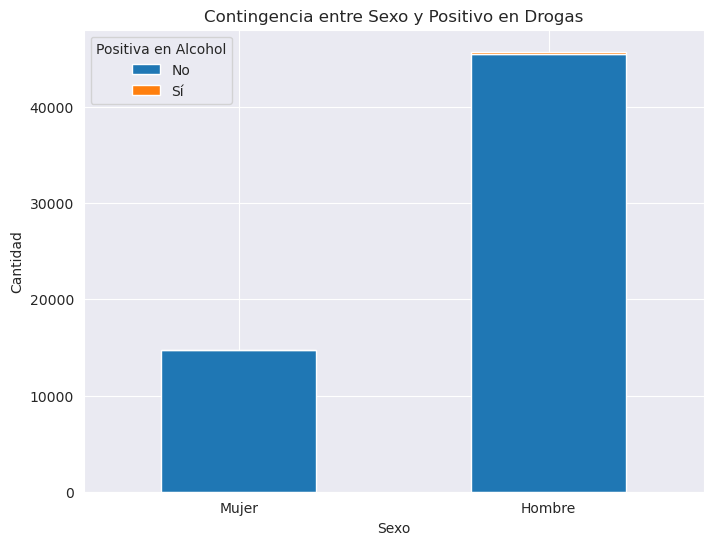

In [21]:
contingencia_alcohol = pd.crosstab(df_descr_1['sexo'], df_descr_1['positiva_droga'], dropna=False)
contingencia_alcohol.rename({0: 'Mujer', 1: 'Hombre'}, inplace=True)

contingencia_alcohol.plot(kind='bar', stacked=True, figsize=(8, 6))
plt.xlabel('Sexo')
plt.xticks(rotation=0)
plt.ylabel('Cantidad')
plt.title('Contingencia entre Sexo y Positivo en Drogas')
plt.legend(title='Positiva en Alcohol', labels=['No', 'Sí'])
plt.show()

In [152]:
df_sexo_drogas = df_descr_1.filter(items=['sexo', 'positiva_droga'])
numero_accidentes_sexo = np.array(df_sexo_drogas.groupby(['sexo']).size())
positivos_accidentes_sexo = np.array(df_sexo_drogas[df_sexo_drogas['positiva_droga'] == 1].groupby(['sexo']).size())

positivos_accidentes_sexo / numero_accidentes_sexo

array([0.00156027, 0.00535496])

In [35]:
df_laborable_alcohol = df_descr_1.filter(items=['bool_laborable', 'positiva_alcohol'])
df_laborable_alcohol[df_laborable_alcohol['positiva_alcohol'] == 1].groupby(
    ['positiva_alcohol', 'bool_laborable']).size()

positiva_alcohol  bool_laborable
1.0               0                 1173
                  1                 1165
dtype: int64

In [36]:
df_laborable_drogas = df_descr_1.filter(items=['bool_laborable', 'positiva_droga'])
df_laborable_drogas[df_laborable_drogas['positiva_droga'] == 1].groupby(['positiva_droga', 'bool_laborable']).size()

positiva_droga  bool_laborable
1.0             0                  82
                1                 186
dtype: int64

In [43]:
positivos_accidentes_laborable = np.array(df_laborable_alcohol[df_laborable_alcohol['positiva_alcohol'] == 1].groupby(
    ['positiva_alcohol', 'bool_laborable']).size())
proportion = np.array((2, 5))

positivos_accidentes_laborable / proportion

array([586.5, 233. ])

In [47]:
positivos_accidentes_laborable = np.array(df_laborable_drogas[df_laborable_drogas['positiva_droga'] == 1].groupby(
    ['positiva_droga', 'bool_laborable']).size())
proportion = np.array((2, 5))

positivos_accidentes_laborable / proportion

array([41. , 37.2])

Luego de la limpieza de datos se hace un analisis exploratorio sobre los dataframes recurriendo a herramientas estadísticas y de visualización y combinando dichas herramientas comenzaremos a extraer información adicional que pueda dar respuesta a nuestro problema.

## Relación Fecha - Número de accidentes

Verificamos si existen fechas puntuales en las que existan mas ocurrencias de accidentes para poder preveer los mismos encontrando soluciones a futuro

In [5]:
combined_data_decr2 = pd.read_csv('./Datasets/Data_Combinada.csv')
combined_data_decr2.head()

C:\Users\Usuario\AppData\Local\Temp\ipykernel_13564\3900743548.py:1: DtypeWarning: Columns (15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  combined_data_decr2 = pd.read_csv('./Datasets/Data_Combinada.csv')


,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,H,NaN,NaN,"441155,351","4474129,588",1.0,0.0,3,No
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,M,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,H,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No


### Creamos un gráfico de la distribución de accidentes por distrito

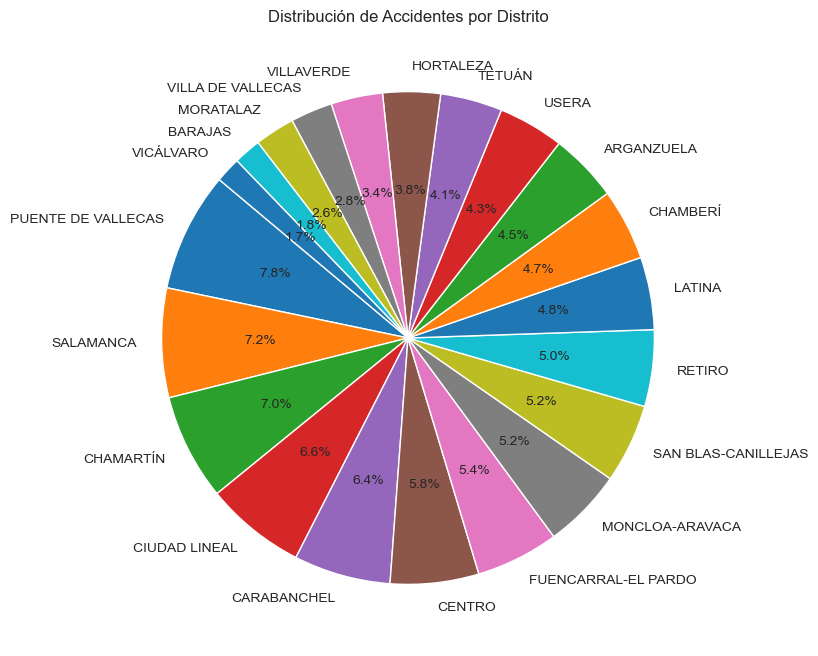

In [6]:
# Creando un gráfico de pastel para mostrar la distribución de accidentes por distrito
distrito_counts = combined_data_decr2['distrito'].value_counts()

plt.figure(figsize=(12, 8))
distrito_counts.plot(kind='pie', autopct='%1.1f%%', startangle=140)
plt.title('Distribución de Accidentes por Distrito')
plt.ylabel('')  # Eliminando la etiqueta del eje y
plt.show()


In [7]:
#Crear el df date_ocurrency para saber las ocurrencias por fecha
date_ocurrency = combined_data_decr2.groupby('fecha').size().reset_index(name='ocurrencia')
date_ocurrency.sort_values(by='ocurrencia', ascending=False, inplace = True)
date_ocurrency.head()

,fecha,ocurrencia
358,18/11/2022,207
319,16/12/2022,207
142,08/02/2022,206
25,02/03/2023,205
465,24/03/2023,202


Creamos un gráfico de lineas de las ocurrencias agrupadas por mes del año para facilitar la visualizacion de los datos y sacar conclusiones a traves de este

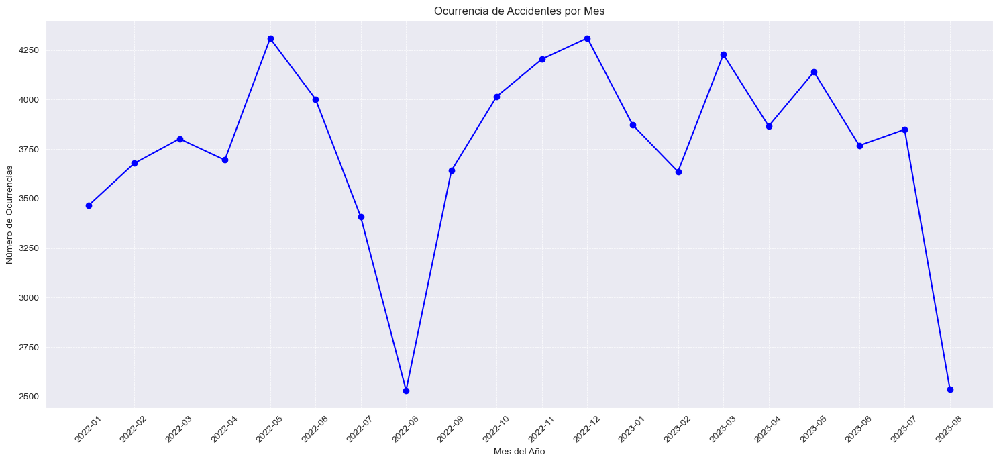

In [8]:
# Ordenar el DataFrame por fecha de forma ascendente
date_ocurrency['fecha'] = pd.to_datetime(date_ocurrency['fecha'], format='%d/%m/%Y')
date_ocurrency.sort_values(by='fecha', ascending=True, inplace=True)

# Agrupar por meses del año
date_ocurrency['year_month'] = date_ocurrency['fecha'].dt.strftime('%Y-%m')
monthly_ocurrency = date_ocurrency.groupby('year_month').sum()['ocurrencia'].reset_index()

# Generar el gráfico de líneas agrupado por meses
plt.figure(figsize=(15, 7))
plt.plot(monthly_ocurrency['year_month'], monthly_ocurrency['ocurrencia'], marker='o', linestyle='-', color='b')
plt.title('Ocurrencia de Accidentes por Mes')
plt.xlabel('Mes del Año')
plt.ylabel('Número de Ocurrencias')
plt.xticks(rotation=45)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()

El gráfico muestra una fluctuación en la ocurrencia de accidentes mes a mes, con ciertos periodos evidenciando picos elevados. Esta variabilidad puede estar influenciada por una serie de factores, como condiciones climáticas, festividades, o eventos locales. Distinguir los meses con alta ocurrencia de accidentes es crucial para tomar medidas preventivas y mejorar la seguridad vial.

Entender las tendencias y patrones en este gráfico nos va a permitir anticipar y prepararnos mejor para futuros escenarios. Al cruzar estos datos con otros factores relevantes, se podrían identificar causas específicas detrás de los incrementos y descensos en las ocurrencias y, por lo tanto, desarrollar soluciones más efectivas.

### Accidentes por mes sobrepuesto
Para obtener una mejor visualización sobreponemos los datos de ambos años para observar si los mismos han fluctuado

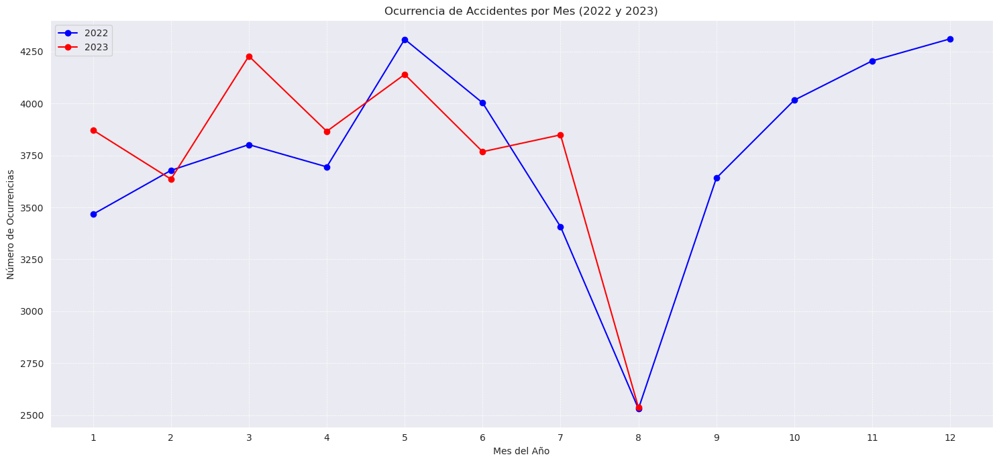

In [13]:
# Convertir la columna 'fecha' al formato de fecha y extraer el año y el mes
combined_data_decr2['fecha'] = pd.to_datetime(combined_data_decr2['fecha'], format='%d/%m/%Y')
combined_data_decr2['year'] = combined_data_decr2['fecha'].dt.year
combined_data_decr2['month'] = combined_data_decr2['fecha'].dt.month
# Agrupar los datos por año y mes, contando las ocurrencias
monthly_ocurrency = combined_data_decr2.groupby(['year', 'month']).size().reset_index(name='ocurrencia')

# Separar los datos por año para el gráfico
ocurrency_2022 = monthly_ocurrency[monthly_ocurrency['year'] == 2022]
ocurrency_2023 = monthly_ocurrency[monthly_ocurrency['year'] == 2023]

# Generar el gráfico de líneas
plt.figure(figsize=(15, 7))
plt.plot(ocurrency_2022['month'], ocurrency_2022['ocurrencia'], marker='o', linestyle='-', color='b', label='2022')
plt.plot(ocurrency_2023['month'], ocurrency_2023['ocurrencia'], marker='o', linestyle='-', color='r', label='2023')
plt.title('Ocurrencia de Accidentes por Mes (2022 y 2023)')
plt.xlabel('Mes del Año')
plt.ylabel('Número de Ocurrencias')
plt.xticks(range(1, 13))  # Asegurar que se muestran todos los meses
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.legend()
plt.tight_layout()
plt.show()

## Siguiendo con el análisis exploratorio contamos por distrito la cantidad de ocurrencias por mes y año

In [14]:
# Extrayendo año y mes de la columna 'fecha' y creando una nueva columna 'year_month' sin modificar el dataframe original
year_month = pd.to_datetime(combined_data_decr2['fecha'], dayfirst=True).dt.to_period('M')

# Agrupando por 'year_month' y 'distrito' para contar las ocurrencias
grouped_data = combined_data_decr2.groupby([year_month, 'distrito']).size().unstack().fillna(0)

grouped_data.head()

distrito,ARGANZUELA,BARAJAS,CARABANCHEL,CENTRO,CHAMARTÍN,CHAMBERÍ,CIUDAD LINEAL,FUENCARRAL-EL PARDO,HORTALEZA,LATINA,...,MORATALAZ,PUENTE DE VALLECAS,RETIRO,SALAMANCA,SAN BLAS-CANILLEJAS,TETUÁN,USERA,VICÁLVARO,VILLA DE VALLECAS,VILLAVERDE
fecha,,,,,,,,,,,,,,,,,,,,,
2022-01,128,65,212,151,203,178,234,186,144,181,...,85,303,151,299,198,143,184,54,61,137
2022-02,149,64,213,194,246,171,228,211,173,214,...,95,270,159,236,161,183,172,78,90,119
2022-03,200,60,236,201,266,178,259,213,136,164,...,97,294,170,299,224,146,164,55,101,123
2022-04,161,60,244,231,335,186,238,173,129,191,...,83,294,176,220,170,180,126,62,87,101
2022-05,186,83,218,221,391,246,295,225,180,201,...,125,344,188,312,240,148,176,65,111,120


Ahora que hemos agrupado los datos por year_month y distrito y contado las ocurrencias, podemos proceder a crear un gráfico de barras sobrepuestas que muestra la distribución de ocurrencias por distrito a lo largo de los meses por año y visualizar si existe alg.

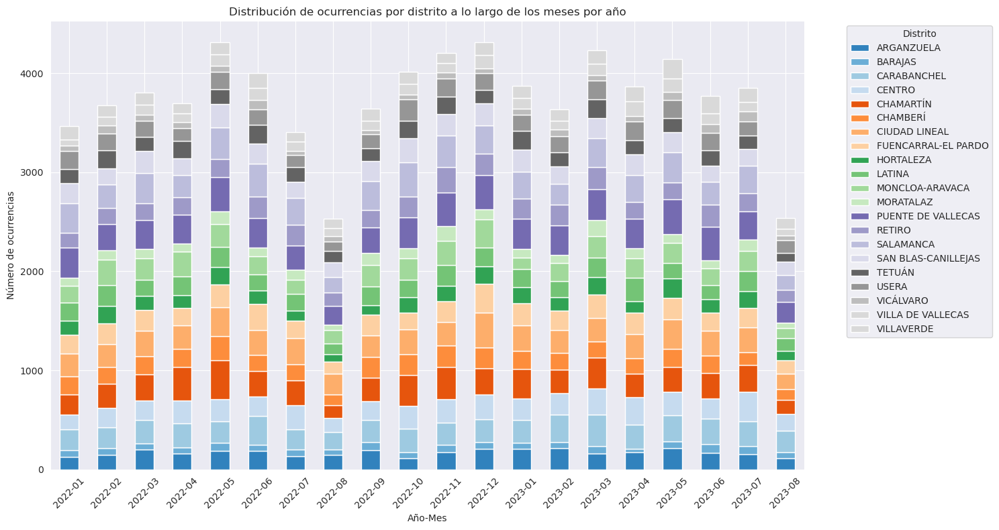

In [15]:
# Creando el gráfico de barras sobrepuestas
fig, ax = plt.subplots(figsize=(15, 8))


grouped_data.plot(kind='bar', stacked=True, ax=ax, colormap='tab20c')
plt.title('Distribución de ocurrencias por distrito a lo largo de los meses por año')
plt.ylabel('Número de ocurrencias')
plt.xlabel('Año-Mes')
plt.legend(title='Distrito', bbox_to_anchor=(1.05, 1), loc='upper left')

# Rotando las etiquetas del eje x para mejorar la legibilidad
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

## Análisis del Gráfico de Barras por Distrito
* **Distribución de Ocurrencias**: Algunos distritos presentan una mayor cantidad de ocurrencias que otros. Esto podría indicar áreas con mayor tráfico vehicular o puntos críticos que requieren atención.
* **Variabilidad Temporal**: Existen variaciones mensuales en las ocurrencias por distrito que podrían estar influenciadas por factores estacionales como condiciones meteorológicas, períodos vacacionales, o eventos locales.
* **Picos y Valles**: Los picos específicos en ciertos distritos pueden sugerir eventos o cambios temporales en el tráfico, como obras en carreteras, mientras que los valles podrían indicar períodos de menor actividad, como pueden ser las restricciones de tráfico.

## Conclusión General Ocurrencias
Los dos gráficos proporcionan perspectivas valiosas sobre las ocurrencias de accidentes. El gráfico de líneas es útil para comprender la tendencia general y los patrones estacionales de los accidentes a nivel de toda la ciudad. En cambio, el gráfico de barras sobrepuestas destaca las diferencias entre los distritos y puede ser clave para las intervenciones y políticas locales más dirigidas. La combinación de ambos enfoques puede ayudar a las autoridades a diseñar estrategias de prevención de accidentes más efectivas, dirigidas tanto a áreas específicas como a la ciudad en general.

# Verificamos si afecta el numero de pasajeros en un choque
### De esta manera sabremos si podemos quitarnos los datos de los pasajeros

1. fusionar nuestra serie pasajeros_por_accidente con el DataFrame combined_data para tener el número de pasajeros junto con los demás datos

In [16]:
# Explorar la relación entre el número de pasajeros y el tipo de accidente
relacion_pasajeros_tipo = combined_data_decr2.groupby(['tipo_accidente', 'numero_pasajeros']).size().unstack().fillna(0)

# Mostrar la relación
relacion_pasajeros_tipo

numero_pasajeros,1,2,3,4,5,6,7,8,9,10,11,14,15,17,21
tipo_accidente,,,,,,,,,,,,,,,
Alcance,113.0,8692.0,4449.0,2332.0,1285.0,438.0,287.0,56.0,27.0,10.0,0.0,0.0,0.0,0.0,0.0
Atropello a animal,111.0,30.0,15.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Atropello a persona,0.0,3636.0,1194.0,284.0,100.0,18.0,14.0,8.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0
Caída,2179.0,1566.0,426.0,116.0,45.0,36.0,35.0,0.0,9.0,10.0,11.0,0.0,0.0,0.0,0.0
Choque contra obstáculo fijo,2549.0,3862.0,1227.0,400.0,130.0,60.0,7.0,0.0,0.0,10.0,0.0,0.0,0.0,0.0,0.0
Colisión frontal,23.0,1022.0,471.0,240.0,95.0,54.0,21.0,16.0,0.0,0.0,11.0,0.0,0.0,0.0,0.0
Colisión fronto-lateral,154.0,10180.0,4887.0,2392.0,955.0,504.0,147.0,56.0,27.0,20.0,11.0,14.0,0.0,17.0,21.0
Colisión lateral,94.0,7302.0,2511.0,940.0,355.0,132.0,77.0,24.0,9.0,10.0,0.0,0.0,0.0,0.0,0.0
Colisión múltiple,39.0,370.0,1449.0,1136.0,725.0,348.0,224.0,136.0,72.0,50.0,11.0,0.0,0.0,0.0,0.0


Observamos que no tiene mucha relacion el tipo de accidente con el numero de pasajeros, más que la mayoría de los accidentes involucran vehículos sin pasajeros o con un número limitado de pasajeros.

## Verificamos con la gravedad del accidente (lesividad)

1. Calculamos la proporción de accidentes con distintos niveles de lesividad en función del número de pasajeros

In [17]:
proporcion_lesividad = combined_data_decr2.groupby(['numero_pasajeros', 'lesividad']).size().unstack().fillna(0)
proporcion_lesividad = proporcion_lesividad.div(proporcion_lesividad.sum(axis=1), axis=0)  # Convertir a proporciones

# Visualizar las proporciones
proporcion_lesividad

lesividad,Asistencia sanitaria ambulatoria con posterioridad,Asistencia sanitaria inmediata en centro de salud o mutua,Asistencia sanitaria sólo en el lugar del accidente,Atención en urgencias sin posterior ingreso,Fallecido 24 horas,Ingreso inferior o igual a 24 horas,Ingreso superior a 24 horas,Se desconoce,Sin asistencia sanitaria
numero_pasajeros,,,,,,,,,
1,0.052505,0.108442,0.326356,0.149279,0.003432,0.159574,0.033631,0.000000,0.166781
2,0.022369,0.046313,0.242860,0.058530,0.000706,0.076556,0.025138,0.000054,0.527473
3,0.018502,0.031819,0.223442,0.044729,0.000407,0.063841,0.019518,0.000102,0.597642
4,0.018773,0.027453,0.214372,0.038151,0.001009,0.056318,0.014736,0.000000,0.629189
5,0.016142,0.021937,0.237583,0.028974,0.002070,0.054222,0.010762,0.000414,0.627897
6,0.014783,0.024348,0.222609,0.040870,0.000000,0.049565,0.003478,0.000000,0.644348
7,0.013180,0.014827,0.250412,0.041186,0.001647,0.037891,0.004942,0.000000,0.635914
8,0.008264,0.012397,0.177686,0.033058,0.000000,0.041322,0.004132,0.000000,0.723140
9,0.033898,0.000000,0.279661,0.016949,0.000000,0.025424,0.033898,0.000000,0.610169


Observamos que en accidentes sin pasajeros o con un número limitado de pasajeros, la proporción de accidentes donde no se requiere asistencia sanitaria (columna "Sin asistencia sanitaria") tiende a ser más alta.

2. Para obtener una imagen más clara, podemos visualizar estos datos. Un gráfico de áreas apiladas será útil para visualizar la distribución de niveles de lesividad en función del número de pasajeros.

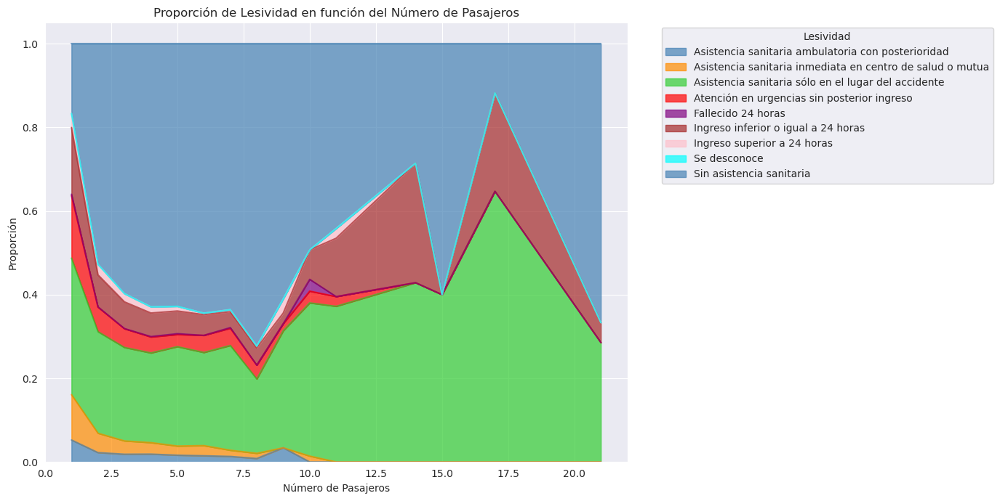

In [18]:
colors = ['steelblue', 'darkorange', 'limegreen', 'red', 'purple', 'brown', 'pink', 'cyan']

# Gráfico de barras apiladas
#proporcion_lesividad.plot(kind='bar', stacked=True, figsize=(14,7), color=colors)
#plt.title('Proporción de Lesividad en función del Número de Pasajeros')
#plt.xlabel('Número de Pasajeros')
#plt.ylabel('Proporción')
#plt.legend(title='Lesividad', bbox_to_anchor=(1.05, 1), loc='upper left')
#plt.tight_layout()
#plt.show()

# Gráfico de áreas apiladas
fig, ax = plt.subplots(figsize=(14,7))
proporcion_lesividad.plot(kind='area', stacked=True, ax=ax, color=colors, alpha=0.7)
ax.set_title('Proporción de Lesividad en función del Número de Pasajeros')
ax.set_xlabel('Número de Pasajeros')
ax.set_ylabel('Proporción')
ax.legend(title='Lesividad', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

### Del Gráfico podemos sacar varias conclusiones:
1. La mayoría de los accidentes, independientemente del número de pasajeros, caen en la categoría "Sin asistencia sanitaria", lo que indica que estos accidentes no resultaron en lesiones que requirieran atención médica.
2. Para accidentes con un número más alto de pasajeros (por ejemplo, 12, 14 y 18 pasajeros), aunque el tamaño de la muestra es pequeño, parece haber una proporción mayor de accidentes en la categoría "Sin asistencia sanitaria" en comparación con los accidentes con menos pasajeros.
3. Las proporciones de otras categorías de lesividad varían, pero no se observa un patrón claro en relación con el número de pasajeros.
En general, basándonos en este análisis visual, no parece que el número de pasajeros tenga una influencia fuerte y clara en la gravedad del accidente, al menos en términos de lesividad.

# Estudio de Momento del día y condición meteorológica
Analizamos cómo la combinación de estos dos factores influye en la frecuencia de los accidentes. Específicamente, buscamos determinar si ciertas condiciones meteorológicas, como días despejados o lluviosos, tenían diferentes impactos en la ocurrencia de accidentes durante distintos momentos del día (mañana, tarde, noche). Este análisis ayudaría a identificar patrones y posibles correlaciones entre el momento del día y las condiciones del clima

Identificamos y comprender las columnas 'hora' y el 'estado meteorológico'.

In [30]:
# Revisar los valores únicos en las columnas relevantes: 'hora' y 'estado_meteorológico'
unique_hours = combined_data_decr2['hora'].unique()
unique_weather_conditions = combined_data_decr2['estado_meteorológico'].unique()
unique_hours, unique_weather_conditions

(array(['1:30:00', '0:30:00', '1:50:00', ..., '4:34:00', '1:51:00',
        '7:04:00'], dtype=object),
 array(['Despejado', nan, 'Se desconoce', 'Lluvia débil', 'Nublado',
        'LLuvia intensa', 'Granizando', 'Nevando'], dtype=object))

In [31]:
# Función para categorizar la hora del día
def categorize_hour(time_str):
    if not pd.isnull(time_str):
        hour = int(time_str.split(':')[0])
        if 5 <= hour < 12:
            return 'Mañana'
        elif 12 <= hour < 18:
            return 'Tarde'
        else:
            return 'Noche'
    else:
        return 'Desconocido'

# Aplicar la función a la columna 'hora'
combined_data_decr2['categoria_hora'] = combined_data_decr2['hora'].apply(categorize_hour)

# Manejar los valores nulos y desconocidos en 'estado_meteorológico'
combined_data_decr2['estado_meteorológico'] = combined_data_decr2['estado_meteorológico'].fillna('Desconocido')

# Contar la frecuencia de accidentes por combinación de categoría de hora y estado meteorológico
accident_frequency = combined_data_decr2.groupby(['categoria_hora', 'estado_meteorológico']).size().unstack(fill_value=0)

accident_frequency

estado_meteorológico,Desconocido,Despejado,Granizando,LLuvia intensa,Lluvia débil,Nevando,Nublado,Se desconoce
categoria_hora,,,,,,,,
Mañana,1520,13572,0,198,938,3,1293,125
Noche,3723,22018,10,471,1953,1,1736,232
Tarde,2976,21080,3,288,1093,2,1624,102


Creamos una visualización gráfica para interpretar de manera más sencilla y efectiva los resultados del análisis de frecuencia.

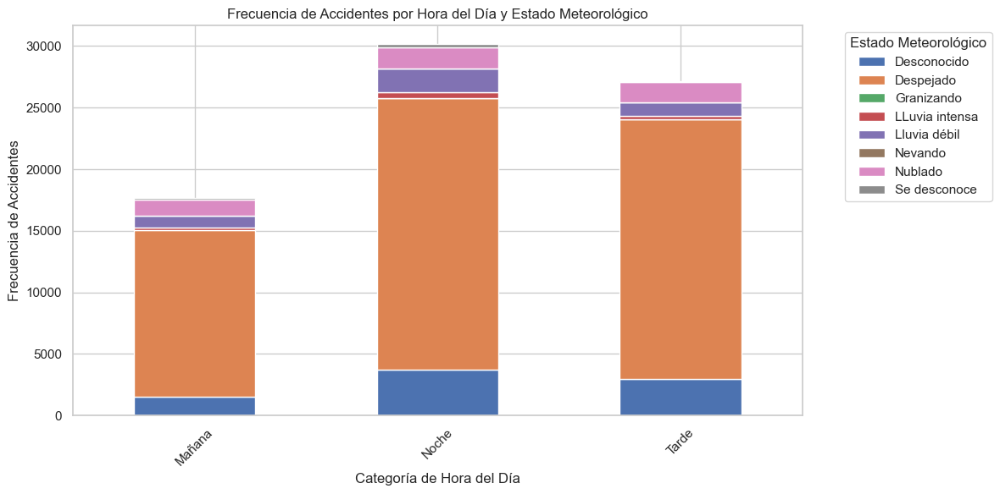

In [32]:
# Configuración de estilo de gráfico
sns.set(style="whitegrid")

# Crear un gráfico de barras apiladas
accident_frequency.plot(kind='bar', stacked=True, figsize=(12, 6))

# Título y etiquetas
plt.title('Frecuencia de Accidentes por Hora del Día y Estado Meteorológico')
plt.xlabel('Categoría de Hora del Día')
plt.ylabel('Frecuencia de Accidentes')
plt.xticks(rotation=45)
plt.legend(title='Estado Meteorológico', bbox_to_anchor=(1.05, 1), loc='upper left')

# Mostrar el gráfico
plt.tight_layout()
plt.show()


Al observar el gráfico de barras apiladas, concluimos que la mayoría de los accidentes ocurren durante la noche, especialmente en condiciones meteorológicas despejadas (debido a que mayor parte del tiempo está despejado, por lo que aumenta su frecuencia). También notamos un aumento significativo en la frecuencia de accidentes bajo lluvia débil durante las horas nocturnas. Esta tendencia sugiere que, aunque las condiciones despejadas son las más comunes para accidentes en todos los momentos del día, la lluvia débil parece ser un factor de riesgo particularmente importante durante la noche. Nuestro estudio resalta la importancia de considerar la interacción entre la hora del día y las condiciones meteorológicas al evaluar los riesgos de accidentes.

In [69]:
combined_data_decr2[combined_data_decr2['estado_meteorológico'] == 'Despejado'].count() / combined_data_decr2.count()

num_expediente          0.755993
fecha                   0.755993
hora                    0.755993
localizacion            0.755993
numero                  0.755990
cod_distrito            0.755993
distrito                0.755993
tipo_accidente          0.755993
estado_meteorológico    0.755993
tipo_vehiculo           0.756168
tipo_persona            0.755993
rango_edad              0.755993
sexo                    0.755993
cod_lesividad           0.836300
lesividad               0.836300
coordenada_x_utm        0.742179
coordenada_y_utm        0.742179
positiva_alcohol        0.755993
positiva_droga          0.755993
numero_pasajeros        0.755993
fugado                  0.755993
categoria_hora          0.755993
marca_clase_edad        0.761502
year                    0.755993
month                   0.755993
dtype: float64

In [70]:
combined_data_decr2[combined_data_decr2['estado_meteorológico'] == 'Nublado'].count() / combined_data_decr2.count()

num_expediente          0.062072
fecha                   0.062072
hora                    0.062072
localizacion            0.062072
numero                  0.062073
cod_distrito            0.062072
distrito                0.062072
tipo_accidente          0.062072
estado_meteorológico    0.062072
tipo_vehiculo           0.062151
tipo_persona            0.062072
rango_edad              0.062072
sexo                    0.062072
cod_lesividad           0.068271
lesividad               0.068271
coordenada_x_utm        0.068278
coordenada_y_utm        0.068278
positiva_alcohol        0.062072
positiva_droga          0.062072
numero_pasajeros        0.062072
fugado                  0.062072
categoria_hora          0.062072
marca_clase_edad        0.063053
year                    0.062072
month                   0.062072
dtype: float64

Podemos observar que el 75.59% de los días del año son despejados, comparado con los dias Nublados, siendo estos solo el 6% de los dias del año. Lo que justifica que haya mayor cantidad de accidentes en estos momentos

# Distribución de las edades de las personas involucradas en distintos tipos de accidentes.

1. Transformamos los rangos de edad en marcas de clase (valores numéricos medios) para permitir cálculos estadísticos.
2. Agrupar los datos por tipo de accidente y calcular los percentiles para entender la distribución de la edad dentro de cada categoría de accidente.

In [33]:
# Crear un diccionario para mapear los rangos de edad a marcas de clase (valor medio)
age_range_to_midpoint = {
    'Menor de 5 años': 2.5,
    'De 6 a 9 años': 7.5,
    'De 10 a 14 años': 12.5,
    'De 15 a 17 años': 16,
    'De 18 a 20 años': 19,
    'De 21 a 24 años': 22.5,
    'De 25 a 29 años': 27,
    'De 30 a 34 años': 32,
    'De 35 a 39 años': 37,
    'De 40 a 44 años': 42,
    'De 45 a 49 años': 47,
    'De 50 a 54 años': 52,
    'De 55 a 59 años': 57,
    'De 60 a 64 años': 62,
    'De 65 a 69 años': 67,
    'De 70 a 74 años': 72,
    'Más de 74 años': 77,
    'Desconocido': np.nan  # Asignar NaN para los rangos de edad desconocidos
}

# Convertir los rangos de edad a marcas de clase
combined_data_decr2['marca_clase_edad'] = combined_data_decr2['rango_edad'].map(age_range_to_midpoint)

# Agrupar los datos por tipo de accidente y calcular los percentiles de edad
percentiles_age_by_accident_type = combined_data_decr2.groupby('tipo_accidente')['marca_clase_edad'].describe(percentiles=[.25, .5, .75])

percentiles_age_by_accident_type

,count,mean,std,min,25%,50%,75%,max
tipo_accidente,,,,,,,,
Alcance,16894.0,40.588079,15.014567,2.5,27.0,42.0,52.0,77.0
Atropello a animal,152.0,43.881579,14.313743,2.5,32.0,42.0,52.0,77.0
Atropello a persona,4969.0,43.699034,19.378701,2.5,27.0,42.0,57.0,77.0
Caída,4298.0,38.496859,14.336758,2.5,27.0,37.0,47.0,77.0
Choque contra obstáculo fijo,5893.0,40.396233,15.324864,2.5,27.0,42.0,52.0,77.0
Colisión frontal,1790.0,40.871788,15.219538,2.5,27.0,42.0,52.0,77.0
Colisión fronto-lateral,18357.0,40.539140,15.404111,2.5,27.0,42.0,52.0,77.0
Colisión lateral,10482.0,42.643246,14.474836,2.5,32.0,42.0,52.0,77.0
Colisión múltiple,3965.0,41.477806,15.382169,2.5,32.0,42.0,52.0,77.0


Creamos una visualización gráfica para interpretar de manera clara y efectiva la distribución de edades por tipo de accidente.

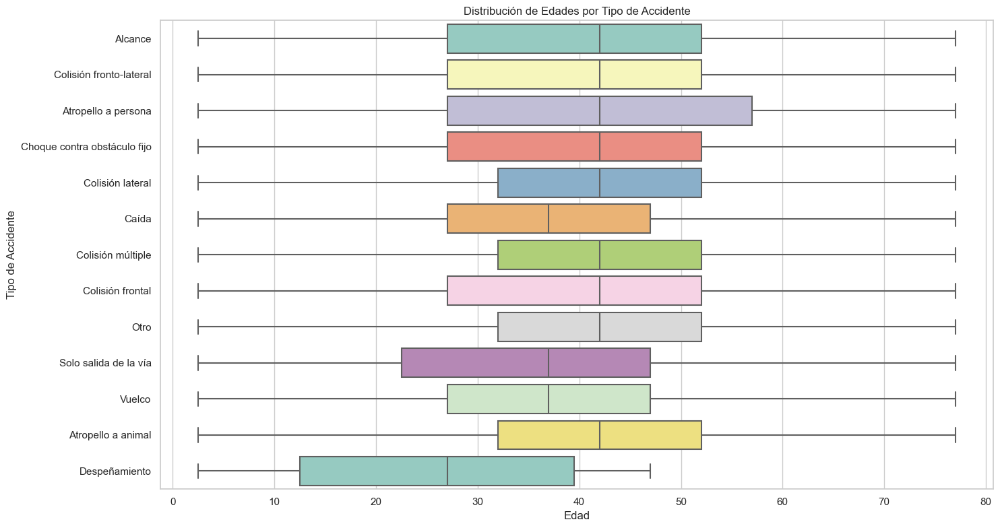

In [34]:
# Crear un gráfico de caja para visualizar la distribución de edades por tipo de accidente
plt.figure(figsize=(15, 8))
sns.boxplot(x='marca_clase_edad', y='tipo_accidente', data=combined_data_decr2, palette="Set3")

# Título y etiquetas
plt.title('Distribución de Edades por Tipo de Accidente')
plt.xlabel('Edad')
plt.ylabel('Tipo de Accidente')

# Mostrar el gráfico
plt.tight_layout()
plt.show()

El gráfico de caja que hemos creado revela diferencias significativas en la distribución de edades entre los distintos tipos de accidentes. Se observa que algunos tipos de accidentes, como los atropellos a personas, presentan una distribución de edades más amplia y una mediana más alta, lo que indica una mayor participación de individuos de edad avanzada en estos accidentes. Por otro lado, otros tipos de accidentes muestran una concentración más estrecha de edades, sugiriendo un grupo objetivo específico más susceptible

Del análisis de los datos de accidentes, centrado en la relación entre la edad de los individuos involucrados y los tipos de accidentes, se puede resumir en los siguientes puntos clave:

1. Diversidad en la Distribución de Edades: Observamos una variabilidad significativa en la distribución de edades entre los distintos tipos de accidentes. Esto indica que ciertos tipos de accidentes son más propensos a involucrar a grupos de edad específicos.

2. Mayor Involucramiento de Edades Avanzadas en Algunos Accidentes: En particular, tipos de accidentes como atropellos a personas mostraron una mayor participación de individuos de mayor edad, lo cual se evidenció por una mediana de edad más alta y un rango más amplio en la distribución de edades.

3. Concentración de Grupos de Edad en Accidentes Específicos: Algunos tipos de accidentes tenían una distribución de edades más concentrada, sugiriendo que ciertos grupos de edad son más susceptibles a estos accidentes específicos.

4. Importancia para la Prevención y Seguridad: Estos hallazgos son cruciales para diseñar estrategias de prevención y seguridad vial que sean específicas para diferentes grupos de edad, especialmente para aquellos más vulnerables a ciertos tipos de accidentes.

# Relación entre la ubicación de los accidentes (distritos específicos) y los tipos de accidentes que ocurren en esos lugares
Determinamos las categorías únicas existentes en las columnas 'distrito' y 'tipo_accidente' para comprender la variedad de datos con los que trabajaríamos.

In [35]:
# Revisar los valores únicos para las columnas 'distrito' y 'tipo_accidente'
unique_districts = combined_data_decr2['distrito'].unique()
unique_accident_types = combined_data_decr2['tipo_accidente'].unique()

unique_districts, unique_accident_types

(array(['PUENTE DE VALLECAS', 'RETIRO', 'CENTRO', 'SAN BLAS-CANILLEJAS',
        'USERA', 'CHAMBERÍ', 'MORATALAZ', 'LATINA', 'HORTALEZA',
        'ARGANZUELA', 'CARABANCHEL', 'TETUÁN', 'CIUDAD LINEAL',
        'VILLAVERDE', 'SALAMANCA', 'VICÁLVARO', 'FUENCARRAL-EL PARDO',
        'VILLA DE VALLECAS', 'CHAMARTÍN', 'MONCLOA-ARAVACA', 'BARAJAS'],
       dtype=object),
 array(['Alcance', 'Colisión fronto-lateral', 'Atropello a persona',
        'Choque contra obstáculo fijo', 'Colisión lateral', 'Caída',
        'Colisión múltiple', 'Colisión frontal', 'Otro',
        'Solo salida de la vía', 'Vuelco', 'Atropello a animal',
        'Despeñamiento'], dtype=object))

Normalizamos los datos para que las diferencias en el número total de accidentes por distrito no afecten el análisis y visualizar la relación mediante un mapa de calor.

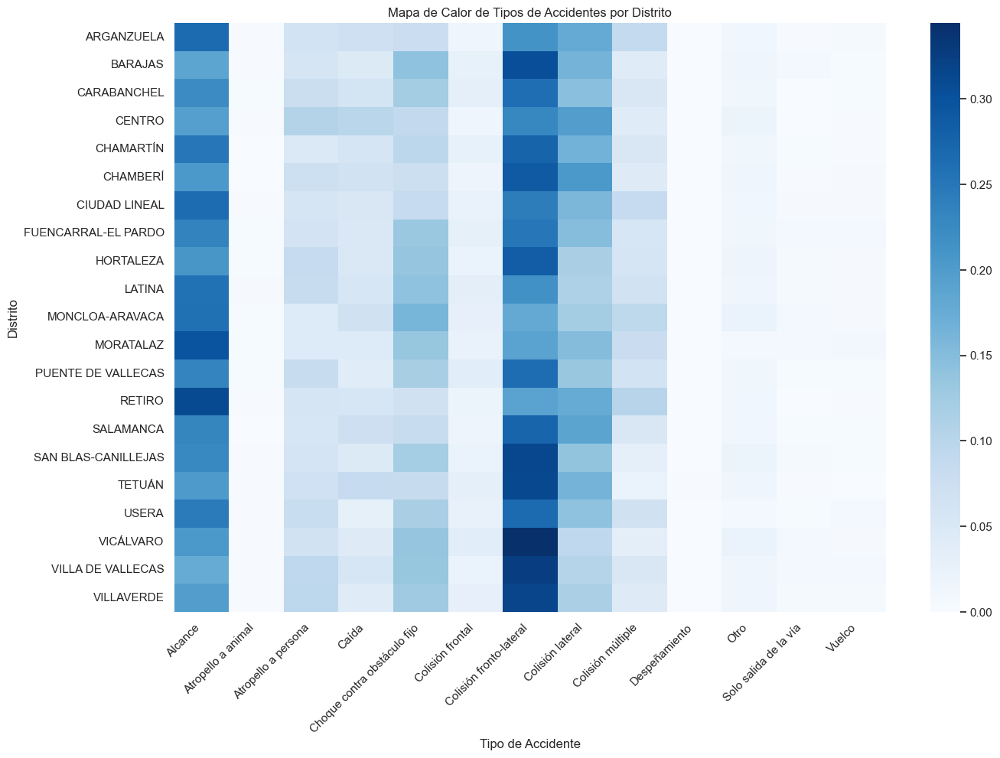

In [36]:
# Crear una tabla cruzada (crosstab) para contar la frecuencia de tipos de accidente por distrito
accident_type_by_district = pd.crosstab(combined_data_decr2['distrito'], combined_data_decr2['tipo_accidente'])

# Normalizar los datos para que las diferencias en el número total de accidentes por distrito no sesguen los resultados
accident_type_by_district_normalized = accident_type_by_district.div(accident_type_by_district.sum(axis=1), axis=0)

# Crear el mapa de calor con una paleta de colores adecuada para ambos modos (oscuro y claro)
plt.figure(figsize=(15, 10))
sns.heatmap(accident_type_by_district_normalized, annot=False, cmap='Blues')

# Título y etiquetas
plt.title('Mapa de Calor de Tipos de Accidentes por Distrito')
plt.xlabel('Tipo de Accidente')
plt.ylabel('Distrito')

# Mostrar el gráfico
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.show()

El mapa de calor que hemos creado muestra la frecuencia relativa de diferentes tipos de accidentes en cada distrito. A través de los gradientes de color, podemos observar patrones interesantes:

* **Patrones de Frecuencia**: Algunos distritos presentan una mayor frecuencia de ciertos tipos de accidentes en comparación con otros. Por ejemplo, un distrito puede mostrar una mayor incidencia de "Alcances" o "Colisiones laterales" en comparación con otros tipos de accidentes.

* **Distribución Geográfica**: La distribución de los tipos de accidentes no es uniforme a través de los distritos, indicando posibles factores geográficos o urbanísticos que influyen en el tipo de accidentes más comunes en cada área.

* **Detección de Hotspots**: El mapa ayuda a identificar 'hotspots' o áreas donde ciertos tipos de accidentes son particularmente frecuentes. Estos puntos calientes podrían requerir atención especial en términos de seguridad vial o medidas preventivas.

Este tipo de visualización es útil para una variedad de aplicaciones, especialmente en la planificación urbana, la gestión de la seguridad vial y en la toma de decisiones políticas:

* **Planificación Urbana y Mejoras en la Infraestructura**: Identificar áreas con alta incidencia de ciertos tipos de accidentes puede indicar la necesidad de mejoras en la infraestructura, como señalización mejorada, cambios en el diseño de las carreteras, o la implementación de medidas de calmado de tráfico.

* **Enfoque en la Seguridad Vial**: Permite a las autoridades locales y a las organizaciones de seguridad vial centrarse en áreas y tipos de accidentes específicos para campañas de concienciación y educación.

* **Asignación de Recursos**: Ayuda a los servicios de emergencia y a los planificadores urbanos a asignar recursos y servicios de manera más eficiente, concentrándose en las áreas con mayor frecuencia de tipos específicos de accidentes.

### Mapa de accidentes por distrito
Para facilitar la visualización y distribución de accidentes en Madrid, creamos un mapa de los accidentes señalado por distritos

Las columnas de coordenadas coordenada_x_utm y coordenada_y_utm están presentes en todos los registros, pero están en formato de objeto (probablemente debido a la presencia de comas como separadores decimales). Necesitamos convertir estas columnas a un formato numérico adecuado para poder utilizarlas en un mapa.

Realizamos la conversión de estas coordenadas y luego procederemos a crear un mapa que muestre los accidentes por distrito.

In [38]:
coord_columns_info = combined_data_decr2[['coordenada_x_utm', 'coordenada_y_utm']].info()

# Displaying the first few non-null coordinate values to understand their format
sample_coords = combined_data_decr2.dropna(subset=['coordenada_x_utm', 'coordenada_y_utm']).head()[['coordenada_x_utm', 'coordenada_y_utm']]
sample_coords

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74961 entries, 0 to 74960
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   coordenada_x_utm  74961 non-null  object
 1   coordenada_y_utm  74961 non-null  object
dtypes: object(2)
memory usage: 1.1+ MB


,coordenada_x_utm,coordenada_y_utm
0,"443359,226","4472082,272"
1,"443359,226","4472082,272"
2,"441155,351","4474129,588"
3,"441155,351","4474129,588"
4,"441155,351","4474129,588"


In [40]:
combined_data_decr2['coordenada_x_utm'] = pd.to_numeric(combined_data_decr2['coordenada_x_utm'].str.replace(',', '.'))
combined_data_decr2['coordenada_y_utm'] = pd.to_numeric(combined_data_decr2['coordenada_y_utm'].str.replace(',', '.'))

# Check
combined_data_decr2[['coordenada_x_utm', 'coordenada_y_utm']].info()


ValueError: Unable to parse string "#¡VALOR!" at position 757

Parece que hay un problema con la conversión de las coordenadas a formato numérico. Algunas entradas en las columnas de coordenadas contienen valores no numéricos, como "#¡VALOR!", lo que está causando un error.
Limpiamos los datos eliminando o reemplazando estos valores no numéricos. Luego intentaré nuevamente convertir las coordenadas a formato numérico. Vamos a proceder con este enfoque.

In [41]:
# Limpiando los valores no numéricos en las columnas de coordenadas y convirtiéndolos a numéricos
combined_data_decr2['coordenada_x_utm'] = pd.to_numeric(combined_data_decr2['coordenada_x_utm'].str.replace(',', '.').replace('#¡VALOR!', np.nan), errors='coerce')
combined_data_decr2['coordenada_y_utm'] = pd.to_numeric(combined_data_decr2['coordenada_y_utm'].str.replace(',', '.').replace('#¡VALOR!', np.nan), errors='coerce')

# Verificando si la conversión fue exitosa y contando los valores no nulos
converted_coords_info = combined_data_decr2[['coordenada_x_utm', 'coordenada_y_utm']].info()
non_null_coords_count = combined_data_decr2[['coordenada_x_utm', 'coordenada_y_utm']].notnull().sum()

converted_coords_info, non_null_coords_count


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74961 entries, 0 to 74960
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   coordenada_x_utm  65526 non-null  float64
 1   coordenada_y_utm  65526 non-null  float64
dtypes: float64(2)
memory usage: 1.1 MB


(None,
 coordenada_x_utm    65526
 coordenada_y_utm    65526
 dtype: int64)

Para el mapa, utilizaremos las coordenadas UTM (Universal Transverse Mercator), que son adecuadas para representar datos a nivel local o regional. Vamos a crear un mapa que muestre la distribución de los accidentes en estos distritos

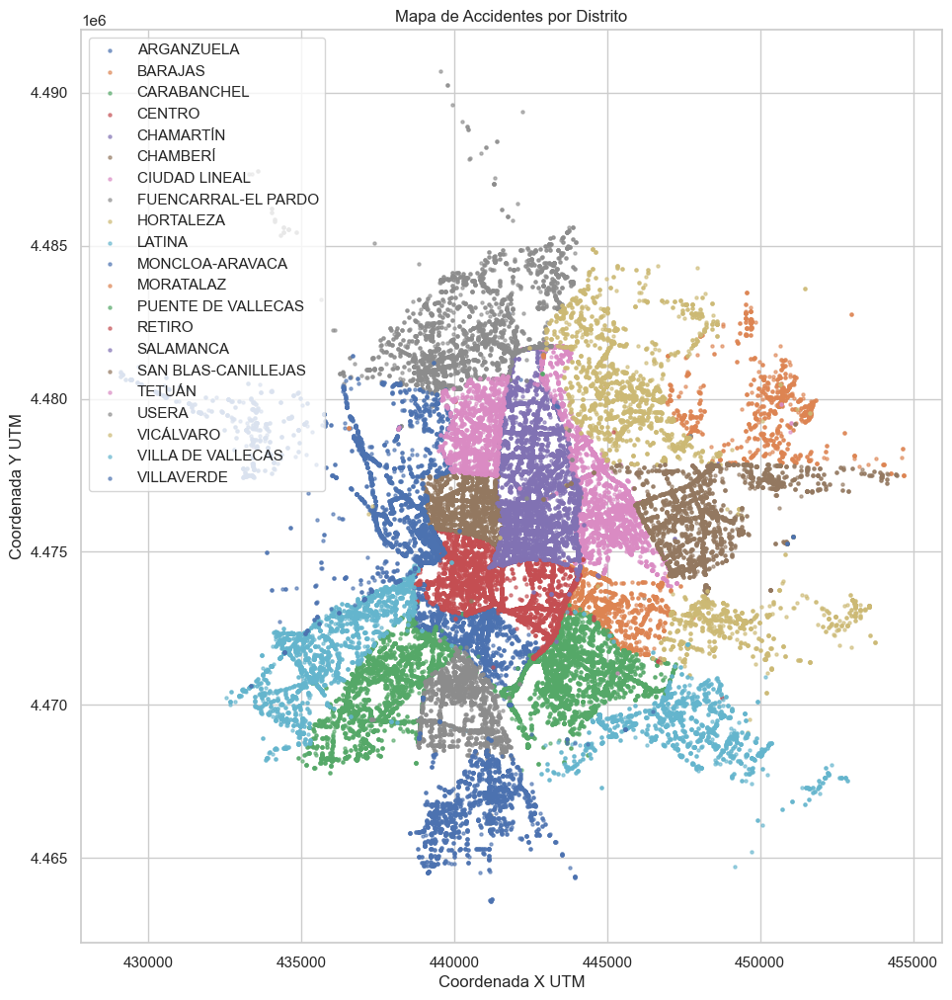

In [45]:
import geopandas as gpd
from shapely.geometry import Point

# Filtrando los datos para eliminar filas con coordenadas nulas
data_geo = combined_data_decr2.dropna(subset=['coordenada_x_utm', 'coordenada_y_utm'])

# Creando objetos geométricos a partir de las coordenadas UTM
geometry = [Point(xy) for xy in zip(data_geo['coordenada_x_utm'], data_geo['coordenada_y_utm'])]
geo_df = gpd.GeoDataFrame(data_geo, geometry=geometry)
# Asignando colores diferentes a cada distrito
fig, ax = plt.subplots(figsize=(12, 12))
for distrito, df_distrito in geo_df.groupby('distrito'):
    df_distrito.plot(ax=ax, markersize=5, label=distrito, alpha=0.6)

ax.set_title("Mapa de Accidentes por Distrito")
ax.set_xlabel("Coordenada X UTM")
ax.set_ylabel("Coordenada Y UTM")
ax.legend()
plt.grid(True)
plt.show()


Para identificar los accidentes que ocurrieron en la autovía M-30, filtraremos los datos utilizando la columna 'localizacion' para seleccionar aquellos registros que mencionen "M-30". Esta aproximación asume que la columna 'localizacion' contiene referencias precisas a las ubicaciones de los accidentes.

In [47]:
# Filtrando los accidentes que ocurrieron en la autovía M-30
accidentes_m30 = combined_data_decr2[combined_data_decr2['localizacion'].str.contains("M-30", na=False)]

# Contando el número de accidentes en la M-30
num_accidentes_m30 = accidentes_m30.shape[0]
num_accidentes_m30

5919

Creamos el mapa sobre la base que ya habíamos obtenido, añadiendo los accidentes en la autovía M-30

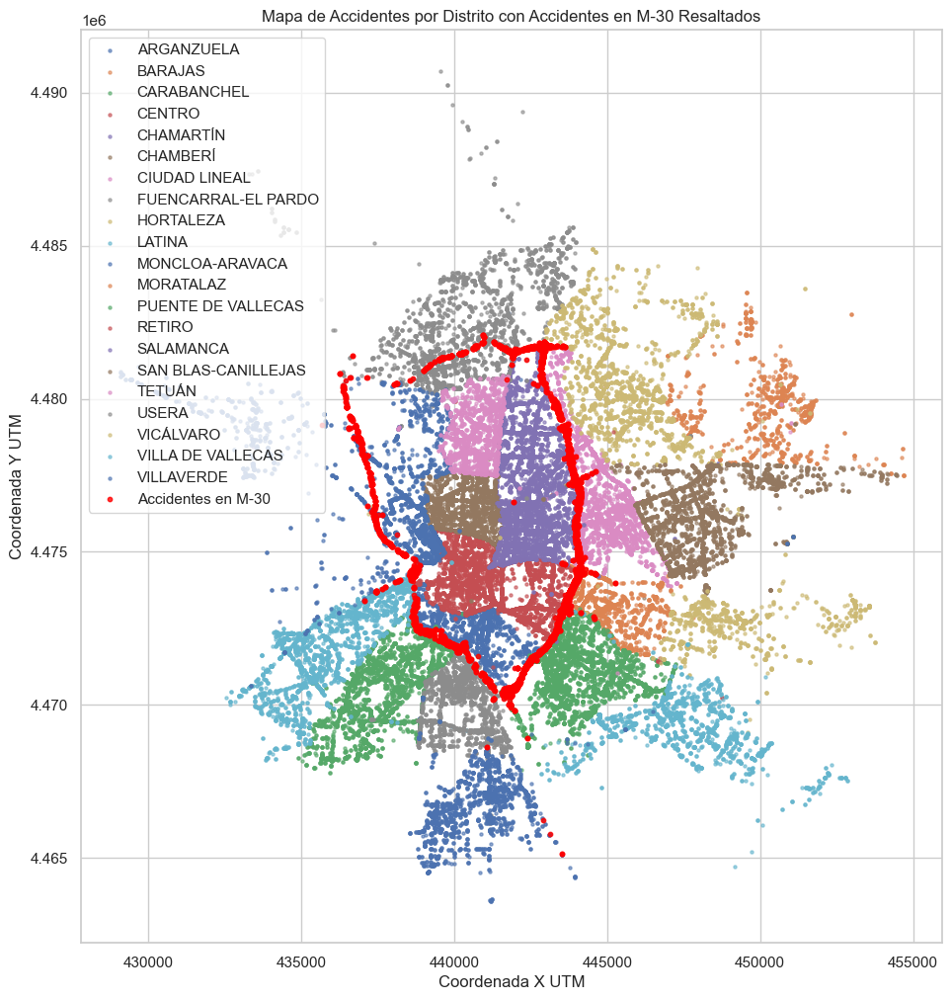

In [48]:
# Creando la geometría para los accidentes en la M-30
geometry_m30 = [Point(xy) for xy in zip(accidentes_m30['coordenada_x_utm'], accidentes_m30['coordenada_y_utm'])]
geo_df_m30 = gpd.GeoDataFrame(accidentes_m30, geometry=geometry_m30)

# Creando un nuevo mapa con la misma base y añadiendo los accidentes de la M-30 en rojo
fig, ax = plt.subplots(figsize=(12, 12))
for distrito, df_distrito in geo_df.groupby('distrito'):
    df_distrito.plot(ax=ax, markersize=5, label=distrito, alpha=0.6)

# Añadiendo los accidentes de la M-30
geo_df_m30.plot(ax=ax, markersize=10, color="red", label="Accidentes en M-30", alpha=0.8)

ax.set_title("Mapa de Accidentes por Distrito con Accidentes en M-30 Resaltados")
ax.set_xlabel("Coordenada X UTM")
ax.set_ylabel("Coordenada Y UTM")
ax.legend()
plt.grid(True)
plt.show()

### Desviación Estándar en Resultados de Pruebas de Alcohol vs. Gravedad del Accidente

Categorizamos la lesividad según:

**Leve:**
Asistencia sanitaria ambulatoria con posterioridad
Asistencia sanitaria sólo en el lugar del accidente
Atención en urgencias sin posterior ingreso
Sin asistencia sanitaria

**Moderada:**
Asistencia sanitaria inmediata en centro de salud o mutua
Ingreso inferior o igual a 24 hora

**Grave:**
Ingreso superior a 24 horas

**Fatal:**
Fallecido 24 horas

**Desconocido:**
Se desconoce
nan

In [43]:
# Mapeando los valores de lesividad a categorías de gravedad
def categorizar_lesividad(lesividad):
    categorias = {
        'Asistencia sanitaria ambulatoria con posterioridad': 'Leve',
        'Asistencia sanitaria sólo en el lugar del accidente': 'Leve',
        'Atención en urgencias sin posterior ingreso': 'Leve',
        'Sin asistencia sanitaria': 'Leve',
        'Asistencia sanitaria inmediata en centro de salud o mutua': 'Moderada',
        'Ingreso inferior o igual a 24 horas': 'Moderada',
        'Ingreso superior a 24 horas': 'Grave',
        'Fallecido 24 horas': 'Fatal',
        'Se desconoce': 'Desconocido',
        'nan': 'Desconocido'
    }
    return categorias.get(lesividad, 'Desconocido')

# Aplicando la transformación
combined_data_decr2['gravedad_accidente'] = combined_data_decr2['lesividad'].astype(str).apply(categorizar_lesividad)

# Calculando la desviación estándar de los resultados de las pruebas de alcohol por categoría de gravedad
std_alcohol_por_gravedad = combined_data_decr2.groupby('gravedad_accidente')['positiva_alcohol'].std()
std_alcohol_por_gravedad

gravedad_accidente
Desconocido    0.180604
Fatal          0.000000
Grave          0.194435
Leve           0.168641
Moderada       0.176793
Name: positiva_alcohol, dtype: float64

Estos resultados indican la variabilidad en los resultados de las pruebas de alcohol dentro de cada categoría de gravedad de accidente. Una desviación estándar de 0.0000 en la categoría "Fatal" sugiere que no hay variabilidad en los resultados de las pruebas de alcohol para esa categoría, lo que podría significar que hay pocos o ningún dato en esa categoría, o que todos los datos en esa categoría tienen el mismo valor.

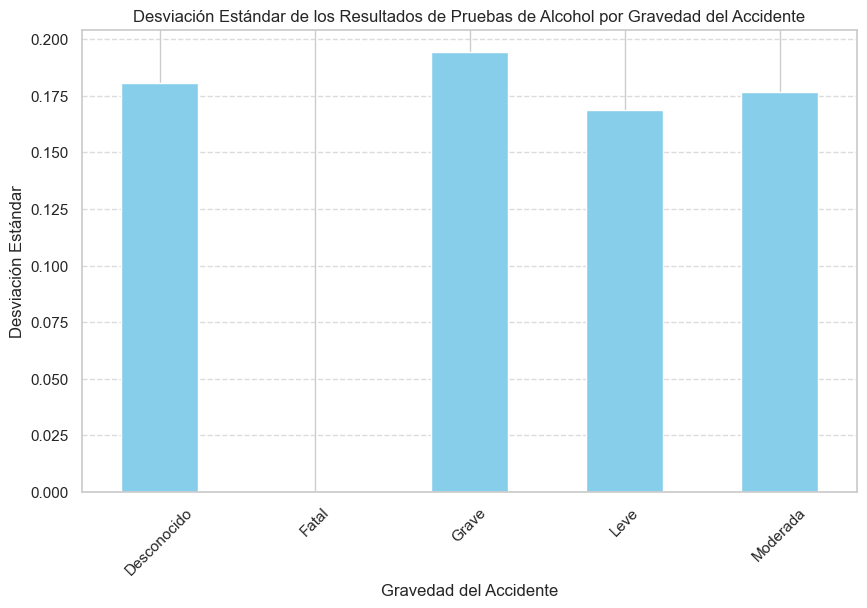

In [44]:
# Creando una gráfica de barras para la desviación estándar de los resultados de las pruebas de alcohol por gravedad
plt.figure(figsize=(10, 6))
std_alcohol_por_gravedad.plot(kind='bar', color='skyblue')
plt.title('Desviación Estándar de los Resultados de Pruebas de Alcohol por Gravedad del Accidente')
plt.xlabel('Gravedad del Accidente')
plt.ylabel('Desviación Estándar')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

Basándonos en la gráfica y los análisis realizados, podemos concluir lo siguiente:

**Variabilidad en Resultados de Pruebas de Alcohol:**

La categoría de accidentes **"Grave"** muestra la mayor variabilidad en los resultados de las pruebas de alcohol, indicada por la desviación estándar más alta (0.1944). Esto sugiere una mayor diversidad en los niveles de alcohol entre los involucrados en accidentes graves.
Las categorías "Leve" y "Moderada" también muestran una variabilidad significativa, aunque ligeramente menor en comparación con la categoría "Grave".
Categoría Fatal:

La categoría **"Fatal"** tiene una desviación estándar de 0, lo que sugiere que no hay variabilidad en los resultados de las pruebas de alcohol para esta categoría. Sin embargo, al investigar más a fondo, encontramos que no hay casos de accidentes fatales con pruebas de alcohol positivas en el conjunto de datos.
Datos Desconocidos:

La categoría **"Desconocido"** tiene una desviación estándar de 0.1806. Aunque esta categoría contiene datos, la clasificación de la gravedad de los accidentes es incierta, lo que limita la interpretación específica en el contexto de la gravedad del accidente.
Consideraciones Generales:

Estas conclusiones deben interpretarse teniendo en cuenta la naturaleza y calidad de los datos disponibles. Es importante considerar que la ausencia de casos en ciertas categorías (como accidentes fatales con alcohol positivo) puede deberse a limitaciones en la recolección de datos o a la naturaleza misma de los accidentes reportados.

In [116]:
combined_data_decr2['positiva_alcohol'].value_counts()

0.0    72591
1.0     2370
Name: positiva_alcohol, dtype: int64

# Implemetacion de herramienta de creacion de mapas para visualizar los datos de manera sencilla y mas detallada

In [ ]:
import os

import utm
import folium
import pandas as pd
from selenium import webdriver
from selenium.webdriver.chrome.service import Service
from webdriver_manager.chrome import ChromeDriverManager
from selenium.webdriver.chrome.options import Options


def utm_to_latlon(utm_x, utm_y, zone_number=30, zone_letter='T'):
    """
    Convert UTM coordinates to Latitude and Longitude.
    Assumes zone number 30 and zone letter 'T' for Madrid.
    """
    try:
        lat, lon = utm.to_latlon(utm_x, utm_y, zone_number, zone_letter)
        return lat, lon
    except Exception as e:
        print("Error en la conversión:", e, " utm_x: ", utm_x, "utm_y: ", utm_y, " ")
        return None, None


def create_png(map_file: str, output_dir='Maps/', map_name='map'):
    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)

    png_file = f"{output_dir}{map_name}.png"

    # Initialize Chrome Driver here
    chrome_options = Options()
    chrome_options.add_argument("--headless")  # Ensure GUI is off
    chrome_options.add_argument("--start-maximized")
    driver = webdriver.Chrome(ChromeDriverManager().install(), options=chrome_options)

    webdriver_service = Service(ChromeDriverManager().install())
    browser = webdriver.Chrome(options=chrome_options, service_log_path=webdriver_service)

    # Open HTML file with selenium
    browser.get(f'file:///{os.path.abspath(map_file)}')
    browser.set_window_size(1920, 1080)  # May need to adjust if map is not fully captured

    browser.implicitly_wait(5)
    browser.save_screenshot(png_file)

    browser.quit()

    return png_file


class MapCreator:
    def __init__(self, df: pd.DataFrame, lat_col_name: str = 'LATITUD', long_col_name: str = 'LONGITUD',
                 columns_for_label: list = [],
                 is_cords_utm=True):
        coords = [lat_col_name, long_col_name]
        self.df = df.dropna(subset=coords).copy()  # Drop rows where coordinates are NaN
        self.is_cords_utm = is_cords_utm
        self.columns_for_coordinates = coords
        if is_cords_utm:
            self.__to_lat_lon()

        if columns_for_label is not None:
            self.df_labels = self.df[columns_for_label].fillna('MISSING')
        else:
            self.df_labels = [lat_col_name, long_col_name]

    def set_columns_for_label(self, columns_for_label: list):
        self.df_labels = self.df[columns_for_label].fillna('MISSING')

    def set_df(self, df):
        self.df = df.dropna(subset=self.columns_for_coordinates)
        if self.is_cords_utm:
            self.__to_lat_lon()

    def __to_lat_lon(self):
        """
        Convert UTM coordinates to Latitude and Longitude if is_cords_utm is True.
        """
        # Apply the conversion to each row in the DataFrame
        self.df[self.columns_for_coordinates] = self.df.apply(
            lambda row: utm_to_latlon(row[self.columns_for_coordinates[0]], row[self.columns_for_coordinates[1]]),
            axis=1, result_type='expand'
        )
        self.df = self.df.dropna(subset=self.columns_for_coordinates)  # Remove rows where conversion failed

    def create_map(self, output_dir='Maps/', map_name='map', get_png=False):
        os.makedirs(output_dir, exist_ok=True)

        madrid_map = folium.Map(location=[40.4168, -3.7038], zoom_start=12)

        if self.df_labels is not None:
            coords = self.df.filter(items=self.columns_for_coordinates)
            labels = self.df_labels.to_dict(orient='records') if self.df_labels is not None else [{}] * len(coords)

            for (lat, lon), label in zip(coords.values, labels):
                popup_text = '\n'.join([f"{k}: {v}" for k, v in label.items()]) if label else ''
                folium.Marker([lat, lon], popup=popup_text).add_to(madrid_map)
        else:
            coords = self.df[list(self.columns_for_coordinates)]
            for (lat, lon) in coords.values:
                folium.Marker([lat, lon]).add_to(madrid_map)

        # Save the map to an HTML file
        map_file = f"{output_dir}{map_name}.html"
        madrid_map.save(map_file)

        if get_png:
            return create_png(map_file, output_dir, map_name)


# Analisis Exploratorio cerca de colegios y escuelas

In [66]:
import chardet

df_accidentes = pd.read_csv('./Datasets/Data_Combinada.csv')
df_schools = pd.read_csv('./Datasets/212790-0-centros-educacion.csv', sep=';', encoding='ISO-8859-1')

/tmp/ipykernel_62465/2967255395.py:8: DtypeWarning: Columns (15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df_accidentes = pd.read_csv('./Datasets/Data_Combinada.csv')


In [67]:
with open('./Datasets/212790-0-centros-educacion.csv', 'rb') as f:
    result = chardet.detect(f.readline())
    print(result)

{'encoding': 'ascii', 'confidence': 1.0, 'language': ''}


# Análisis Exploratorio Inicial

In [68]:
df_schools.head()

,PK,NOMBRE,DESCRIPCION-ENTIDAD,HORARIO,EQUIPAMIENTO,TRANSPORTE,DESCRIPCION,ACCESIBILIDAD,CONTENT-URL,NOMBRE-VIA,...,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TELEFONO,FAX,EMAIL,TIPO
0,167390,Academia Darío Estudio,NaN,NaN,NaN,"METRO: Santo Domingo, Plaza España BUS: 1 , 2 ...",ENSEÑANZA: BACHILLERATO (Humanidades y C. Soc...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,GRAN VIA,...,1.0,CENTRO,439895.0,4475101.0,40.422491,-3.709818,915 411 515 - 915 474 084,915 474 084,info@darioestudio.es,/contenido/entidadesYorganismos/CentrosEducaci...
1,5373,"Altair, Colegio Internacional",NaN,NaN,Comedor - Transporte - Horario ampliado,"METRO: Plaza de Castilla BUS: 5 , 27 , 47 , 49...",ENSEÑANZA: Educación infantil - Primaria - ESO...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,JOAQUIN BAU,...,5.0,CHAMARTIN,441854.0,4479461.0,40.463788,-3.685848,913 451 168 - 913 596 368,913 507 016,secretaria@colegioaltair.com,/contenido/entidadesYorganismos/CentrosEducaci...
2,10127337,Aula Municipal de Formación de Personas Adulta...,NaN,De lunes a jueves: Mañanas de 08:30 a 13:00...,NaN,"Metro: Embajadores. Lavapiés, Acacias Bus: ...",Programas Formativos: Español para extranjeros.,1.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,CASINO,...,1.0,CENTRO,440152.0,4473128.0,40.406617,-3.705326,91 539 63 10,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
3,5422896,Aula Municipal de Formación de Personas Adulta...,NaN,"De lunes a jueves: mañanas de 10,15 a 12,15 h...",NaN,"Bus: 3, 7, 21, 37, 40 Metro: Alonso Martínez",Programas Formativos: LectoescrituraMatemáti...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,ALMAGRO,...,7.0,CHAMBERI,441045.0,4475554.0,40.428526,-3.695039,917 001 548 - 917 001 552,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
4,6599,Aula Municipal de Formación de Personas Adulta...,NaN,De lunes a jueves: mañanas de 9:00 a 13:30 h...,NaN,"Bus: 15 , 28 , 110 , 113 , 210 Metro: La Elipa...",Programas Formativos: Lectoescritura. Matem...,1.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,SANTA FELICIDAD,...,15.0,CIUDAD LINEAL,444837.0,4475071.0,40.424435,-3.650284,914 055 312,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...


In [69]:
df1_info = df_schools.info()

df1_description = df_schools.describe(include='all')

df1_nulls = df_schools.isnull().sum()

df1_duplicated = df_schools.duplicated().sum()

df1_info, df1_description, df1_nulls, df1_duplicated

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1503 entries, 0 to 1502
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   PK                   1503 non-null   int64  
 1   NOMBRE               1503 non-null   object 
 2   DESCRIPCION-ENTIDAD  90 non-null     object 
 3   HORARIO              25 non-null     object 
 4   EQUIPAMIENTO         788 non-null    object 
 5   TRANSPORTE           1489 non-null   object 
 6   DESCRIPCION          1460 non-null   object 
 7   ACCESIBILIDAD        1440 non-null   float64
 8   CONTENT-URL          1503 non-null   object 
 9   NOMBRE-VIA           1503 non-null   object 
 10  CLASE-VIAL           1502 non-null   object 
 11  TIPO-NUM             1501 non-null   object 
 12  NUM                  1490 non-null   object 
 13  PLANTA               4 non-null      object 
 14  PUERTA               0 non-null      float64
 15  ESCALERAS            0 non-null      f

(None,
                   PK                  NOMBRE  \
 count   1.503000e+03                    1503   
 unique           NaN                    1503   
 top              NaN  Academia Darío Estudio   
 freq             NaN                       1   
 mean    2.350380e+06                     NaN   
 std     3.733567e+06                     NaN   
 min     1.085000e+03                     NaN   
 25%     5.543500e+03                     NaN   
 50%     6.227000e+03                     NaN   
 75%     5.154940e+06                     NaN   
 max     1.208375e+07                     NaN   
 
                                       DESCRIPCION-ENTIDAD             HORARIO  \
 count                                                  90                  25   
 unique                                                 12                  18   
 top     Centro Privado de Formación Profesional Especí...  Jornada continuada   
 freq                                                   29                 

### Estructura del Dataset:
El dataset tiene 1503 filas y 32 columnas.
Las columnas cubren una amplia gama de información, desde detalles del centro educativo (nombre, descripción, horario, etc.) hasta información de contacto y ubicación geográfica.

### Calidad de los Datos:

Hay una cantidad significativa de valores faltantes en varias columnas, especialmente en DESCRIPCION-ENTIDAD, HORARIO, PLANTA, PUERTA, ESCALERAS, y ORIENTACION. Esto indica que ciertas columnas pueden no ser útiles para un análisis más profundo a menos que se realice una limpieza de datos.
La columna ACCESIBILIDAD parece ser numérica con valores 0 o 1, indicando si el centro es accesible o no.
No se detectaron filas duplicadas, lo que es positivo para la integridad del dataset.
Las columnas LATITUD y LONGITUD proporcionan ubicaciones geográficas, que utilizaremos para nuestro posterior análisis.

### Descripción de las Columnas:

Cada centro educativo tiene un NOMBRE único.
TIPO tiene 13 categorías únicas, indicando posiblemente tipos diferentes de centros educativos.
EMAIL tiene 803 valores únicos, lo que indica que no todos los centros tienen información de contacto por correo electrónico disponible.

In [70]:
df_map = df_schools.filter(items=['NOMBRE', 'COORDENADA-X', 'COORDENADA-Y', 'LONGITUD', 'LATITUD'])
df_map.dropna()
df_map.head()

,NOMBRE,COORDENADA-X,COORDENADA-Y,LONGITUD,LATITUD
0,Academia Darío Estudio,439895.0,4475101.0,-3.709818,40.422491
1,"Altair, Colegio Internacional",441854.0,4479461.0,-3.685848,40.463788
2,Aula Municipal de Formación de Personas Adulta...,440152.0,4473128.0,-3.705326,40.406617
3,Aula Municipal de Formación de Personas Adulta...,441045.0,4475554.0,-3.695039,40.428526
4,Aula Municipal de Formación de Personas Adulta...,444837.0,4475071.0,-3.650284,40.424435


Procedemos a pintar los colegios sobre el mapa para ver si está bien clasificados

In [71]:
map_schools = MapCreator(df_map, lat_col_name='LATITUD', long_col_name='LONGITUD',
                         columns_for_label=['NOMBRE', 'LATITUD', 'LONGITUD'],
                         is_cords_utm=False)
map_schools.create_map(map_name='colegios')

# Limpieza de datos
Vamos a utilizar la información de la calle para agrupar los accidentes, por lo que es necesario limpiar esas columnas

In [72]:
df_schools

,PK,NOMBRE,DESCRIPCION-ENTIDAD,HORARIO,EQUIPAMIENTO,TRANSPORTE,DESCRIPCION,ACCESIBILIDAD,CONTENT-URL,NOMBRE-VIA,...,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TELEFONO,FAX,EMAIL,TIPO
0,167390,Academia Darío Estudio,NaN,NaN,NaN,"METRO: Santo Domingo, Plaza España BUS: 1 , 2 ...",ENSEÑANZA: BACHILLERATO (Humanidades y C. Soc...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,GRAN VIA,...,1.0,CENTRO,439895.0,4475101.0,40.422491,-3.709818,915 411 515 - 915 474 084,915 474 084,info@darioestudio.es,/contenido/entidadesYorganismos/CentrosEducaci...
1,5373,"Altair, Colegio Internacional",NaN,NaN,Comedor - Transporte - Horario ampliado,"METRO: Plaza de Castilla BUS: 5 , 27 , 47 , 49...",ENSEÑANZA: Educación infantil - Primaria - ESO...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,JOAQUIN BAU,...,5.0,CHAMARTIN,441854.0,4479461.0,40.463788,-3.685848,913 451 168 - 913 596 368,913 507 016,secretaria@colegioaltair.com,/contenido/entidadesYorganismos/CentrosEducaci...
2,10127337,Aula Municipal de Formación de Personas Adulta...,NaN,De lunes a jueves: Mañanas de 08:30 a 13:00...,NaN,"Metro: Embajadores. Lavapiés, Acacias Bus: ...",Programas Formativos: Español para extranjeros.,1.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,CASINO,...,1.0,CENTRO,440152.0,4473128.0,40.406617,-3.705326,91 539 63 10,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
3,5422896,Aula Municipal de Formación de Personas Adulta...,NaN,"De lunes a jueves: mañanas de 10,15 a 12,15 h...",NaN,"Bus: 3, 7, 21, 37, 40 Metro: Alonso Martínez",Programas Formativos: LectoescrituraMatemáti...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,ALMAGRO,...,7.0,CHAMBERI,441045.0,4475554.0,40.428526,-3.695039,917 001 548 - 917 001 552,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
4,6599,Aula Municipal de Formación de Personas Adulta...,NaN,De lunes a jueves: mañanas de 9:00 a 13:30 h...,NaN,"Bus: 15 , 28 , 110 , 113 , 210 Metro: La Elipa...",Programas Formativos: Lectoescritura. Matem...,1.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,SANTA FELICIDAD,...,15.0,CIUDAD LINEAL,444837.0,4475071.0,40.424435,-3.650284,914 055 312,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1498,6258,Organización Profesional Española (OPESA),Centro privado de formación profesional especí...,NaN,NaN,Metro: Manuel Becerra (líneas 2 y 6). Bus: 14...,Formación profesional de grado superior Sanid...,3.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,AYALA,...,4.0,SALAMANCA,443197.0,4475378.0,40.427106,-3.669642,914 027 062 / 914 027 262,NaN,secretaria@opesafp.com,/contenido/entidadesYorganismos/CentrosEducaci...
1499,6070,Real Colegio Santa Isabel - La Asunción,NaN,NaN,Horario ampliado - Comedor,"Metro: Atocha , Antón Martín Bus: 6 , 19 , 26...",ENSEÑANZA: Educación Infantil (segundo ciclo) ...,0.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,SANTA ISABEL,...,1.0,CENTRO,441006.0,4473664.0,40.409625,-3.696577,915 273 183 - 915 273 181,915 289 845,cc.rcsantaisabel.madrid@educa.madrid.org,/contenido/entidadesYorganismos/MonumentosEdif...
1500,6460544,San Román Escuela de Estudios Superiores,Centro privado de formación profesional especí...,NaN,NaN,"Metro: Lista (línea 4), Manuel Becerra (líneas...",Formación profesional de grado superior Ser...,3.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,MONTESA,...,4.0,SALAMANCA,442979.0,4475750.0,40.430437,-3.672239,913 092 409,NaN,infomadrid@sanroman.com,/contenido/entidadesYorganismos/CentrosEducaci...
1501,7531916,Sanromán Centro Internacional de Estudios Prof...,Centro privado de formación profesional especí...,NaN,NaN,"Metro: Diego de León (línea 4, 5 y 6). Bus: 4...",Formación profesional grado medio Servicios s...,3.0,http://www.madrid.es/sites/v/index.jsp?vgnextc...,FERRER DEL RIO,...,4.0,SALAMANCA,442962.0,4476143.0,40.433978,-3.672479,914 232 323,NaN,infomadrid@sanroman.com,/conten

Tiramos las columnas con un exceso de nulos. Es decir, más nulos que valores, y que además, no conciernen a la investigación, ya que solo necesitamos información sobre la dirección de la escuela.

Descripción entidad tiene una calidad demasiado mala, como se ve abajo.
El equipamiento de la escuela no nos importa.
El horario tiene una calidad demasiada mala
El transporte no nos importa.
La descripción puede servir para saber la edad de los implicados.
La accesibilidad no importa al análisis a realizar.
El url no importa.
Nombre de vía y clase vial a quedarse.
Tipo num es de tipo V/KM o Sin número, en principio no importa ya que solo vamos a quedarnos con la calle.
Planta tiene 4 entradas de 1503, a eliminar.
Escaleras no tiene ninguna entrada.
Orientación tiene el 96.4% de sus valores nulos, lo exploraré más abajo.
La localidad y la provincia es siempre Madrid, la columna se tira.
El código postal será útil para agrupar por distritos.
El código barrio no aparece en la documentación, pero teniendo codigo distrito será innecesario.
Distrito y coordenadas a quedarse.
Orientación a eliminar, según el anexo es solo para encontrar más fácilmente el edificio.
Los datos de contacto no son necesarios.
El tipo de escuela es interesante, puede servir para clasificar a adultos niños y adolescentes.


In [73]:
df_schools['DESCRIPCION-ENTIDAD'].unique()

array([nan, 'Centro Privado de Formación Profesional Específica.',
       'Fundación Querer',
       'Centro Privado de Formación Profesional Específica',
       'Centro privado de formación profesional específica',
       'Centro privado de formación profesional específica.',
       'Centro privado de formacion profesional específica',
       'Centro privado de formacion profesional específica.',
       'Centro Privado en Formación Profesional específica.',
       'Centro Privado en Formación Profesional específica',
       'Centro privado de educación secundaria',
       'ENSEÑANZA: Educacion Infantil - Primaria - Enseñanza biling&amp;uuml;e',
       'Educación de 0 a 3 años'], dtype=object)

Calidad malísima, no merece la pena recuperar, igual que horario, que tiene solo 25 entradas de 1503

In [74]:
df_schools.drop(
    columns=['DESCRIPCION-ENTIDAD', 'HORARIO', 'TRANSPORTE', 'PK', 'DESCRIPCION-ENTIDAD', 'CONTENT-URL', 'EMAIL',
             'EQUIPAMIENTO', 'ESCALERAS', 'FAX', 'ACCESIBILIDAD', 'PUERTA', 'PLANTA', 'LOCALIDAD', 'PROVINCIA',
             'COD-BARRIO', 'TELEFONO', 'ORIENTACION'], inplace=True)

In [75]:
df_schools

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
0,Academia Darío Estudio,ENSEÑANZA: BACHILLERATO (Humanidades y C. Soc...,GRAN VIA,CALLE,V,63,28013,PALACIO,1.0,CENTRO,439895.0,4475101.0,40.422491,-3.709818,/contenido/entidadesYorganismos/CentrosEducaci...
1,"Altair, Colegio Internacional",ENSEÑANZA: Educación infantil - Primaria - ESO...,JOAQUIN BAU,CALLE,NUM,4,28036,NUEVA ESPAÑA,5.0,CHAMARTIN,441854.0,4479461.0,40.463788,-3.685848,/contenido/entidadesYorganismos/CentrosEducaci...
2,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,CASINO,CALLE,V,5,28005,EMBAJADORES,1.0,CENTRO,440152.0,4473128.0,40.406617,-3.705326,/contenido/entidadesYorganismos/CentrosEducaci...
3,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,ALMAGRO,CALLE,V,5,28010,ALMAGRO,7.0,CHAMBERI,441045.0,4475554.0,40.428526,-3.695039,/contenido/entidadesYorganismos/CentrosEducaci...
4,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura. Matem...,SANTA FELICIDAD,CALLE,NUM,39,28017,VENTAS,15.0,CIUDAD LINEAL,444837.0,4475071.0,40.424435,-3.650284,/contenido/entidadesYorganismos/CentrosEducaci...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1498,Organización Profesional Española (OPESA),Formación profesional de grado superior Sanid...,AYALA,CALLE,V,111,28009,GOYA,4.0,SALAMANCA,443197.0,4475378.0,40.427106,-3.669642,/contenido/entidadesYorganismos/CentrosEducaci...
1499,Real Colegio Santa Isabel - La Asunción,ENSEÑANZA: Educación Infantil (segundo ciclo) ...,SANTA ISABEL,CALLE,V,46,28012,EMBAJADORES,1.0,CENTRO,441006.0,4473664.0,40.409625,-3.696577,/contenido/entidadesYorganismos/MonumentosEdif...
1500,San Román Escuela de Estudios Superiores,Formación profesional de grado superior Ser...,MONTESA,CALLE,V,39,28006,LISTA,4.0,SALAMANCA,442979.0,4475750.0,40.430437,-3.672239,/contenido/entidadesYorganismos/CentrosEducaci...
1501,Sanromán Centro Internacional de Estudios Prof...,Formación profesional grado medio Servicios s...,FERRER DEL RIO,CALLE,V,10,28028,GUINDALERA,4.0,SALAMANCA,442962.0,4476143.0,40.433978,-3.672479,/contenido/entidadesYorganismos/CentrosEducaci...


In [76]:
df_schools['DESCRIPCION'].unique()

array(['ENSEÑANZA: BACHILLERATO (Humanidades  y C. Sociales - Ciencias y Tecnología)',
       'ENSEÑANZA: Educación infantil - Primaria - ESO - BACHILLERATO (Humanidades y Ciencias Sociales - Ciencias)',
       'Programas Formativos:   Español para extranjeros.',
       'Programas Formativos:   LectoescrituraMatemáticas para la vidaEspañol para inmigrantes',
       'Programas Formativos:    Lectoescritura. Matemáticas para la vida. Español para extranjeros. Alfabetización digital.',
       'Programas Formativos:   Lectoescritura.Matemáticas para la vida.',
       'ENSEÑANZA: Educación infantil (Primer Ciclo)',
       'ENSEÑANZA: Educación infantil (Primer ciclo)',
       'ENSEÑANZA: Educación Infantil (Primer ciclo)',
       'Enseñanzas  Educación especial:  Educación Básica Obligatoria',
       'Enseñanzas   Enseñanzas Iniciales Básicas para personas adultas Educación Secundaria Obligatoria para personas adultas',
       'Formación profesional de grado medio  Administración y gestión:

Vamos a ver los 43 faltantes de descripción

In [77]:
df_schools[df_schools['DESCRIPCION'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
19,Centro de Educación de Personas Adultas (CEPA)...,NaN,CORREGIDOR ALONSO DE TOBAR,CALLE,V,7,28030,FONTARRON,14.0,MORATALAZ,444903.0,4472790.0,40.403902,-3.649307,/contenido/entidadesYorganismos/CentrosEducaci...
20,Centro de Educación de Personas Adultas (CEPA)...,NaN,OCA&amp;Ntilde;A,CALLE,V,35,28047,ALUCHE,10.0,LATINA,435920.0,4470749.0,40.384874,-3.754949,/contenido/entidadesYorganismos/CentrosEducaci...
21,Centro de Educación de Personas Adultas (CEPA)...,NaN,BATALLA DEL SALADO,CALLE,V,29,28045,DELICIAS,2.0,ARGANZUELA,440929.0,4472441.0,40.400488,-3.696099,/contenido/entidadesYorganismos/CentrosEducaci...
22,Centro de Educación de Personas Adultas (CEPA)...,NaN,MUSAS,CALLE,V,11,28022,CANILLEJAS,20.0,SAN BLAS-CANILLEJAS,448402.0,4476525.0,40.437771,-3.608367,/contenido/entidadesYorganismos/CentrosEducaci...
23,Centro de Educación de Personas Adultas (CEPA)...,NaN,ANSELMO LORENZO,CALLE,V,12,28044,LAS AGUILAS,10.0,LATINA,434584.0,4470420.0,40.381809,-3.770655,/contenido/entidadesYorganismos/CentrosEducaci...
24,Centro de Educación de Personas Adultas (CEPA)...,NaN,HERMANOS GARCIA NOBLEJAS,CALLE,V,70,28037,PUEBLO NUEVO,15.0,CIUDAD LINEAL,446376.0,4475605.0,40.429357,-3.632177,/contenido/entidadesYorganismos/CentrosEducaci...
25,Centro de Educación de Personas Adultas (CEPA)...,NaN,FERNANDO ORTIZ,CALLE,V,2,28041,ORCASUR,12.0,USERA,440332.0,4468758.0,40.367264,-3.702789,/contenido/entidadesYorganismos/CentrosEducaci...
27,Centro de Educación de Personas Adultas (CEPA)...,NaN,ABERTURA,CALLE,V,2,28033,PINAR DEL REY,16.0,HORTALEZA,444936.0,4480925.0,40.477193,-3.649620,/contenido/entidadesYorganismos/CentrosEducaci...
28,Centro de Educación de Personas Adultas (CEPA)...,NaN,SERENA,CALLE,V,394,28053,ENTREVIAS,13.0,PUENTE DE VALLECAS,443161.0,4469765.0,40.376535,-3.669555,/contenido/entidadesYorganismos/CentrosEducaci...
29,Centro de Educación de Personas Adultas (CEPA)...,NaN,BRAILLE,CALLE,V,10,28034,VALVERDE,8.0,FUENCARRAL-EL PARDO,441228.0,4483026.0,40.495858,-3.693552,/contenido/entidadesYorganismos/CentrosEducaci...


Vamos a indagar a ver si alguno tiene puesta la etiqueta

In [78]:
patron = r"Personas Adultas"

df_coincidencias = df_schools[df_schools['NOMBRE'].str.contains(patron)].copy()
df_coincidencias['DESCRIPCION'].unique()

array(['Programas Formativos:   Español para extranjeros.',
       'Programas Formativos:   LectoescrituraMatemáticas para la vidaEspañol para inmigrantes',
       'Programas Formativos:    Lectoescritura. Matemáticas para la vida. Español para extranjeros. Alfabetización digital.',
       'Programas Formativos:   Lectoescritura.Matemáticas para la vida.',
       nan,
       'Enseñanzas:   Preparación acceso a la universidad para mayores de 25 años Preparación para  la prueba de conocimientos constitucionales Talleres ocupacionales cofinanciados Talleres operativos para alumnado con discapacidad Enseñanzas iniciales básicas para personas adultas Educación Secundaria obligatoria para personas adultas Español para extranjeros Cursos a distancia soporte telemático: Aula Mentor',
       'Enseñanzas:   Francés Inglés Informática Informática-ofimática Escritura creativa Preparación para la prueba de conocimientos constitucionales Preparación acceso Ciclos Formativos Grado Superior Enseñanzas

In [79]:
df_coincidencias

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
2,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,CASINO,CALLE,V,5,28005,EMBAJADORES,1.0,CENTRO,440152.0,4473128.0,40.406617,-3.705326,/contenido/entidadesYorganismos/CentrosEducaci...
3,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,ALMAGRO,CALLE,V,5,28010,ALMAGRO,7.0,CHAMBERI,441045.0,4475554.0,40.428526,-3.695039,/contenido/entidadesYorganismos/CentrosEducaci...
4,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura. Matem...,SANTA FELICIDAD,CALLE,NUM,39,28017,VENTAS,15.0,CIUDAD LINEAL,444837.0,4475071.0,40.424435,-3.650284,/contenido/entidadesYorganismos/CentrosEducaci...
5,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura.Matemát...,SAN ROMAN DEL VALLE,CALLE,NUM,8,28037,ARCOS,20.0,SAN BLAS-CANILLEJAS,447249.0,4474586.0,40.420232,-3.621811,/contenido/entidadesYorganismos/CentrosEducaci...
6,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,DOCTOR MARTIN AREVALO,CALLE,V,2,28021,SAN ANDRES,NaN,VILLAVERDE,439827.0,4466442.0,40.346363,-3.708524,/contenido/entidadesYorganismos/CentrosEducaci...
7,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,PINAZO,PLAZA,V,9,28021,SAN CRISTOBAL,17.0,VILLAVERDE,441274.0,4466022.0,40.342682,-3.691449,/contenido/entidadesYorganismos/CentrosEducaci...
19,Centro de Educación de Personas Adultas (CEPA)...,NaN,CORREGIDOR ALONSO DE TOBAR,CALLE,V,7,28030,FONTARRON,14.0,MORATALAZ,444903.0,4472790.0,40.403902,-3.649307,/contenido/entidadesYorganismos/CentrosEducaci...
20,Centro de Educación de Personas Adultas (CEPA)...,NaN,OCA&amp;Ntilde;A,CALLE,V,35,28047,ALUCHE,10.0,LATINA,435920.0,4470749.0,40.384874,-3.754949,/contenido/entidadesYorganismos/CentrosEducaci...
21,Centro de Educación de Personas Adultas (CEPA)...,NaN,BATALLA DEL SALADO,CALLE,V,29,28045,DELICIAS,2.0,ARGANZUELA,440929.0,4472441.0,40.400488,-3.696099,/contenido/entidadesYorganismos/CentrosEducaci...
22,Centro de Educación de Personas Adultas (CEPA)...,NaN,MUSAS,CALLE,V,11,28022,CANILLEJAS,20.0,SAN BLAS-CANILLEJAS,448402.0,4476525.0,40.437771,-3.608367,/contenido/entidadesYorganismos/CentrosEducaci...


Concluimos que no es posible discernirlos con solo su nombre. Pondremos un filler: Centro de educación de adultos

In [80]:
df_coincidencias.fillna('Adultos enseñanzas no especificadas', inplace=True)

/tmp/ipykernel_62465/791856484.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'Adultos enseñanzas no especificadas' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df_coincidencias.fillna('Adultos enseñanzas no especificadas', inplace=True)


In [81]:
df_coincidencias

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
2,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,CASINO,CALLE,V,5,28005,EMBAJADORES,1.0,CENTRO,440152.0,4473128.0,40.406617,-3.705326,/contenido/entidadesYorganismos/CentrosEducaci...
3,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,ALMAGRO,CALLE,V,5,28010,ALMAGRO,7.0,CHAMBERI,441045.0,4475554.0,40.428526,-3.695039,/contenido/entidadesYorganismos/CentrosEducaci...
4,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura. Matem...,SANTA FELICIDAD,CALLE,NUM,39,28017,VENTAS,15.0,CIUDAD LINEAL,444837.0,4475071.0,40.424435,-3.650284,/contenido/entidadesYorganismos/CentrosEducaci...
5,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura.Matemát...,SAN ROMAN DEL VALLE,CALLE,NUM,8,28037,ARCOS,20.0,SAN BLAS-CANILLEJAS,447249.0,4474586.0,40.420232,-3.621811,/contenido/entidadesYorganismos/CentrosEducaci...
6,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,DOCTOR MARTIN AREVALO,CALLE,V,2,28021,SAN ANDRES,Adultos enseñanzas no especificadas,VILLAVERDE,439827.0,4466442.0,40.346363,-3.708524,/contenido/entidadesYorganismos/CentrosEducaci...
7,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,PINAZO,PLAZA,V,9,28021,SAN CRISTOBAL,17.0,VILLAVERDE,441274.0,4466022.0,40.342682,-3.691449,/contenido/entidadesYorganismos/CentrosEducaci...
19,Centro de Educación de Personas Adultas (CEPA)...,Adultos enseñanzas no especificadas,CORREGIDOR ALONSO DE TOBAR,CALLE,V,7,28030,FONTARRON,14.0,MORATALAZ,444903.0,4472790.0,40.403902,-3.649307,/contenido/entidadesYorganismos/CentrosEducaci...
20,Centro de Educación de Personas Adultas (CEPA)...,Adultos enseñanzas no especificadas,OCA&amp;Ntilde;A,CALLE,V,35,28047,ALUCHE,10.0,LATINA,435920.0,4470749.0,40.384874,-3.754949,/contenido/entidadesYorganismos/CentrosEducaci...
21,Centro de Educación de Personas Adultas (CEPA)...,Adultos enseñanzas no especificadas,BATALLA DEL SALADO,CALLE,V,29,28045,DELICIAS,2.0,ARGANZUELA,440929.0,4472441.0,40.400488,-3.696099,/contenido/entidadesYorganismos/CentrosEducaci...
22,Centro de Educación de Personas Adultas (CEPA)...,Adultos enseñanzas no especificadas,MUSAS,CALLE,V,11,28022,CANILLEJAS,20.0,SAN BLAS-CANILLEJAS,448402.0,4476525.0,40.437771,-3.608367,/contenido/entidadesYorganismos/CentrosEducaci...


In [82]:
df_schools.update(df_coincidencias)

In [83]:
df_schools[df_schools['DESCRIPCION'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
89,Centro de enseñanza CODESA,NaN,DIEGO DE LEON,CALLE,V,34,28006,CASTELLANA,4.0,SALAMANCA,442210.0,4476230.0,40.434707,-3.681346,/contenido/entidadesYorganismos/CentrosEducaci...
90,Centro de enseñanza Cruz Roja,NaN,DE RAFAEL VILLA,CALLE,V,NaN,28023,EL PLANTIO,9.0,MONCLOA-ARAVACA,430541.0,4480174.0,40.469333,-3.819366,/contenido/entidadesYorganismos/CentrosEducaci...
91,Centro de enseñanza Cruz Roja Escuela Profesional,NaN,REINA VICTORIA,AVENIDA,V,28,28003,CIUDAD UNIVERSITARIA,9.0,MONCLOA-ARAVACA,439817.0,4477640.0,40.447246,-3.709695,/contenido/entidadesYorganismos/CentrosEducaci...
146,Centro integrado de enseñanzas regladas a dist...,NaN,PRADO,PASEO,V,28,28014,CORTES,1.0,CENTRO,441174.0,4473706.0,40.411896,-3.693334,/contenido/entidadesYorganismos/CentrosEducaci...
903,Escuela Infantil Contumami la Vaguada,NaN,FONSAGRADA,PLAZA,NUM,10,28029,EL PILAR,8.0,FUENCARRAL-EL PARDO,439960.0,4481061.0,40.478058,-3.708338,/contenido/entidadesYorganismos/CentrosEducaci...
947,Escuela Infantil El Bosque Encantado. Calle An...,NaN,ANTONIO LOPEZ,CALLE,V,246,28026,ALMENDRALES,12.0,USERA,440926.0,4470378.0,40.381906,-3.695938,/contenido/entidadesYorganismos/CentrosEducaci...
988,Escuela Infantil Fantasía II,NaN,JUSTA GARCIA,CALLE,V,12,28026,PRADOLONGO,12.0,USERA,439780.0,4470412.0,40.382114,-3.709464,/contenido/entidadesYorganismos/CentrosEducaci...
1057,Escuela Infantil Lapizitos. Calle Condesa de Teba,NaN,CONDESA DE TEBA,CALLE,V,11,28044,BUENAVISTA,11.0,CARABANCHEL,435616.0,4469483.0,40.373434,-3.758423,/contenido/entidadesYorganismos/CentrosEducaci...
1102,Escuela Infantil Mamá Queca II,NaN,SANCHEZ GUERRERO,CALLE,V,7,28043,CANILLAS,16.0,HORTALEZA,444636.0,4479749.0,40.466573,-3.653061,/contenido/entidadesYorganismos/CentrosEducaci...
1225,Escuela Infantil Nubbe,NaN,TRES OLIVOS,PLAZA,NUM,16,28034,VALVERDE,8.0,FUENCARRAL-EL PARDO,441536.0,4483695.0,40.501908,-3.689989,/contenido/entidadesYorganismos/CentrosEducaci...


In [84]:
patron = r"Infantil"

df_coincidencias = df_schools[df_schools['NOMBRE'].str.contains(patron)].copy()
df_coincidencias['DESCRIPCION'].unique()

array(['Enseñanzas  Educación especial:  Educación Infantil Educación Básica Obligatoria Transición a la Vida Adulta  Ubicado en el Hospital Infantil de San Rafael',
       'ENSEÑANZA: Educación Infantil (Primer y segundo ciclo) - Primaria - ESO',
       'Enseñanza: Educación infantil (Primer y segundo ciclo)',
       'ENSEÑANZA: Educación infantil (Primer ciclo)',
       'Enseñanza: Educación infantil (Primer ciclo)',
       'ENSEÑANZA: Educación infantil (Primer Ciclo)',
       'Enseñanza: Educación infantil (Primer Ciclo)',
       'ENSEÑANZA: Sistema Educativo Alemán  EDUCACIÓN: Infantil 1er y 2&amp;ordm; Ciclo ALUMNOS: Españoles - Alemanes  IDIOMA: Alemán  EDAD: De 2 a 6 años',
       'Enseñanza:   Educación infantil (Primer ciclo)',
       'ENSEÑANZA: Educación infantil (Primer y segundo ciclo)',
       'Enseñanza: Educación infantil primer ciclo',
       'ENSEÑANZA: Educación infantil (primer y segundo ciclo)',
       'ENSEÑANZA: Educación infantil',
       'Enseñanza: Educación 

In [85]:
df_coincidencias[df_coincidencias['DESCRIPCION'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
903,Escuela Infantil Contumami la Vaguada,NaN,FONSAGRADA,PLAZA,NUM,10,28029,EL PILAR,8.0,FUENCARRAL-EL PARDO,439960.0,4481061.0,40.478058,-3.708338,/contenido/entidadesYorganismos/CentrosEducaci...
947,Escuela Infantil El Bosque Encantado. Calle An...,NaN,ANTONIO LOPEZ,CALLE,V,246,28026,ALMENDRALES,12.0,USERA,440926.0,4470378.0,40.381906,-3.695938,/contenido/entidadesYorganismos/CentrosEducaci...
988,Escuela Infantil Fantasía II,NaN,JUSTA GARCIA,CALLE,V,12,28026,PRADOLONGO,12.0,USERA,439780.0,4470412.0,40.382114,-3.709464,/contenido/entidadesYorganismos/CentrosEducaci...
1057,Escuela Infantil Lapizitos. Calle Condesa de Teba,NaN,CONDESA DE TEBA,CALLE,V,11,28044,BUENAVISTA,11.0,CARABANCHEL,435616.0,4469483.0,40.373434,-3.758423,/contenido/entidadesYorganismos/CentrosEducaci...
1102,Escuela Infantil Mamá Queca II,NaN,SANCHEZ GUERRERO,CALLE,V,7,28043,CANILLAS,16.0,HORTALEZA,444636.0,4479749.0,40.466573,-3.653061,/contenido/entidadesYorganismos/CentrosEducaci...
1225,Escuela Infantil Nubbe,NaN,TRES OLIVOS,PLAZA,NUM,16,28034,VALVERDE,8.0,FUENCARRAL-EL PARDO,441536.0,4483695.0,40.501908,-3.689989,/contenido/entidadesYorganismos/CentrosEducaci...
1227,Escuela Infantil Nubes. Calle Gabriel Usera 39,NaN,GABRIEL USERA,CALLE,V,39,28026,PRADOLONGO,12.0,USERA,439858.0,4470682.0,40.384561,-3.708571,/contenido/entidadesYorganismos/CentrosEducaci...
1250,Escuela Infantil Pequemun,NaN,OLIVOS,CALLE,V,8,28003,VALLEHERMOSO,7.0,CHAMBERI,439198.0,4477334.0,40.444437,-3.716982,/contenido/entidadesYorganismos/CentrosEducaci...
1256,Escuela Infantil Pequeños Amigos,NaN,MONASTERIO DE EL ESCORIAL,AVENIDA,NUM,74,28049,EL GOLOSO,8.0,FUENCARRAL-EL PARDO,441218.0,4484364.0,40.507912,-3.693804,/contenido/entidadesYorganismos/CentrosEducaci...
1317,Escuela Infantil Smiles Bilingual Nursery School,NaN,PUENTE LA REINA,CALLE,V,36,28050,VALVERDE,8.0,FUENCARRAL-EL PARDO,442593.0,4483689.0,40.501918,-3.677526,/contenido/entidadesYorganismos/CentrosEducaci...


In [86]:
df_coincidencias.fillna('ENSEÑANZA: Educacion infantil', inplace=True)

/tmp/ipykernel_62465/295666320.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'ENSEÑANZA: Educacion infantil' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df_coincidencias.fillna('ENSEÑANZA: Educacion infantil', inplace=True)


In [87]:
df_schools.update(df_coincidencias)

In [88]:
df_schools[df_schools['DESCRIPCION'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
89,Centro de enseñanza CODESA,NaN,DIEGO DE LEON,CALLE,V,34,28006,CASTELLANA,4.0,SALAMANCA,442210.0,4476230.0,40.434707,-3.681346,/contenido/entidadesYorganismos/CentrosEducaci...
90,Centro de enseñanza Cruz Roja,NaN,DE RAFAEL VILLA,CALLE,V,NaN,28023,EL PLANTIO,9.0,MONCLOA-ARAVACA,430541.0,4480174.0,40.469333,-3.819366,/contenido/entidadesYorganismos/CentrosEducaci...
91,Centro de enseñanza Cruz Roja Escuela Profesional,NaN,REINA VICTORIA,AVENIDA,V,28,28003,CIUDAD UNIVERSITARIA,9.0,MONCLOA-ARAVACA,439817.0,4477640.0,40.447246,-3.709695,/contenido/entidadesYorganismos/CentrosEducaci...
146,Centro integrado de enseñanzas regladas a dist...,NaN,PRADO,PASEO,V,28,28014,CORTES,1.0,CENTRO,441174.0,4473706.0,40.411896,-3.693334,/contenido/entidadesYorganismos/CentrosEducaci...
1369,ESERP Madrid Business School,NaN,COSTA RICA,CALLE,V,9,28016,NUEVA ESPAÑA,5.0,CHAMARTIN,442773.0,4478893.0,40.458737,-3.674947,/contenido/entidadesYorganismos/CentrosEducaci...


El ESERP es una universidad, el codesa es una escuela de formación profesional, el Centro integrado de enseñanzas regladas a distancia parece algo gubernamental que realmente se escapa de las categorías comunes. Los centros de enseñanza de la cruz roja son ambos de FP


In [89]:
df_schools.loc[df_schools['NOMBRE'] == 'Centro de enseñanza CODESA', 'DESCRIPCION'] = 'Formación Profesional'
df_schools.loc[df_schools['NOMBRE'] == 'Centro de enseñanza Cruz Roja', 'DESCRIPCION'] = 'Formación Profesional'
df_schools.loc[df_schools[
                   'NOMBRE'] == 'Centro de enseñanza Cruz Roja Escuela Profesional', 'DESCRIPCION'] = 'Formación Profesional'
df_schools.loc[df_schools[
                   'NOMBRE'] == 'Centro integrado de enseñanzas regladas a distancia', 'DESCRIPCION'] = 'Centro integrado de enseñanzas regladas a distancia'
df_schools.loc[df_schools['NOMBRE'] == 'ESERP Madrid Business School', 'DESCRIPCION'] = 'Universidad ADE'

In [90]:
df_schools[df_schools['COORDENADA-X'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
104,Centro de enseñanza Instede Caja Mágica,Formación profesional grado medio Actividade...,PERALES,CAMINO,V,NaN,28041,ORCASUR,12.0,USERA,NaN,NaN,40.369242,-3.685088,/contenido/entidadesYorganismos/CentrosEducaci...


In [91]:
df_schools[df_schools['COORDENADA-Y'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
104,Centro de enseñanza Instede Caja Mágica,Formación profesional grado medio Actividade...,PERALES,CAMINO,V,NaN,28041,ORCASUR,12.0,USERA,NaN,NaN,40.369242,-3.685088,/contenido/entidadesYorganismos/CentrosEducaci...


No hay mucho problema, de todas formas ibamos a tirar los utm y quedarnos con lat long

In [92]:
df_schools[df_schools['LONGITUD'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
463,Colegio Público de Educación Especial La Quinta,Enseñanzas Educación especial: Educación inf...,SOMONTES AL PALACIO DE LA REAL QUINTA,CARRETERA,V,1,28035,EL PARDO,8.0,FUENCARRAL-EL PARDO,436176.0,4482668.0,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
783,Escuela Ideo,Enseñanzas Primer Ciclo de Educación Infanti...,COLMENAR VIEJO,CARRETERA,V,16,28048,NaN,NaN,FUENCARRAL-EL PARDO,439661.0,4490699.0,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...


In [93]:
df_schools[df_schools['LATITUD'].isna()]

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,COORDENADA-X,COORDENADA-Y,LATITUD,LONGITUD,TIPO
463,Colegio Público de Educación Especial La Quinta,Enseñanzas Educación especial: Educación inf...,SOMONTES AL PALACIO DE LA REAL QUINTA,CARRETERA,V,1,28035,EL PARDO,8.0,FUENCARRAL-EL PARDO,436176.0,4482668.0,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...
783,Escuela Ideo,Enseñanzas Primer Ciclo de Educación Infanti...,COLMENAR VIEJO,CARRETERA,V,16,28048,NaN,NaN,FUENCARRAL-EL PARDO,439661.0,4490699.0,NaN,NaN,/contenido/entidadesYorganismos/CentrosEducaci...


Existen dos entradas que no tienen su contrapartida en Lat long. Los solucionaré a mano.

In [94]:
lat, long = utm_to_latlon(utm_x=439661.0, utm_y=4490699.0)
df_schools.loc[df_schools['NOMBRE'] == 'Escuela Ideo', 'LATITUD'] = lat
df_schools.loc[df_schools['NOMBRE'] == 'Escuela Ideo', 'LONGITUD'] = long

lat, long = utm_to_latlon(utm_x=436176.0, utm_y=4482668.0)
df_schools.loc[df_schools['NOMBRE'] == 'Colegio Público de Educación Especial La Quinta', 'LATITUD'] = lat
df_schools.loc[df_schools['NOMBRE'] == 'Colegio Público de Educación Especial La Quinta', 'LONGITUD'] = long

In [95]:
df_schools.drop(columns=['COORDENADA-X', 'COORDENADA-Y'], inplace=True)

In [96]:
df_schools.head()

,NOMBRE,DESCRIPCION,NOMBRE-VIA,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,LATITUD,LONGITUD,TIPO
0,Academia Darío Estudio,ENSEÑANZA: BACHILLERATO (Humanidades y C. Soc...,GRAN VIA,CALLE,V,63,28013,PALACIO,1.0,CENTRO,40.422491,-3.709818,/contenido/entidadesYorganismos/CentrosEducaci...
1,"Altair, Colegio Internacional",ENSEÑANZA: Educación infantil - Primaria - ESO...,JOAQUIN BAU,CALLE,NUM,4,28036,NUEVA ESPAÑA,5.0,CHAMARTIN,40.463788,-3.685848,/contenido/entidadesYorganismos/CentrosEducaci...
2,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Español para extranjeros.,CASINO,CALLE,V,5,28005,EMBAJADORES,1.0,CENTRO,40.406617,-3.705326,/contenido/entidadesYorganismos/CentrosEducaci...
3,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: LectoescrituraMatemáti...,ALMAGRO,CALLE,V,5,28010,ALMAGRO,7.0,CHAMBERI,40.428526,-3.695039,/contenido/entidadesYorganismos/CentrosEducaci...
4,Aula Municipal de Formación de Personas Adulta...,Programas Formativos: Lectoescritura. Matem...,SANTA FELICIDAD,CALLE,NUM,39,28017,VENTAS,15.0,CIUDAD LINEAL,40.424435,-3.650284,/contenido/entidadesYorganismos/CentrosEducaci...


Solo queda transformar la última columna y habremos terminado de limpiar

In [97]:
df_schools['TIPO'] = df_schools['TIPO'].str.extract(r'/([^/]+)$')

In [98]:
df_schools['TIPO'].head()

0    ColegiosPrivadosConcertados
1    ColegiosPrivadosConcertados
2        CentrosEducacionAdultos
3        CentrosEducacionAdultos
4        CentrosEducacionAdultos
Name: TIPO, dtype: object

# Análisis
Vamos a combinar los dos datasets para ver si existe alguna concentración de accidentes en alguna escuela y también observar qué tipo de accidente suele ocurrir de forma más frecuente.

In [99]:
df_accidentes.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,H,NaN,NaN,"441155,351","4474129,588",1.0,0.0,3,No
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,M,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,H,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No


Vamos a necesitar una columna nueva en df_schools que refleje una localización completa

In [100]:
# def tiene_coincidencia_palabra(street_name, location):
#     words_nombre_via = street_name.split()
#     words_location = location.split()
#     # return any(palabra in words_location for palabra in words_nombre_via)

In [101]:
# df_accidentes['coincidencia'] = df_accidentes['localizacion'].apply(lambda x: df_schools['NOMBRE-VIA'].apply(lambda y: tiene_coincidencia_palabra(x, y)).any())

In [102]:
# df_accidentes[df_accidentes['coincidencia']]

Lo anterior no ha funcionado, ha sido demasiado generoso y habrá hecho match con preposiciones y determinantes. Vamos a probar a trabajar localización en accidentes antes de probar el match otra vez

In [103]:
def eliminar_primera_palabra(frase):
    palabras = frase.split()
    if len(palabras) > 1:
        return ' '.join(palabras[1:])
    else:
        return ""


df_accidentes['localizacion'] = df_accidentes['localizacion'].apply(eliminar_primera_palabra)

In [104]:
df_accidentes['localizacion'].head()

0                           ALBUFERA, 19
1                           ALBUFERA, 19
2    CANOVAS DEL CASTILLO / PASEO. PRADO
3    CANOVAS DEL CASTILLO / PASEO. PRADO
4    CANOVAS DEL CASTILLO / PASEO. PRADO
Name: localizacion, dtype: object

In [105]:
df_schools.rename(columns={'NOMBRE-VIA': 'localizacion'}, inplace=True)

In [106]:
df_coincidencia = df_accidentes.merge(df_schools, on='localizacion', how='inner')

In [107]:
df_coincidencia.drop_duplicates(subset=['num_expediente', 'tipo_vehiculo', 'tipo_persona', 'rango_edad', 'sexo', 'tipo_accidente', 'distrito', 'estado_meteorológico', 'numero_pasajeros'], inplace=True)

In [108]:
df_coincidencia

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,LATITUD,LONGITUD,TIPO
0,2022S000807,15/01/2022,18:30:00,ATOCHA,105,1.0,CENTRO,Colisión lateral,NaN,Turismo,...,CALLE,V,93,28012,CORTES,1.0,CENTRO,40.411081,-3.69634,CentrosEducacionAdultos
2,2022S000807,15/01/2022,18:30:00,ATOCHA,105,1.0,CENTRO,Colisión lateral,NaN,Turismo,...,CALLE,V,93,28012,CORTES,1.0,CENTRO,40.411081,-3.69634,CentrosEducacionAdultos
4,2022S001047,18/01/2022,17:20:00,DOCTOR FEDERICO RUBIO Y GALI,60,6.0,TETUÁN,Caída,Despejado,Motocicleta hasta 125cc,...,AVENIDA,V,1,28039,BELLAS VISTAS,6.0,TETUAN,40.447766,-3.708453,CentrosFormacionProfesionalPrivadosConcertados
7,2022S001047,18/01/2022,17:20:00,DOCTOR FEDERICO RUBIO Y GALI,60,6.0,TETUÁN,Caída,Despejado,Turismo,...,AVENIDA,V,1,28039,BELLAS VISTAS,6.0,TETUAN,40.447766,-3.708453,CentrosFormacionProfesionalPrivadosConcertados
10,2022S003067,10/02/2022,7:20:00,CANILLEJAS A VICALVARO,65,20.0,SAN BLAS-CANILLEJAS,Colisión lateral,NaN,Tractocamión,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
235,2023S027671,20/08/2023,16:48:00,DELICIAS,34,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,PASEO,NUM,67,28045,DELICIAS,2.0,ARGANZUELA,40.397919,-3.694111,ColegiosPrivadosConcertados
238,2023S027671,20/08/2023,16:48:00,DELICIAS,34,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,PASEO,NUM,67,28045,DELICIAS,2.0,ARGANZUELA,40.397919,-3.694111,ColegiosPrivadosConcertados
241,2023S027671,20/08/2023,16:48:00,DELICIAS,34,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,PASEO,NUM,67,28045,DELICIAS,2.0,ARGANZUELA,40.397919,-3.694111,ColegiosPrivadosConcertados
244,2023S027671,20/08/2023,16:48:00,DELICIAS,34,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,PASEO,NUM,67,28045,DELICIAS,2.0,ARGANZUELA,40.397919,-3.694111,ColegiosPrivadosConcertados


Vamos a ver en primer lugar si el tipo de accidente: Atropello a persona es más frecuente que en la media del dataset

In [109]:
import math

# Calcular la frecuencia de "Atropello a persona"
frecuencia_atropello_total = len(
    df_accidentes[df_accidentes['tipo_accidente'] == "Atropello a persona"]['tipo_accidente'])
frecuencia_atropello_colegios = len(
    df_coincidencia[df_coincidencia['tipo_accidente'] == "Atropello a persona"]['tipo_accidente'])

# Calcular el promedio de atropellos en tódo el dataset y en las coincidencias
promedio_atropello_total = frecuencia_atropello_total / len(df_accidentes)
promedio_atropello_colegios = frecuencia_atropello_colegios / len(df_coincidencia)

# Calcular la varianza para la proporción de atropellos como si fuera una variable binomial: O se atropella o no se atropella
varianza_atropello_total = (promedio_atropello_total * (1 - promedio_atropello_total)) / len(df_accidentes)
varianza_atropello_colegios = (promedio_atropello_colegios * (1 - promedio_atropello_colegios)) / len(df_coincidencia)

# Calcular la desviación estándar para el conjunto total de datos
desviacion_estandar_total = math.sqrt(varianza_atropello_total)
desviacion_estandar_colegios = math.sqrt(varianza_atropello_colegios)

# Mostrar los resultados
print("Frecuencia de atropellos total:", frecuencia_atropello_total, "  total de accidentes: ", len(df_accidentes))
print("Frecuencia de atropellos en colegios:", frecuencia_atropello_colegios, "  total de accidentes: ", len(df_coincidencia))
print("Promedio (proporción) de 'Atropello a persona' en total:", promedio_atropello_total)
print("Promedio (proporción) de 'Atropello a persona' en colegios:", promedio_atropello_colegios)
print("Desviaciones binomiales (se atropella o no se atropella)")
print("Desviación estándar para el conjunto total de datos:", desviacion_estandar_total)
print("Desviación estándar para colegios:", desviacion_estandar_colegios)


Frecuencia de atropellos total: 5264   total de accidentes:  74961
Frecuencia de atropellos en colegios: 6   total de accidentes:  105
Promedio (proporción) de 'Atropello a persona' en total: 0.07022318272168195
Promedio (proporción) de 'Atropello a persona' en colegios: 0.05714285714285714
Desviaciones binomiales (se atropella o no se atropella)
Desviación estándar para el conjunto total de datos: 0.000933279927821891
Desviación estándar para colegios: 0.022652141919202624


### Frecuencia de Atropellos Total:
Hubo 5,264 atropellos a personas dentro del total de 74,961 accidentes registrados.

### Frecuencia de Atropellos en Colegios:
Dentro de 250 accidentes registrados en colegios, 6 fueron atropellos a personas. Aunque la muestra de accidentes en colegios es mucho menor en comparación con el total de accidentes, podemos observar que al menos durante el periodo estudiado, cerca de los colegios hubo menos atropellos que en la ciudad en general

### Promedio (Proporción) de 'Atropello a persona':
En el total de accidentes, aproximadamente el 7.02% (0.0702) fueron atropellos a personas. Esto te da una idea de cuán comunes son los atropellos a personas en relación con otros tipos de accidentes en el conjunto de datos completo.
En los colegios, aproximadamente el 5.7% (0.057) de los accidentes fueron atropellos a personas, una proporción que es menor que en el conjunto de datos completo.

### Desviación Estándar (Desviaciones Binomiales):
La desviación estándar para el conjunto total de datos es 0.000933, lo que indica una baja variabilidad o dispersión en la proporción de atropellos a personas respecto a la media en el conjunto de datos completo. Esto sugiere que la proporción de atropellos a personas es relativamente estable en el conjunto total de accidentes.
La desviación estándar para los colegios es 0.022, que es mayor que la del conjunto total de datos. Esto indica una mayor variabilidad o dispersión en la proporción de atropellos a personas en colegios en comparación con el conjunto total de datos. Aunque la diferencia en proporciones no es muy grande, la mayor desviación estándar sugiere que la proporción de atropellos en colegios puede ser más inconsistente o variar más de un conjunto de datos a otro en comparación con la proporción en el conjunto total de accidentes.

En resumen, aunque la proporción de atropellos a personas es ligeramente más alta en colegios que en el conjunto total de accidentes, la variabilidad de esta proporción también es mayor en colegios, lo que indica que la frecuencia de atropellos en colegios puede ser más sujeta a fluctuaciones o variaciones más amplias.


In [110]:
import statsmodels.api as sm

# Número de atropellos y tamaño de la muestra total
num_atropellos_total = frecuencia_atropello_total
tamano_muestra_total = len(df_accidentes)

# Proporción de atropellos en el conjunto total de datos
proporcion_atropellos_total = num_atropellos_total / tamano_muestra_total

# Calcular el intervalo de confianza
conf_int_total = sm.stats.proportion_confint(num_atropellos_total, tamano_muestra_total, alpha=0.05, method='wilson')

print("Proporción de 'Atropello a persona' en el conjunto total de datos:", proporcion_atropellos_total)
print("Intervalo de confianza del 95%:", conf_int_total)

# Número de atropellos y tamaño de la muestra en colegios
num_atropellos_colegios = frecuencia_atropello_colegios
tamaño_muestra_colegios = len(df_coincidencia)

# Proporción de atropellos en el conjunto de datos de colegios
proporcion_atropellos_colegios = num_atropellos_colegios / tamaño_muestra_colegios

# Calcular el intervalo de confianza
conf_int_colegios = sm.stats.proportion_confint(num_atropellos_colegios, tamaño_muestra_colegios, alpha=0.05, method='wilson')

print("Proporción de 'Atropello a persona' en el conjunto de datos de colegios:", proporcion_atropellos_colegios)
print("Intervalo de confianza del 95% para colegios:", conf_int_colegios)

Proporción de 'Atropello a persona' en el conjunto total de datos: 0.07022318272168195
Intervalo de confianza del 95%: (0.0684159252230113, 0.07207448673371901)
Proporción de 'Atropello a persona' en el conjunto de datos de colegios: 0.05714285714285714
Intervalo de confianza del 95% para colegios: (0.02644963443732167, 0.11909654798560423)


La estimación puntual de la proporción en colegios es del 5.7%, mientras que en el conjunto total de datos es del 7.02%. Además, el intervalo de confianza del 95% para colegios (2.64% - 11.90%) es más amplio y abarca un rango más grande de valores en comparación con el intervalo de confianza del 95% para el conjunto total de datos (6.84% - 7.21%). Esto sugiere que la proporción de atropellos a personas en colegios podría ser significativamente mayor (o menor!) en comparación con el conjunto total de accidentes, pero debido a la variabilidad en la muestra de colegios, no podemos estar tan seguros de la magnitud exacta de la diferencia.

Veamos qué pasa con los tipos de lesiones en cerca de los colegios

In [111]:
df_lesividad_schools = df_coincidencia.groupby('lesividad').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_lesividad_schools.rename(columns={'num_expediente': 'proportion_schools'}, inplace=True)

In [112]:
df_lesividad_total = df_accidentes.groupby('lesividad').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_lesividad_total.rename(columns={'num_expediente': 'proportion_totals'}, inplace=True)

In [113]:
df_lesividad_schools['proportion_schools'] = df_lesividad_schools.proportion_schools / sum(df_lesividad_schools['proportion_schools'])
df_lesividad_total['proportion_totals'] = df_lesividad_total.proportion_totals / sum(df_lesividad_total['proportion_totals'])

In [114]:
df_lesividad_schools

,lesividad,proportion_schools
0,Asistencia sanitaria inmediata en centro de sa...,0.014925
1,Atención en urgencias sin posterior ingreso,0.014925
2,Asistencia sanitaria ambulatoria con posterior...,0.059701
3,Ingreso inferior o igual a 24 horas,0.089552
4,Asistencia sanitaria sólo en el lugar del acci...,0.164179
5,Sin asistencia sanitaria,0.656716


In [115]:
df_lesividad_total

,lesividad,proportion_totals
0,Se desconoce,0.000073
1,Fallecido 24 horas,0.000980
2,Ingreso superior a 24 horas,0.021182
3,Asistencia sanitaria ambulatoria con posterior...,0.022284
4,Asistencia sanitaria inmediata en centro de sa...,0.041923
5,Atención en urgencias sin posterior ingreso,0.056248
6,Ingreso inferior o igual a 24 horas,0.074099
7,Asistencia sanitaria sólo en el lugar del acci...,0.240297
8,Sin asistencia sanitaria,0.542915


En el primer gráfico, que representa los accidentes cerca de escuelas, las categorías con mayor frecuencia son:

- "Sin asistencia sanitaria" (aproximadamente 65%)
- "Asistencia sanitaria sólo en el lugar del accidente" (aproximadamente 16%)
- "Ingreso inferior o igual a 24 horas" (aproximadamente 9%)
- "Asistencia sanitaria ambulatoria con posterioridad" (aproximadamente 6%)


Esto sugiere que la mayoría de los accidentes cerca de las escuelas no resultan en asistencia sanitaria adicional o solo requieren atención en el lugar del accidente. Una posible interpretación es que los accidentes cerca de las escuelas tienden a ser menos graves o que hay una tendencia a no buscar asistencia sanitaria posterior.

En el segundo gráfico, que representa la totalidad de los accidentes en Madrid, las categorías más frecuentes son:

- "Sin asistencia sanitaria" (aproximadamente 54%)
- "Asistencia sanitaria sólo en el lugar del accidente" (aproximadamente 24%)
- "Atención en urgencias sin posterior ingreso" (aproximadamente 6%)
- "Asistencia sanitaria inmediata en centro de salud o mutua" (aproximadamente 4%)
- "Asistencia sanitaria ambulatoria con posterioridad" (aproximadamente 2.2%)

Se observa una tendencia similar en la distribución de las categorías, aunque hay una proporción bastante menor de casos sin asistencia sanitaria y una mayor proporción de casos que reciben asistencia sólo en el lugar del accidente en comparación con los accidentes cerca de las escuelas. Además, se ve un incremento en la categoría de "Atención en urgencias sin posterior ingreso".

Comparando ambos gráficos, se puede concluir que la proporción de asistencia sanitaria es similar en ambos contextos, aunque hay una tendencia bastante mayor a no requerir asistencia sanitaria en los accidentes cerca de escuelas. Esto podría sugerir que los accidentes cerca de las escuelas son menos graves en comparación con el promedio de la ciudad o que hay un mayor seguimiento de los accidentes en otras áreas de Madrid que resulta en más atenciones en urgencias. Donde se observa una clara diferencia es en la categoría "Asistencia sanitaria ambulatoria con posterioridad" aproximadamente 5.9% cerca de escuelas y 2.2% en la ciudad en general esto puede deberse a pequeñas lesiones del accidente.

Por lo tanto, es menos probable necesitar atención sanitaria en una accidente cerca de una escuela y cuando se necesita atención sanitaria, suele ser por lesiones de menor gravedad que en el promedio de la ciudad

Creemos que puede deberse a las zonas con menor velocidad y a la debida señalización de las zonas escolares.


Vamos a estudiar la tendencia horaria de los accidentes

In [123]:
df_time_schools = df_coincidencia.groupby('hora').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_time_schools.rename(columns={'num_expediente': 'proportion_schools'}, inplace=True)

In [124]:
df_time_schools['proportion_schools'] = df_time_schools.proportion_schools / sum(df_time_schools['proportion_schools'])

In [125]:
df_time_schools

,hora,proportion_schools
0,0:15:00,0.009524
1,1:02:00,0.009524
2,17:15:00,0.009524
3,1:30:00,0.009524
4,21:45:00,0.009524
5,16:20:00,0.009524
6,3:20:00,0.009524
7,15:25:00,0.009524
8,11:58:00,0.009524
9,0:32:00,0.009524


In [126]:
df_time_schools = df_accidentes.groupby('hora').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_time_schools.rename(columns={'num_expediente': 'proportion_schools'}, inplace=True)
df_time_schools['proportion_schools'] = df_time_schools.proportion_schools / sum(df_time_schools['proportion_schools'])

In [127]:
df_time_schools

,hora,proportion_schools
0,4:36:00,0.000013
1,5:38:00,0.000013
2,7:01:00,0.000013
3,1:33:00,0.000013
4,11:16:00,0.000013
...,...,...
1325,20:00:00,0.008004
1326,16:00:00,0.008098
1327,19:00:00,0.008178
1328,15:30:00,0.008538


No se ve una clara correlación. Exploramos el dato raro 23:45:00, 0.120 de los accidentes de los colegios un dato muy inusual

In [121]:
df_coincidencia[df_coincidencia['hora'] == "23:45:00"]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,CLASE-VIAL,TIPO-NUM,NUM,CODIGO-POSTAL,BARRIO,COD-DISTRITO,DISTRITO,LATITUD,LONGITUD,TIPO
20,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Furgoneta,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
25,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Furgoneta,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
30,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Turismo,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
35,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Turismo,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
40,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Turismo,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados
45,2023S021227,28/05/2023,23:45:00,CANILLEJAS A VICALVARO,47B,20.0,SAN BLAS-CANILLEJAS,Colisión fronto-lateral,Despejado,Turismo,...,AVENIDA,NUM,135,28022,ROSAS,20.0,SAN BLAS-CANILLEJAS,40.426565,-3.610022,ColegiosPrivadosConcertados


creo que es una entrada repetida 30 veces por alguna razón

aqui me di cuenta de mi error de no hacer inplace en el drop_duplicates

Vamos a ver si el tiempo afecta en algo

In [132]:
df_weather_schools = df_coincidencia.groupby('estado_meteorológico').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_weather_schools.rename(columns={'num_expediente': 'proportion_schools'}, inplace=True)
df_weather_schools['proportion_schools'] = df_weather_schools.proportion_schools / sum(df_weather_schools['proportion_schools'])

In [133]:
df_weather_schools

,estado_meteorológico,proportion_schools
0,LLuvia intensa,0.021978
1,Se desconoce,0.032967
2,Nublado,0.054945
3,Lluvia débil,0.120879
4,Despejado,0.769231


In [134]:
df_weather_totals = df_accidentes.groupby('estado_meteorológico').count().sort_values(by='num_expediente')['num_expediente'].reset_index()
df_weather_totals.rename(columns={'num_expediente': 'proportion_schools'}, inplace=True)
df_weather_totals['proportion_schools'] = df_weather_totals.proportion_schools / sum(df_weather_totals['proportion_schools'])

In [135]:
df_weather_totals

,estado_meteorológico,proportion_schools
0,Nevando,0.000090
1,Granizando,0.000195
2,Se desconoce,0.006877
3,LLuvia intensa,0.014339
4,Lluvia débil,0.059693
5,Nublado,0.069716
6,Despejado,0.849091


Según nuestro análisis anterior, sabemos que en este periodo hubo un promedio de:


In [ ]:
# TODO continuar aquí.
# me he ido a hacer lo del tiempo

## Analisis Exploratorio de las calles a más Detalle

In [2]:
df_calles = pd.read_csv('./Datasets/Data_Combinada.csv')

/tmp/ipykernel_72054/2478976544.py:1: DtypeWarning: Columns (15,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('./Datasets/Data_Combinada.csv')


In [3]:
df_calles.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
2,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 30 a 34 años,H,NaN,NaN,"441155,351","4474129,588",1.0,0.0,3,No
3,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Motocicleta hasta 125cc,...,De 35 a 39 años,M,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No
4,2022S000002,01/01/2022,0:30:00,PLAZA. CANOVAS DEL CASTILLO / PASEO. PRADO,2,3.0,RETIRO,Colisión fronto-lateral,NaN,Turismo,...,De 40 a 44 años,H,NaN,NaN,"441155,351","4474129,588",0.0,0.0,3,No


In [4]:
df_vallecas = df_calles[df_calles['distrito'] == "PUENTE DE VALLECAS"].copy()
df_vallecas.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,"AVDA. ALBUFERA, 19",19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
30,2022S000015,01/01/2022,7:25:00,"AVDA. ENTREVIAS, 94",94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"443634,572","4469942,483",0.0,0.0,3,No
31,2022S000015,01/01/2022,7:25:00,"AVDA. ENTREVIAS, 94",94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 40 a 44 años,H,14.0,Sin asistencia sanitaria,"443634,572","4469942,483",1.0,0.0,3,No
32,2022S000015,01/01/2022,7:25:00,"AVDA. ENTREVIAS, 94",94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"443634,572","4469942,483",0.0,0.0,3,No


In [5]:
def strip_num(string):
    return re.sub(r'[\d,]+', '', string)

In [6]:
df_vallecas['localizacion'] = df_vallecas['localizacion'].apply(strip_num)

In [7]:
df_vallecas.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,AVDA. ALBUFERA,19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,AVDA. ALBUFERA,19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,"443359,226","4472082,272",0.0,0.0,2,No
30,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"443634,572","4469942,483",0.0,0.0,3,No
31,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 40 a 44 años,H,14.0,Sin asistencia sanitaria,"443634,572","4469942,483",1.0,0.0,3,No
32,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"443634,572","4469942,483",0.0,0.0,3,No


In [8]:
(df_vallecas.groupby('localizacion').count().sort_values(by='num_expediente', ascending=False))

,num_expediente,fecha,hora,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,tipo_persona,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
localizacion,,,,,,,,,,,,,,,,,,,,
AVDA. ALBUFERA,317,317,317,317,317,317,317,272,315,317,317,317,185,185,317,317,317,317,317,317
AUTOV. M- +E,123,123,123,123,123,123,123,109,122,123,123,123,60,60,123,123,123,123,123,123
AVDA. ENTREVIAS,115,115,115,115,115,115,115,101,115,115,115,115,75,75,115,115,115,115,115,115
AVDA. PABLO NERUDA,88,88,88,88,88,88,88,75,88,88,88,88,48,48,88,88,88,88,88,88
AVDA. ALBUFERA / AUTOV. M-,82,82,82,82,82,82,82,75,81,82,82,82,28,28,82,82,82,82,82,82
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AVDA. PABLO NERUDA G,1,1,1,1,1,1,1,0,1,1,1,1,0,0,1,1,1,1,1,1
CALL. SIERRA DE ALQUIFE / PUERTO DE ARLA,1,1,1,1,1,1,1,1,1,1,1,1,0,0,1,1,1,1,1,1
AVDA. PABLO NERUDA / CALL. LEONESES,1,1,1,1,1,1,1,0,1,1,1,1,0,0,1,1,1,1,1,1


Miramos los accidentes en el cuartil más alto del distrito con más accidentes

In [9]:
df_grouped = df_vallecas.groupby('localizacion').count()
counts = df_grouped['num_expediente']

Q1 = counts.quantile(0.25)
Q3 = counts.quantile(0.75)

IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = counts[(counts < lower_bound) | (counts > upper_bound)]

percentile_95 = counts.quantile(0.95)

top_5_percent_df = df_grouped[df_grouped['num_expediente'] >= percentile_95].reset_index()

top_5_percent_df = top_5_percent_df.sort_values(by=['num_expediente'], ascending=False)

Vamos a ver donde se concentran los accidentes, mirando ahora la imagen completa, con el número de calle, y los tipos de accidentes

In [10]:
filtered_df_vallecas = df_vallecas[df_vallecas['localizacion'].isin(top_5_percent_df['localizacion'])].copy()
filtered_df_vallecas.sort_values(by=['localizacion'])

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
26493,2022S022610,02/08/2022,18:10:00,AUTOV. A- +E,+00400E,13.0,PUENTE DE VALLECAS,Colisión múltiple,NaN,Turismo,...,De 45 a 49 años,H,NaN,NaN,"441976,313","4469760,365",0.0,0.0,3,No
13166,2022S011020,20/04/2022,18:15:00,AUTOV. A- +E,+00500E,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,H,14.0,Sin asistencia sanitaria,"442028,358","4469677,005",0.0,0.0,5,No
31734,2022S027913,26/09/2022,7:00:00,AUTOV. A- +E,+00500E,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,M,NaN,NaN,"442086,031","4469589,003",0.0,0.0,3,No
31733,2022S027913,26/09/2022,7:00:00,AUTOV. A- +E,+00500E,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 50 a 54 años,H,NaN,NaN,"442086,031","4469589,003",0.0,0.0,3,No
31732,2022S027913,26/09/2022,7:00:00,AUTOV. A- +E,+00500E,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Camión rígido,...,De 40 a 44 años,H,NaN,NaN,"442086,031","4469589,003",0.0,0.0,3,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39301,2022S035733,21/11/2022,9:15:00,CMNO. VALDERRIBAS,120,13.0,PUENTE DE VALLECAS,Colisión lateral,Nublado,Turismo,...,De 30 a 34 años,H,NaN,NaN,"444150,018","4471900,63",0.0,0.0,2,No
49243,2023S003225,03/02/2023,8:15:00,CMNO. VALDERRIBAS,113,13.0,PUENTE DE VALLECAS,Alcance,NaN,Turismo,...,De 40 a 44 años,M,NaN,NaN,444239.418,4471771.265,0.0,0.0,2,No
58049,2023S015043,12/04/2023,20:30:00,CMNO. VALDERRIBAS,99,13.0,PUENTE DE VALLECAS,Choque contra obstáculo fijo,Nublado,Furgoneta,...,De 55 a 59 años,H,14.0,Sin asistencia sanitaria,444071.691,4472239.309,0.0,0.0,5,No
58047,2023S015043,12/04/2023,20:30:00,CMNO. VALDERRIBAS,99,13.0,PUENTE DE VALLECAS,Choque contra obstáculo fijo,Nublado,Furgoneta,...,De 55 a 59 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,444071.691,4472239.309,0.0,0.0,5,No


In [11]:
filtered_df_vallecas['coordenada_x_utm'] = pd.to_numeric(filtered_df_vallecas['coordenada_x_utm'].str.replace(',', '.'),
                                                         errors='coerce')
filtered_df_vallecas['coordenada_y_utm'] = pd.to_numeric(filtered_df_vallecas['coordenada_y_utm'].str.replace(',', '.'),
                                                         errors='coerce')

filtered_df_vallecas.dropna(subset=['coordenada_x_utm', 'coordenada_y_utm'], inplace=True)

In [12]:
filtered_df_vallecas

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,rango_edad,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado
0,2022S000001,01/01/2022,1:30:00,AVDA. ALBUFERA,19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 30 a 34 años,M,NaN,NaN,443359.226,4472082.272,0.0,0.0,2,No
1,2022S000001,01/01/2022,1:30:00,AVDA. ALBUFERA,19,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 45 a 49 años,H,NaN,NaN,443359.226,4472082.272,0.0,0.0,2,No
30,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,443634.572,4469942.483,0.0,0.0,3,No
31,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 40 a 44 años,H,14.0,Sin asistencia sanitaria,443634.572,4469942.483,1.0,0.0,3,No
32,2022S000015,01/01/2022,7:25:00,AVDA. ENTREVIAS,94,13.0,PUENTE DE VALLECAS,Alcance,Despejado,Turismo,...,De 35 a 39 años,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,443634.572,4469942.483,0.0,0.0,3,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65455,2023S022129,05/06/2023,20:15:00,AVDA. ALBUFERA / AUTOV. M-,302,13.0,PUENTE DE VALLECAS,Colisión lateral,Nublado,Turismo,...,De 25 a 29 años,H,NaN,NaN,446019.735,4470758.527,0.0,0.0,4,No
65456,2023S022129,05/06/2023,20:15:00,AVDA. ALBUFERA / AUTOV. M-,302,13.0,PUENTE DE VALLECAS,Colisión lateral,Nublado,Turismo,...,De 35 a 39 años,H,NaN,NaN,446019.735,4470758.527,0.0,0.0,4,No
65512,2023S022164,06/06/2023,11:25:00,AVDA. PABLO NERUDA,50,13.0,PUENTE DE VALLECAS,Colisión múltiple,NaN,Furgoneta,...,De 40 a 44 años,H,NaN,NaN,445291.488,4471072.805,0.0,0.0,3,No
65513,2023S022164,06/06/2023,11:25:00,AVDA. PABLO NERUDA,50,13.0,PUENTE DE VALLECAS,Colisión múltiple,NaN,Turismo,...,Desconocido,H,NaN,NaN,445291.488,4471072.805,0.0,0.0,3,No


In [13]:
import utm
import folium


def utm_to_latlon(utm_x, utm_y, zone_number=30, zone_letter='T'):
    """
    Convert UTM coordinates to Latitude and Longitude.
    Assumes zone number 30 and zone letter 'T' for Madrid.
    """
    try:
        lat, lon = utm.to_latlon(utm_x, utm_y, zone_number, zone_letter)
        return lat, lon
    except Exception as e:
        print("Error en la conversión:", e, " utmx: ", utm_x, "utmy: ", utm_y, " ")
        return None, None


# Processing the data: converting UTM coordinates to latitude and longitude
coordinates = filtered_df_vallecas.filter(
    items=['coordenada_x_utm', 'coordenada_y_utm', 'tipo_accidente', 'tipo_vehiculo'])
coordinates.columns = ['utm_x', 'utm_y', 'tipo_accidente', 'tipo_vehiculo']
# Apply the conversion
coordinates['lat'], coordinates['lon'] = zip(
    *coordinates.apply(lambda row: utm_to_latlon(row['utm_x'], row['utm_y']), axis=1))
# Drop rows with NaN values in lat/lon
coordinates.dropna(subset=['lat', 'lon'], inplace=True)

# Creating a map centered around Madrid
madrid_map = folium.Map(location=[40.4168, -3.7038], zoom_start=12)

# Adding the coordinates to the map
for idx, row in coordinates.iterrows():
    label = f'Lat: {row["lat"]}, Lon: {row["lon"]}, \nAccidente: {row["tipo_accidente"]}, \nVehículo: {row["tipo_vehiculo"]}'
    folium.Marker([row['lat'], row['lon']], popup=label).add_to(madrid_map)
# Save the map to an HTML file
map_file = 'Maps/madrid_map.html'
madrid_map.save(map_file)

map_file

'Maps/madrid_map.html'

Vamos a filtrar todas las carreteras

In [14]:
def path_denomination(path: str):
    return path.split()[0].upper().replace(',', '').replace('.', '')

In [15]:
df_calles['first_word'] = df_calles['localizacion'].apply(path_denomination)
result = df_calles.groupby('first_word')['localizacion'].count()
result.sort_values(ascending=False)

first_word
CALL        41024
AVDA        12934
AUTOV        7212
PASEO        4690
PLAZA        2501
            ...  
LEONARDO        1
LATINA          1
ENLACE          1
RETIRO          1
ZONA            1
Name: localizacion, Length: 343, dtype: int64

# Estudio Medidas implementadas en la M-30 desde el 2022
A continuación iniciaremos un análisis exploratorio sobre las medidas ZBE implementadas a partir del año 2022 en la ciudad de Madrid:
En resumen las Medidas Implementadas:
1. Zona de Bajas Emisiones (ZBE):

**En enero de 2022**, se prohibió el acceso y la circulación de vehículos sin distintivo ambiental en las vías públicas urbanas del interior de la M-30 (excluyendo la propia M-30).
**En enero de 2023**, se extendió la prohibición al propio tramo de la M-30.
**En enero de 2024**, la prohibición cubrió todas las vías públicas urbanas del municipio de Madrid.
**Para enero de 2025**, se espera que la prohibición se extienda a los turismos A domiciliados en Madrid y a otros vehículos A no turismos (camiones, furgonetas, motocicletas y ciclomotores) que hasta el 31 de diciembre de 2024 no tenían restricciones.

2. Instalación de cámaras y sistemas de control:

Para vigilar y controlar la ZBE, se han instalado 207 cámaras de tráfico adicionales en el exterior de la M-30, sumándose a las 257 cámaras y 37 semáforos con control foto-rojo ya existentes.

In [16]:
# Lee el archivo CSV de 2021
data_2021 = pd.read_csv("./Datasets/2021_Accidentalidad.csv", sep=";")

# Convierte la columna 'fecha' a datetime para poder filtrar por año en ambos datasets
df_calles['fecha'] = pd.to_datetime(df_calles['fecha'], format='%d/%m/%Y')
data_2021['fecha'] = pd.to_datetime(data_2021['fecha'], format='%d/%m/%Y')

# Filtra los datos de 2022 y 2023 a partir del conjunto de datos 'df'
data_2022 = df_calles[df_calles['fecha'].dt.year == 2022]
data_2023 = df_calles[df_calles['fecha'].dt.year == 2023]

# Filtrar los registros específicos de la M-30 para 2021, 2022 y 2023
m30_2021 = data_2021[data_2021['localizacion'].str.contains('M-30')]
m30_2022 = data_2022[data_2022['localizacion'].str.contains('M-30')]
m30_2023 = data_2023[data_2023['localizacion'].str.contains('M-30')]

# Calculando el número de registros mensuales para cada año para la M-30
m30_2021['mes'] = m30_2021['fecha'].dt.month
m30_2022['mes'] = m30_2022['fecha'].dt.month
m30_2023['mes'] = m30_2023['fecha'].dt.month

registros_mensuales_2021 = m30_2021.groupby('mes').size()
registros_mensuales_2022 = m30_2022.groupby('mes').size()
registros_mensuales_2023 = m30_2023.groupby('mes').size()

registros_mensuales_2021, registros_mensuales_2022, registros_mensuales_2023

/tmp/ipykernel_72054/2716251663.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  m30_2021['mes'] = m30_2021['fecha'].dt.month
/tmp/ipykernel_72054/2716251663.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  m30_2022['mes'] = m30_2022['fecha'].dt.month
/tmp/ipykernel_72054/2716251663.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/

(mes
 1     185
 2     277
 3     359
 4     276
 5     246
 6     281
 7     235
 8     144
 9     512
 10    478
 11    472
 12    454
 dtype: int64,
 mes
 1     276
 2     367
 3     308
 4     347
 5     370
 6     314
 7     259
 8     171
 9     274
 10    289
 11    402
 12    434
 dtype: int64,
 mes
 1    310
 2    330
 3    309
 4    250
 5    299
 6    231
 7    204
 8    175
 dtype: int64)

Hemos realizado los registros mensuales de accidentes en la M-30 para los años 2021, 2022 y 2023 (hasta septiembre). A continuación, se presenta el número de registros por mes para cada año, lo que nos permitirá evaluar cómo ha evolucionado el tráfico en la M-30 en relación con las medidas implementadas.

### Número de Registros por Mes en la M-30:
**2021**:
Enero: 185
Febrero: 277
Marzo: 359
Abril: 276
Mayo: 246
Junio: 281
Julio: 235
Agosto: 144
Septiembre: 512
Octubre: 478
Noviembre: 472
Diciembre: 454

**2022**:
Enero: 276
Febrero: 367
Marzo: 308
Abril: 347
Mayo: 370
Junio: 314
Julio: 259
Agosto: 171
Septiembre: 274
Octubre: 289
Noviembre: 402
Diciembre: 434

**2023 (hasta septiembre)**:
Enero: 310
Febrero: 330
Marzo: 309
Abril: 250
Mayo: 299
Junio: 231
Julio: 204
Agosto: 175

#### Análisis Comparativo:
Al comparar los datos de 2021 y 2022, se observa un incremento en la mayoría de los meses en 2022. Esto podría deberse a una recuperación del tráfico tras las restricciones de la pandemia o a cambios en la detección y reporte de incidentes.
Para 2023, aunque los datos están disponibles solo hasta septiembre, se observa una tendencia a la disminución en la cantidad de registros en comparación con 2022, particularmente en los meses más recientes (junio a agosto). Esto podría ser indicativo de un impacto positivo de las medidas implementadas en la M-30, especialmente considerando que en enero de 2023, la prohibición se extendió al propio tramo de la M-30. Esto es debido a que al prohibir la circulación de vehículos más viejos, se ha mejorado la seguridad en la carretera

#### **Conclusiones**:
La tendencia decreciente en los últimos meses de 2023 podría ser un indicador temprano de la efectividad de las medidas de ZBE implementadas en la M-30, aunque se necesita más tiempo y datos para confirmar esta tendencia y entender su impacto total. Además, se deberían considerar factores externos que puedan afectar el tráfico y la incidencia de accidentes, como cambios en los patrones de movilidad urbana, el clima, y eventos específicos en la ciudad.

Además, dicha medida no fue del todo implementada para mejorar el tráfico únicamente, sino para mejorar la calidad del aire en la ciudad.
#### Impactos y Observaciones de la Medida ZBE:
**-Reducción de la Contaminación**: En 2023, los niveles de dióxido de nitrógeno en Madrid fueron más bajos que el año anterior, lo que indica una mejora en la calidad del aire de la ciudad, atribuida a la implementación de la ZBE.
**-Cumplimiento de Normativas Europeas**: El 2022 fue el primer año en que Madrid cumplió con la directiva europea de calidad del aire, lo que sugiere un impacto positivo de las medidas de tráfico implementadas.
**-Reducción de Vehículos Contaminantes**: Se observó una disminución en el número de vehículos más contaminantes (matrícula A) hasta un 2.3% del total en el interior de la ciudad. Las cámaras detectan diariamente unos 2.000 vehículos tipo A sancionable

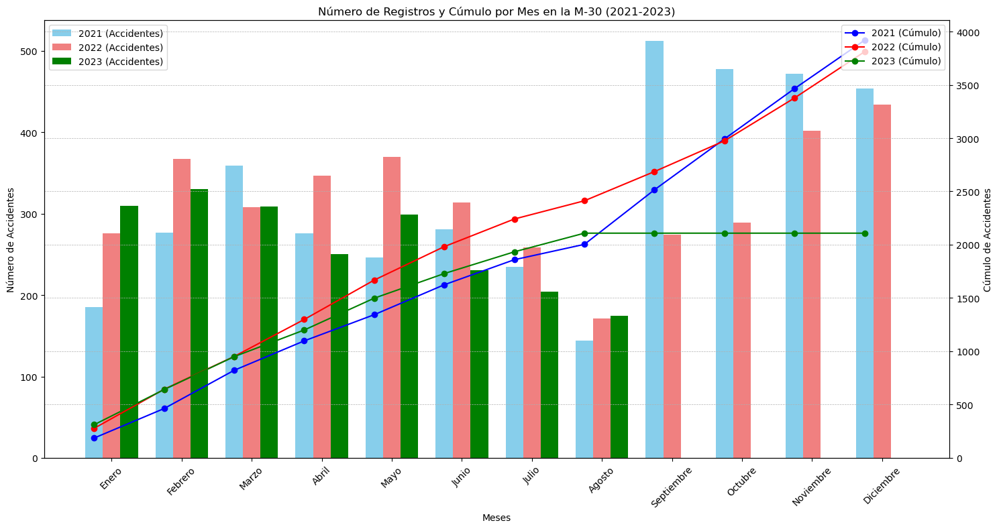

In [17]:
months = [
    "Enero", "Febrero", "Marzo", "Abril", "Mayo", "Junio",
    "Julio", "Agosto", "Septiembre", "Octubre", "Noviembre", "Diciembre"
]

accidents_2021 = [185, 277, 359, 276, 246, 281, 235, 144, 512, 478, 472, 454]
accidents_2022 = [276, 367, 308, 347, 370, 314, 259, 171, 274, 289, 402, 434]
accidents_2023 = [310, 330, 309, 250, 299, 231, 204, 175]
accidents_2023.extend([0] * (12 - len(accidents_2023)))
months_index = np.arange(len(months))

cumulative_accidents_2021 = np.cumsum(accidents_2021)
cumulative_accidents_2022 = np.cumsum(accidents_2022)
cumulative_accidents_2023 = np.cumsum(accidents_2023)

bar_width = 0.25  # Ancho de las barras
bar_positions_2021 = np.arange(len(months))
bar_positions_2022 = bar_positions_2021 + bar_width
bar_positions_2023 = bar_positions_2022 + bar_width

fig, ax1 = plt.subplots(figsize=(15, 8))

ax1.bar(bar_positions_2021, accidents_2021, width=bar_width, label='2021 (Accidentes)', color='skyblue')
ax1.bar(bar_positions_2022, accidents_2022, width=bar_width, label='2022 (Accidentes)', color='lightcoral')
ax1.bar(bar_positions_2023, accidents_2023, width=bar_width, label='2023 (Accidentes)', color='green')
ax1.set_xlabel('Meses')
ax1.set_ylabel('Número de Accidentes', color='black')
ax1.tick_params(axis='y', labelcolor='black')
ax1.set_xticks(bar_positions_2022)
ax1.set_xticklabels(months, rotation=45)
ax1.legend(loc='upper left')

ax2 = ax1.twinx()
ax2.plot(months_index, cumulative_accidents_2021, label='2021 (Cúmulo)', color='blue', marker='o')
ax2.plot(months_index, cumulative_accidents_2022, label='2022 (Cúmulo)', color='red', marker='o')
ax2.plot(months_index, cumulative_accidents_2023, label='2023 (Cúmulo)', color='green', marker='o')
ax2.set_ylabel('Cúmulo de Accidentes', color='black')
ax2.tick_params(axis='y', labelcolor='black')
ax2.legend(loc='upper right')

# Detalles adicionales
plt.title('Número de Registros y Cúmulo por Mes en la M-30 (2021-2023)')
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Mostrar el gráfico
plt.tight_layout()
plt.show()


In [18]:
resumen_2021 = m30_2021.groupby('tipo_accidente').count().reset_index().rename(columns={'num_expediente': '2021'})
resumen_2022 = m30_2022.groupby('tipo_accidente').count().reset_index().rename(columns={'num_expediente': '2022'})
resumen_2023 = m30_2023.groupby('tipo_accidente').count().reset_index().rename(columns={'num_expediente': '2023'})

# Fusionar los DataFrames de resumen en uno solo
comparativa = resumen_2021.merge(resumen_2022, on='tipo_accidente', how='outer').merge(resumen_2023,
                                                                                       on='tipo_accidente', how='outer')

# Ordenar por el año con más accidentes
comparativa = comparativa.sort_values(by=['2021', '2022', '2023'], ascending=False)

# Si deseas llenar los valores NaN con 0, puedes hacerlo así:
comparativa = comparativa.fillna(0)

In [19]:
comparativa = comparativa.filter(items=['tipo_accidente', '2021', '2022', '2023'])
comparativa

,tipo_accidente,2021,2022,2023
0,Alcance,1932.0,1838,1083
7,Colisión múltiple,818.0,688,351
6,Colisión lateral,451.0,537,273
3,Choque contra obstáculo fijo,251.0,279,140
5,Colisión fronto-lateral,155.0,145,90
2,Caída,138.0,127,81
4,Colisión frontal,89.0,77,28
10,Vuelco,28.0,37,21
8,Otro,26.0,36,22
9,Solo salida de la vía,18.0,25,16


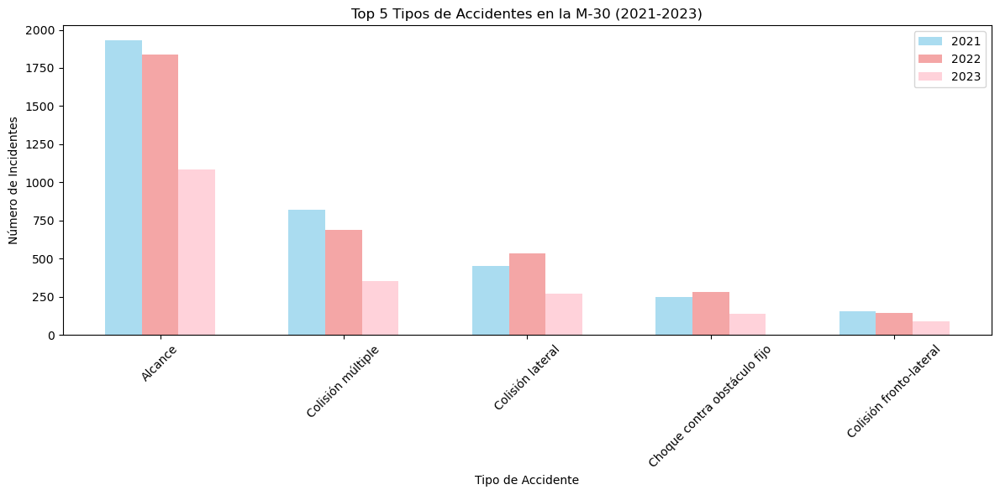

In [20]:
top_5_tipos_accidentes = comparativa.head(5)

# Crear el rango de posiciones en el eje x para las barras
x = np.arange(len(top_5_tipos_accidentes))

# Ancho de las barras
bar_width = 0.2

# Crear el gráfico de barras
plt.figure(figsize=(12, 6))
plt.bar(x - bar_width, top_5_tipos_accidentes['2021'], width=bar_width, label='2021', color='skyblue', alpha=0.7)
plt.bar(x, top_5_tipos_accidentes['2022'], width=bar_width, label='2022', color='lightcoral', alpha=0.7)
plt.bar(x + bar_width, top_5_tipos_accidentes['2023'], width=bar_width, label='2023', color='pink', alpha=0.7)

# Personalizar el gráfico
plt.xlabel('Tipo de Accidente')
plt.ylabel('Número de Incidentes')
plt.title('Top 5 Tipos de Accidentes en la M-30 (2021-2023)')
plt.xticks(x, top_5_tipos_accidentes['tipo_accidente'], rotation=45)
plt.legend()

# Mostrar el gráfico
plt.tight_layout()
plt.show()

Por lo tanto se puede afirmar con seguridad que se ha incrementado la seguridad en la carretera prohibiendo la circulación a vehículos más antiguos

## Análisis de tramos con mayor Índice de accidentes de la autovía M-30
A continuación haremos un estudio sobre los tramos con mayor cantidad de accidentes en la autovía M-30 para acercarnos algo a lo que puede ser el causante de este problema

In [21]:
# Filtrando data solo para la autov. M-30
m30_data = df_calles[df_calles['localizacion'].str.contains('M-30', na=False)].copy()

m30_data_head = m30_data.head()

m30_data_head

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado,first_word
27,2022S000013,2022-01-01,8:10:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Choque contra obstáculo fijo,Despejado,Turismo,...,H,NaN,NaN,"442679,507","4471637,799",1.0,0.0,1,No,AUTOV
35,2022S000018,2022-01-01,9:00:00,"AUTOV. M-30, +01100I PTO KM. 11,300 INTERIOR",+01100I,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,H,14.0,Sin asistencia sanitaria,"442366,272","4471296,603",0.0,0.0,2,No,AUTOV
36,2022S000018,2022-01-01,9:00:00,"AUTOV. M-30, +01100I PTO KM. 11,300 INTERIOR",+01100I,2.0,ARGANZUELA,Colisión fronto-lateral,Despejado,Turismo,...,M,1.0,Atención en urgencias sin posterior ingreso,"442366,272","4471296,603",0.0,0.0,2,No,AUTOV
66,2022S000032,2022-01-02,1:00:00,CALL. VADO / AUTOV. M-30,1,12.0,USERA,Choque contra obstáculo fijo,Despejado,Furgoneta,...,H,NaN,NaN,"440991,275","4470831,56",1.0,0.0,1,No,CALL
81,2022S000049,2022-01-01,7:10:00,"AUTOV. M-30, +00900E, 09XC",+00900E,14.0,MORATALAZ,Alcance,Despejado,Turismo,...,M,NaN,NaN,"443429,899","4472683,605",0.0,0.0,6,No,AUTOV


In [22]:
accident_counts = m30_data.groupby('localizacion').size().reset_index(name='accident_count')

additional_columns = ['tipo_accidente', 'estado_meteorológico', 'coordenada_x_utm', 'coordenada_y_utm']

additional_info = m30_data.groupby('localizacion')[additional_columns].first().reset_index()

top_accident_info = pd.merge(accident_counts, additional_info, on='localizacion', how='left')

top_accident_locations = top_accident_info.sort_values(by='accident_count', ascending=False).head(10)
top_accident_locations

,localizacion,accident_count,tipo_accidente,estado_meteorológico,coordenada_x_utm,coordenada_y_utm
405,"AUTOV. M-30, +01100I",63,Choque contra obstáculo fijo,Despejado,"442679,507","4471637,799"
328,"AUTOV. M-30, +00800I",61,Alcance,Despejado,"443954,517","4474063,076"
372,"AUTOV. M-30, +01000E",54,Vuelco,Despejado,"443556,356","4472880,784"
381,"AUTOV. M-30, +01000I",41,Caída,Lluvia débil,"443097,502","4472044,115"
598,"AUTOV. M-30, +03200E",38,Colisión fronto-lateral,Despejado,"442769,131","4481836,124"
3,AUTOV. A-2 / AUTOV. M-30,34,Caída,Despejado,"444211,308","4477442,411"
192,"AUTOV. M-30, +00100E",29,Colisión múltiple,Despejado,"442904,278","4481407,411"
423,"AUTOV. M-30, +01200E",28,Alcance,Despejado,"441998,16","4470507,066"
295,"AUTOV. M-30, +00700I",28,Colisión lateral,Despejado,"444038,325","4474935,567"
1709,CALL. ALCALA / AUTOV. M-30,26,Colisión lateral,Despejado,"443995,675","4475868,352"


Los tramos de la M-30 con el mayor número de accidentes son:

1. AUTOV. M-30, +01100I con 63 accidentes.
2. AUTOV. M-30, +00800I con 61 accidentes.
3. AUTOV. M-30, +01000E con 54 accidentes.
4. AUTOV. M-30, +01000I con 41 accidentes.
5. AUTOV. M-30, +03200E con 38 accidentes.
6. AUTOV. A-2 / AUTOV. M-30 con 34 accidentes.
7. AUTOV. M-30, +00100E con 29 accidentes.
8. AUTOV. M-30, +01200E con 28 accidentes.
9. AUTOV. M-30, +00700I con 28 accidentes.
10. CALL. ALCALA / AUTOV. M-30 con 26 accidentes.

#### Aplicando modas para 'tipo_accidente' y 'estado_meteorologico'
Para obtener mayor información aplicamos las modas de los tipos de accidentes y los estados meteorológicos en cada localidad. De esta manera nos dara el valor que más se repitió

In [23]:
top_locations = [
    'AUTOV. M-30, +01100I',
    'AUTOV. M-30, +00800I',
    'AUTOV. M-30, +01000E',
    'AUTOV. M-30, +01000I',
    'AUTOV. M-30, +03200E',
    'AUTOV. A-2 / AUTOV. M-30',
    'AUTOV. M-30, +00100E',
    'AUTOV. M-30, +01200E',
    'AUTOV. M-30, +00700I',
    'CALL. ALCALA / AUTOV. M-30'
]

top_m30_data = m30_data[m30_data['localizacion'].isin(top_locations)]

# Agrupa por 'localizacion' y encuentra la moda para 'tipo_accidente' y 'estado_meteorológico'
modes = top_m30_data.groupby('localizacion').agg(
    {'tipo_accidente': pd.Series.mode, 'estado_meteorológico': pd.Series.mode}).reset_index()

# Une la información de moda con el DataFrame 'top_accident_locations'
top_accident_locations_with_modes = pd.merge(
    top_accident_locations,
    modes,
    on='localizacion',
    how='left',
    suffixes=('', '_mode')
)

# El DataFrame 'top_accident_locations_with_modes' ahora tiene una sola columna para cada atributo
top_accident_locations_with_modes = top_accident_locations_with_modes.drop(
    columns=['tipo_accidente_mode', 'estado_meteorológico_mode'])

top_accident_locations_with_modes

,localizacion,accident_count,tipo_accidente,estado_meteorológico,coordenada_x_utm,coordenada_y_utm
0,"AUTOV. M-30, +01100I",63,Choque contra obstáculo fijo,Despejado,"442679,507","4471637,799"
1,"AUTOV. M-30, +00800I",61,Alcance,Despejado,"443954,517","4474063,076"
2,"AUTOV. M-30, +01000E",54,Vuelco,Despejado,"443556,356","4472880,784"
3,"AUTOV. M-30, +01000I",41,Caída,Lluvia débil,"443097,502","4472044,115"
4,"AUTOV. M-30, +03200E",38,Colisión fronto-lateral,Despejado,"442769,131","4481836,124"
5,AUTOV. A-2 / AUTOV. M-30,34,Caída,Despejado,"444211,308","4477442,411"
6,"AUTOV. M-30, +00100E",29,Colisión múltiple,Despejado,"442904,278","4481407,411"
7,"AUTOV. M-30, +01200E",28,Alcance,Despejado,"441998,16","4470507,066"
8,"AUTOV. M-30, +00700I",28,Colisión lateral,Despejado,"444038,325","4474935,567"
9,CALL. ALCALA / AUTOV. M-30,26,Colisión lateral,Despejado,"443995,675","4475868,352"


In [24]:
modes

,localizacion,tipo_accidente,estado_meteorológico
0,AUTOV. A-2 / AUTOV. M-30,Alcance,Despejado
1,"AUTOV. M-30, +00100E",Alcance,Despejado
2,"AUTOV. M-30, +00700I",Colisión múltiple,Despejado
3,"AUTOV. M-30, +00800I",Alcance,Despejado
4,"AUTOV. M-30, +01000E",Alcance,Despejado
5,"AUTOV. M-30, +01000I",Alcance,Despejado
6,"AUTOV. M-30, +01100I",Alcance,Despejado
7,"AUTOV. M-30, +01200E",Colisión múltiple,Despejado
8,"AUTOV. M-30, +03200E",Alcance,Despejado
9,CALL. ALCALA / AUTOV. M-30,"[Colisión fronto-lateral, Colisión lateral]",Despejado


In [25]:
top_m30_data.head()

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado,first_word
27,2022S000013,2022-01-01,8:10:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Choque contra obstáculo fijo,Despejado,Turismo,...,H,NaN,NaN,"442679,507","4471637,799",1.0,0.0,1,No,AUTOV
921,2022S000526,2022-01-11,16:15:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Colisión múltiple,Despejado,Motocicleta > 125cc,...,H,2.0,Ingreso inferior o igual a 24 horas,"442533,217","4471513,69",0.0,0.0,5,No,AUTOV
922,2022S000526,2022-01-11,16:15:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Colisión múltiple,Despejado,Motocicleta > 125cc,...,M,1.0,Atención en urgencias sin posterior ingreso,"442533,217","4471513,69",0.0,0.0,5,No,AUTOV
923,2022S000526,2022-01-11,16:15:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Colisión múltiple,Despejado,Turismo,...,H,14.0,Sin asistencia sanitaria,"442533,217","4471513,69",0.0,0.0,5,No,AUTOV
924,2022S000526,2022-01-11,16:15:00,"AUTOV. M-30, +01100I",+01100I,2.0,ARGANZUELA,Colisión múltiple,Despejado,Turismo,...,M,14.0,Sin asistencia sanitaria,"442533,217","4471513,69",0.0,0.0,5,No,AUTOV


In [26]:
top_accident_locations_with_modes['coordenada_x_utm'] = pd.to_numeric(
    top_accident_locations_with_modes['coordenada_x_utm'].str.replace(',', '.'), errors='coerce')
top_accident_locations_with_modes['coordenada_y_utm'] = pd.to_numeric(
    top_accident_locations_with_modes['coordenada_y_utm'].str.replace(',', '.'), errors='coerce')

In [27]:
from my_map_creator import MapCreator

mapa_M30 = MapCreator(top_accident_locations_with_modes, lat_col_name="coordenada_x_utm",
                      long_col_name="coordenada_y_utm")

In [28]:
mapa_M30.set_columns_for_label(['localizacion', 'accident_count', 'tipo_accidente', 'estado_meteorológico'])
mapa_M30.create_map(map_name="mapa_M30")

Vamos a desglosar los accidentes en cada sección con más accidentes para saber qué es lo que suele pasar

In [44]:
def visualizador_accidentes(df0: pd.DataFrame, location: str):
    df0 = df0[df0['localizacion'] == location]
    df0['coordenada_x_utm'] = pd.to_numeric(
        df0['coordenada_x_utm'].str.replace(',', '.'), errors='coerce')
    df0['coordenada_y_utm'] = pd.to_numeric(
        df0['coordenada_y_utm'].str.replace(',', '.'), errors='coerce')

    # Sacamos uno para poder encontrarlo en maps
    print(df0.groupby('tipo_accidente').count().reset_index().filter(items=['tipo_accidente', 'num_expediente']))
    lat, long = utm_to_latlon(df0['coordenada_x_utm'].head(1), df0['coordenada_y_utm'].head(1))
    print(str(lat), str(long))

    df0['hora'] = pd.to_datetime(df0['hora'])

    # Crea un nuevo DataFrame con las horas agrupadas en intervalos de 1 hora
    df_grouped = df0.groupby(df0['hora'].dt.hour).count()
    df_grouped.index = df_grouped.index.map(lambda x: f"{x:02d}:00-{x+1:02d}:00")

    # Crea un gráfico de barras para mostrar la distribución
    plt.bar(df_grouped.index, df_grouped['hora'])
    plt.xlabel('Intervalo de Horas')
    plt.ylabel('Cantidad')
    plt.title('Distribución de Horas en Intervalos de 1 Hora')
    plt.xticks(rotation=45)
    plt.show()

    mapa = MapCreator(df0, lat_col_name='coordenada_x_utm', long_col_name='coordenada_y_utm')
    mapa.set_columns_for_label(['estado_meteorológico', 'tipo_accidente'])
    mapa.create_map(map_name=location)

def display_img(file_path):
    imagen = Image.open(file_path)
    display(imagen)

### 'AUTOV. M-30, +01100I'

                 tipo_accidente  num_expediente
0                       Alcance              48
1  Choque contra obstáculo fijo               4
2             Colisión múltiple              11
27    40.393369
dtype: float64 27   -3.675406
dtype: float64


/tmp/ipykernel_72054/1764417802.py:18: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df0['hora'] = pd.to_datetime(df0['hora'])


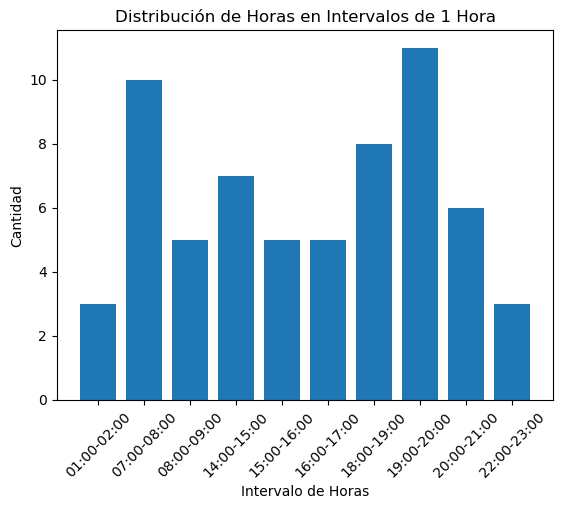

In [45]:
visualizador_accidentes(top_m30_data.copy(), 'AUTOV. M-30, +01100I')

ValueError: Could not save to JPEG for display

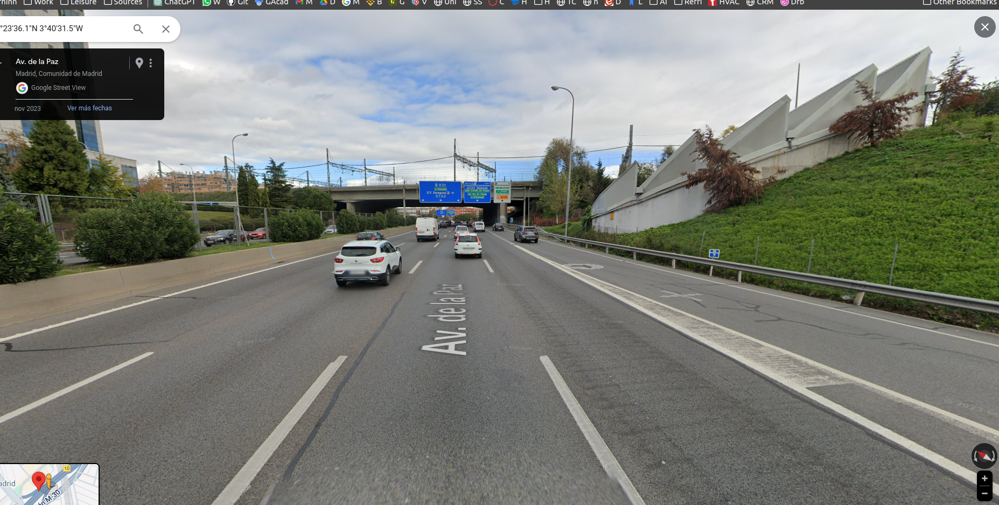

In [32]:
display_img("img/'AUTOV. M-30, +01100I'SALIDA_PT_VALLECAS.png")

ValueError: Could not save to JPEG for display

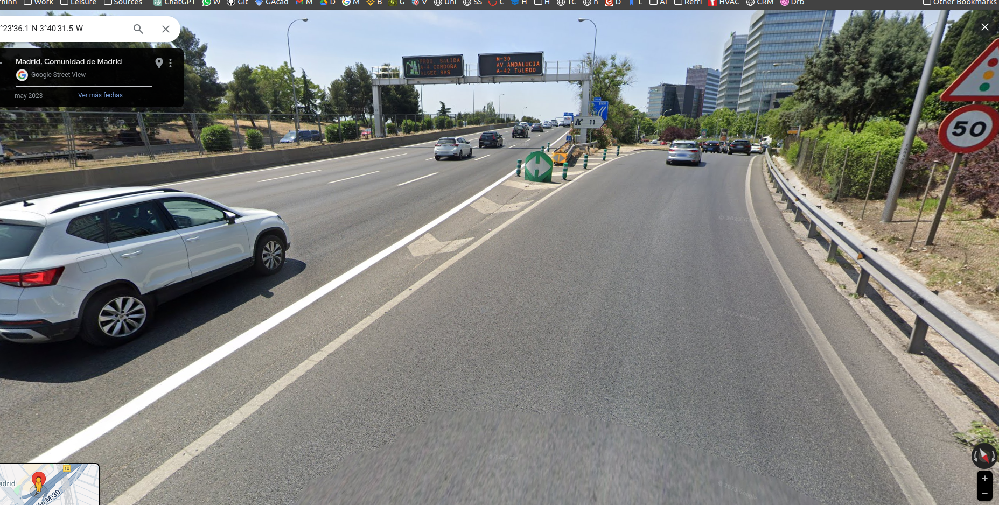

In [37]:
display_img("img/'AUTOV. M-30, +01100I'SALIDA_MNDZ_ALVARO.png")

ValueError: Could not save to JPEG for display

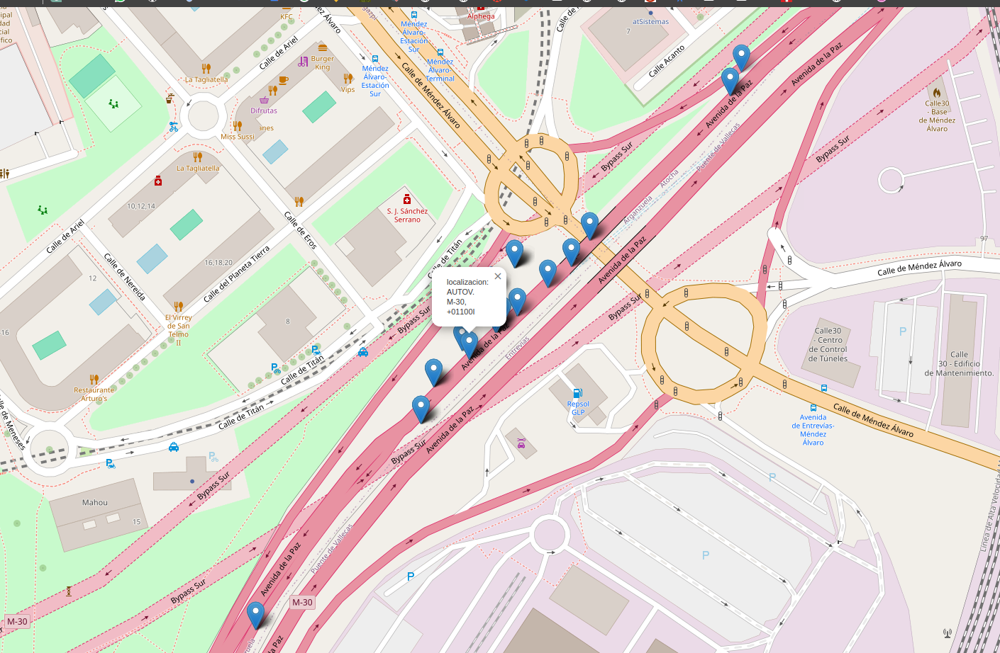

In [38]:
display_img("img/'AUTOV. M-30, +01100I'OVERVIEW.png")

El número de alcances parece que se debe a un trenzado La salida suele estar congestionada en las horas en las que se han dado la mayoría de los accidentes, que es sobre las 8 de la mañana y las, de 14 a 16, y de 18 a 20.
Son horas que coinciden con la entrada y salida.

En el sentido de la salida de Mendez Álvaro no hay ningún accidente, como se puede observar en el mapa.

En el otro sentido, tenemos un trenzado. Pues existe justo una entrada de coches a la vez que una salida. Los coches al intentar incorporarse y salir realizan maniobras simultáneas, aumentado el riesgo de alcance si no se presta atención.
Se recomienda colocar la nueva señal de peligro trenzado.
No se recomienda colocar radar en ninguna de las dos direcciones, ya que los accidentes ocurren en las horas más congestionadas

### AUTOV. M-30, +00800I


                 tipo_accidente  num_expediente
0                       Alcance              43
1                         Caída               1
2  Choque contra obstáculo fijo               1
3              Colisión frontal               4
4             Colisión múltiple              12
4779    40.415304
dtype: float64 4779   -3.660597
dtype: float64


/tmp/ipykernel_72054/1764417802.py:18: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df0['hora'] = pd.to_datetime(df0['hora'])


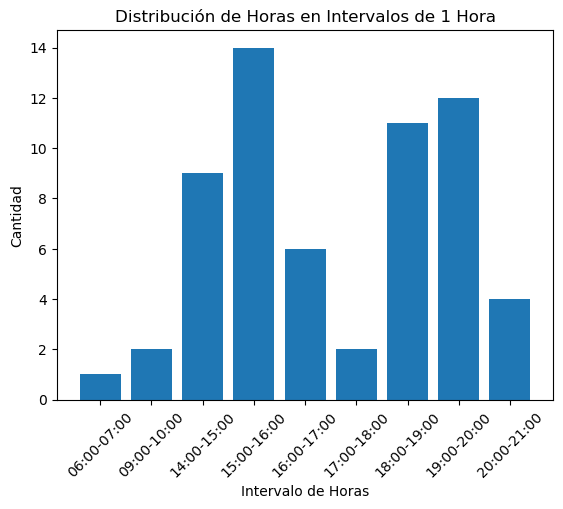

In [46]:
visualizador_accidentes(top_m30_data.copy(), 'AUTOV. M-30, +00800I')

ValueError: Could not save to JPEG for display

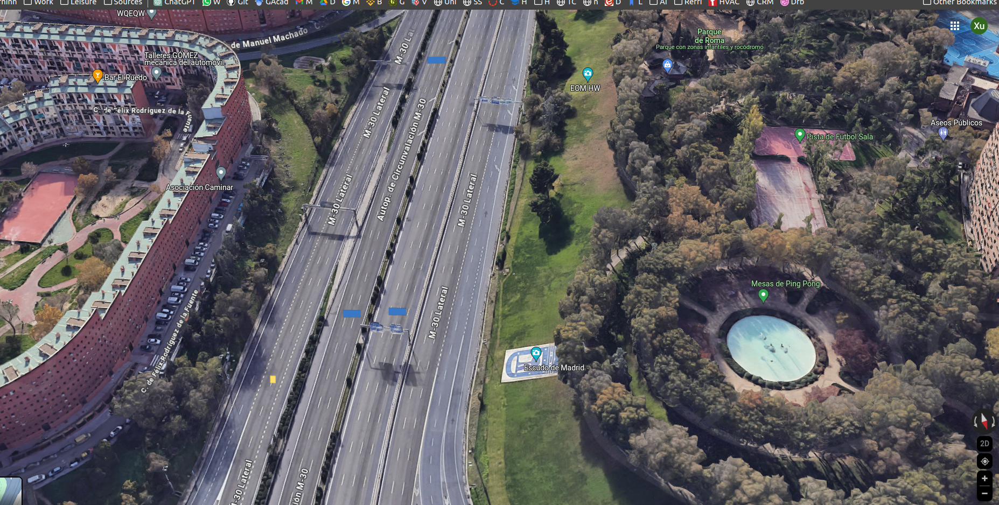

In [41]:
display_img("img/'AUTOV. M-30, +00800I'OVERVIEW.png")

En esta situación no existe un trenzado pero sí una doble incorporación con doble reducción de carril derecho.

ValueError: Could not save to JPEG for display

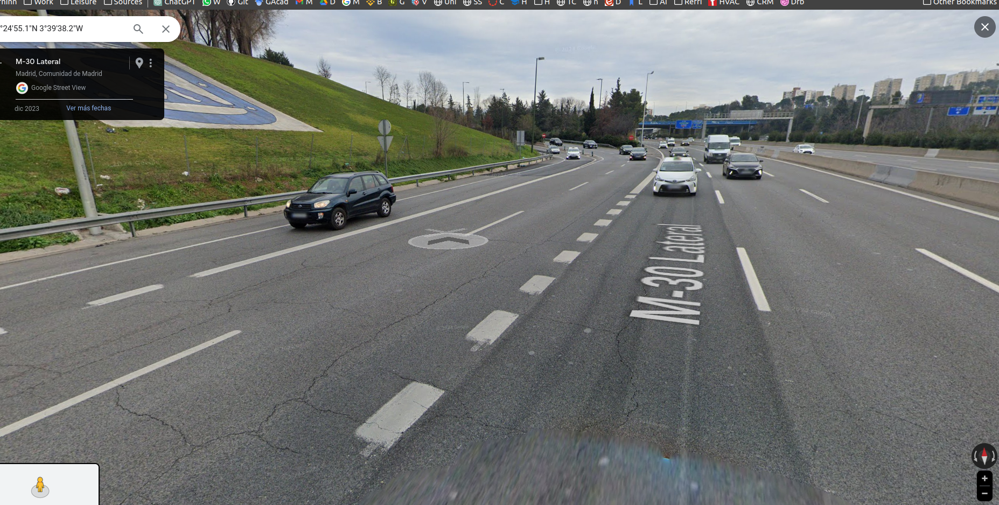

In [40]:
display_img("img/'AUTOV. M-30, +00800I'DOBLE_INCORPORACION.png")

Tras revisar los alrededores, puedo concluir que está debidamente señalizada. La zona marca una velocidad límite de 90. Sin embargo, las dos incorporaciones provienen de curvas muy cerradas, esto causa una diferencia de velocidad importante, lo cual entorpece la incorporación de vehículos.
En la siguiente imagen, pueden observar que existe poco margen entre la primera reducción de carril, y el primer momento en que se permite la incorporación de vehículos desde el segundo carril. Creo que esa es la causa de los alcances.

La mayoría ocurren a las horas 14-16 (salida de trabajadores) y las 18-20, donde suele haber congestión. NO hay tantos accidentes por la mañana pues se trata de una incorporación desde el centro en dirección las afueras de Madrid.

En un inicio pensamos que igual era buena idea reducir la velocidad de los vehículos en la vía principal para reducir la diferencia de velocidad entre los que se incorporan y los que circulan, pero la evidencia muestra lo contrario

ValueError: Could not save to JPEG for display

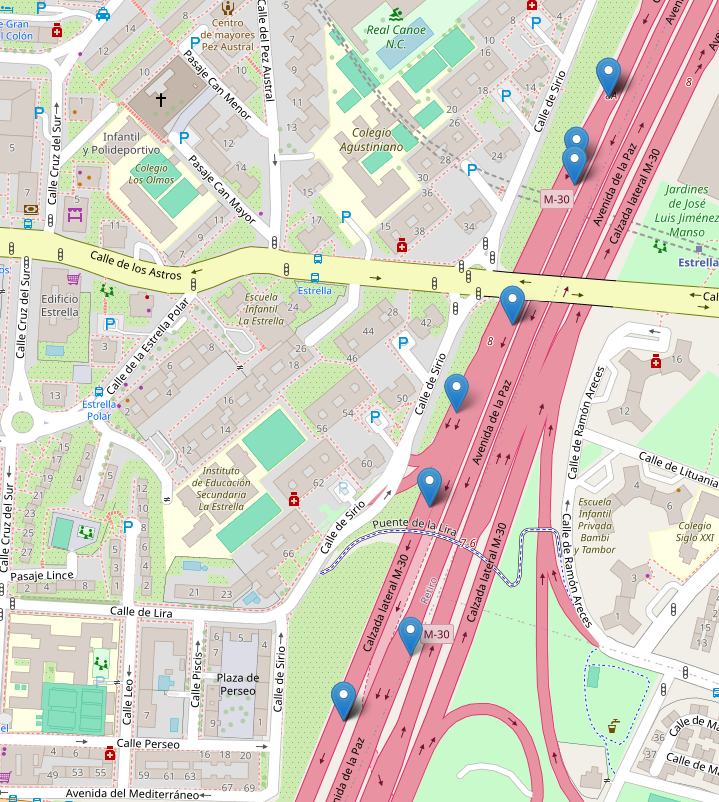

In [42]:
display_img("img/'AUTOV. M-30, +00800I'OVERVIEW_B.png")

Los accidentes ocurren en todos en la otra dirección de la m30. Veamos qué ocurre

ValueError: Could not save to JPEG for display

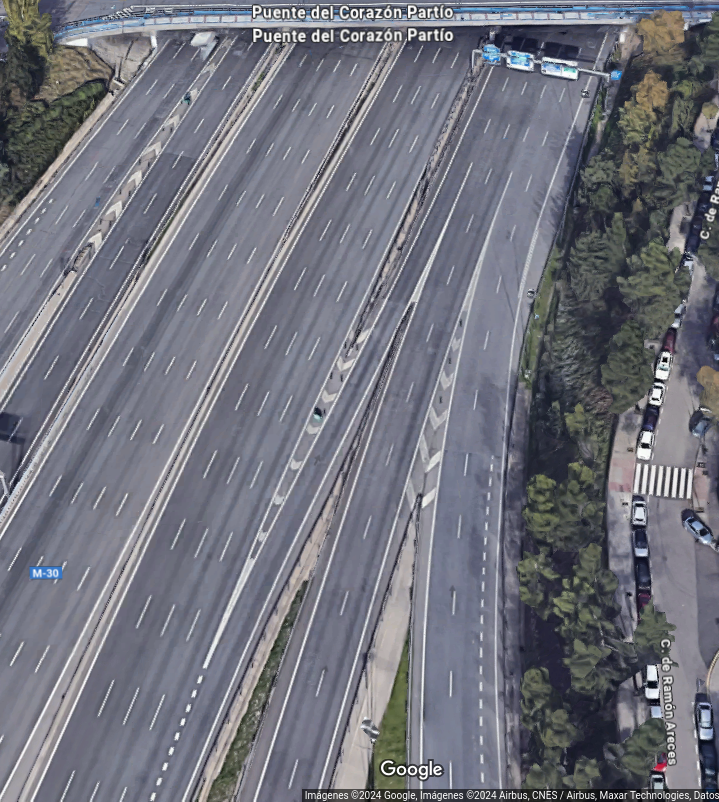

In [43]:
display_img("img/AUTOV. M-30, +00800I Acceso Triple.png")

Ocurre que existe esta triple intersección existe un cúmulo de colisiones por alcance:

ValueError: Could not save to JPEG for display

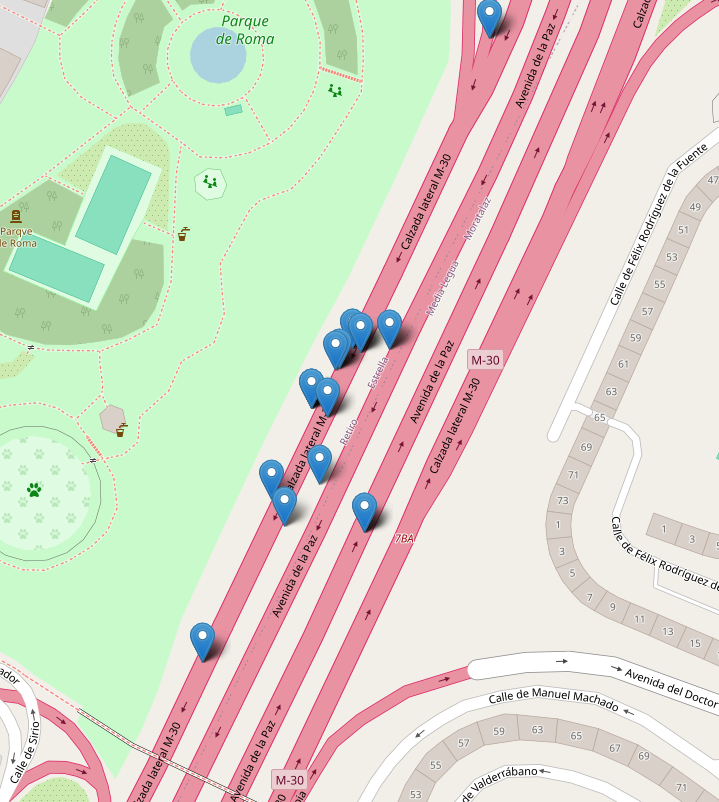

In [47]:
display_img("img/AUTOV. M-30, +00800I Multiple Alcance.png")

Estos alcances pueden deberse a los cambios de carril que se realizan para intentar tomar una salida a una zona residencial.

El problema es exacerbado con otra incorporación antes de una salida, y deja un rastro de colisiones por alcance justo después. Como podemos observar, ni en la m30 central ni en la otra dirección existen accidentes tan numerosos de este tipo, por lo que podemos concluir con confianza, de que el problema es la suma de la triple intersección con una incorporación extra antes de tomar la rampa de salida a una zona residencial (Moratalaz), salida 8, o a coger una de las dos salidas que van hacia la calle O'Donnel (muy transitada) salida 9B, o M23 hacia vicálvaro, dirección M40 norte y sur.

Las horas de los accidentes también concuerdan pues no son horas de salida sino de entrada (14-16, 18-20). Y durante las horas de la mañana, se presentan un número de accidentes mínimo.

Aquí sí que puede ser interesante colocar un nuevo radar para uniformizar las velocidades y evitar colisiones por alcance, pues tenemos a los que acaban de llegar de una rampa (lentos) con los que cogen una salida (vel moderada) y los que van en la misma vía (90km/h)

También recomendamos colocar una señal que recuerde mantener la distancia de seguridad.

Si no se quiere poner radar se recomienda colocar una linea continua para evitar los desplazamientos de carril

### "AUTOV. M-30, +01000E"

                 tipo_accidente  num_expediente
0                       Alcance              46
1                         Caída               2
2  Choque contra obstáculo fijo               1
3       Colisión fronto-lateral               2
4              Colisión lateral               2
5                        Vuelco               1
3054    40.404627
dtype: float64 3054   -3.665185
dtype: float64


/tmp/ipykernel_72054/1764417802.py:18: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df0['hora'] = pd.to_datetime(df0['hora'])


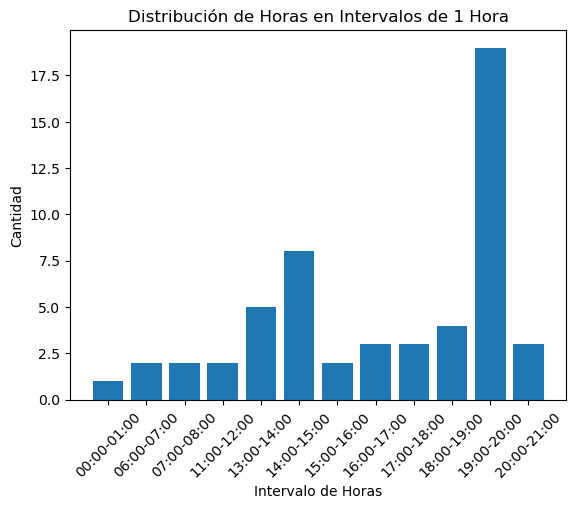

In [48]:
visualizador_accidentes(top_m30_data.copy(), "AUTOV. M-30, +01000E")

ValueError: Could not save to JPEG for display

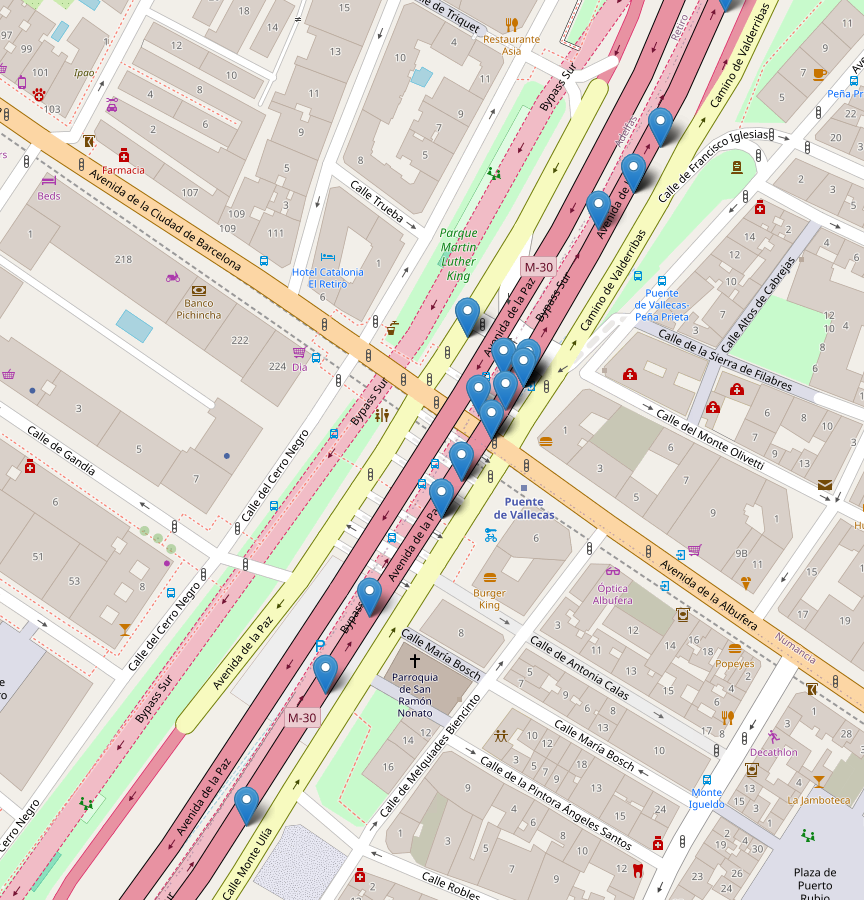

In [49]:
display_img("img/AUTOV. M-30, +01000E OVERVIEW.png")

La concentración de accidentes en una hora determinada concuerda con la idea de que las autopistas suelen ser de salida de un barrio o de llegada de un barrio. Veamos en detalle cuales son los factores que están causando estos accidentes

ValueError: Could not save to JPEG for display

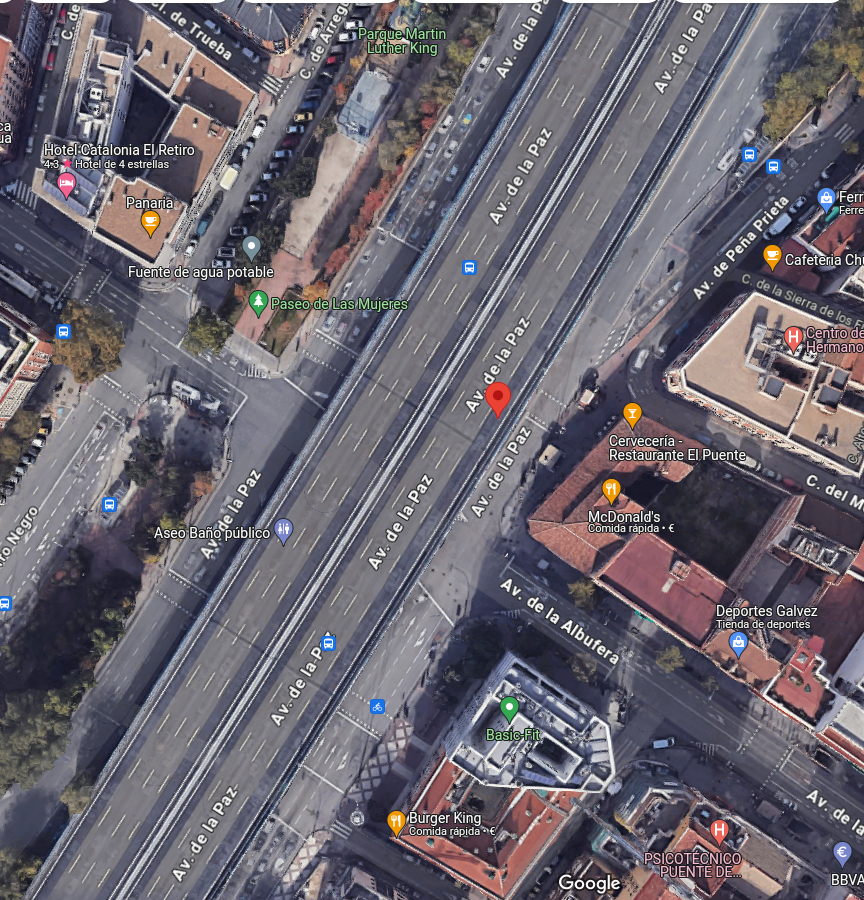

In [52]:
display_img("img/AUTOV. M-30, +01000E OVERVIEW Google.png")

La localización es el puente de la m30 sobre la avenida de la Albufera. El único hecho reseñable que podría causar tanta cantidad de accidentes es esta salida hacia plaz. Conde de Casal, A3-Valencia, Calle O'Donnell y Avenida Dr. García tapia. 4 localizaciones IMPORTANTES distintas que requieren de una única salida, y de la que no se dispone vía alternativa para llegar, excepto para av. Dr García tapia, que comentaremos más adelante, pues creemos que guarda clara relación con el top 2 (anterior) de nuestra lista. Claramente podemos observar un cuello de botella

ValueError: Could not save to JPEG for display

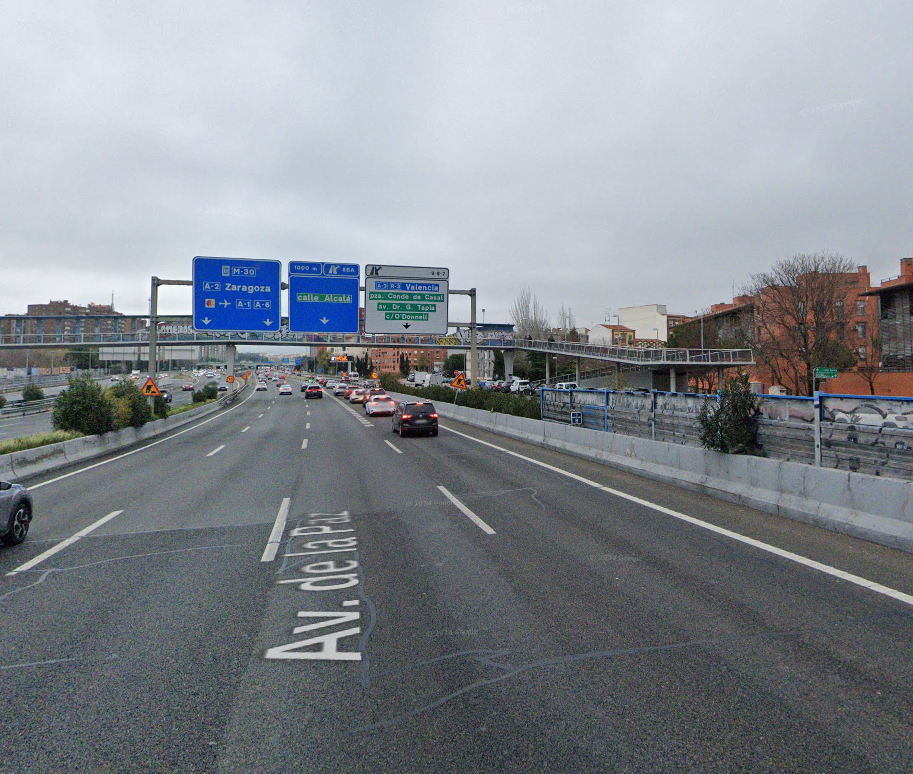

In [55]:
display_img("img/AUTOV. M-30, +01000E Salida 9-8-7.png")

Además, esta incorporación se suma con el tráfico existente que sale desde Vallecas

ValueError: Could not save to JPEG for display

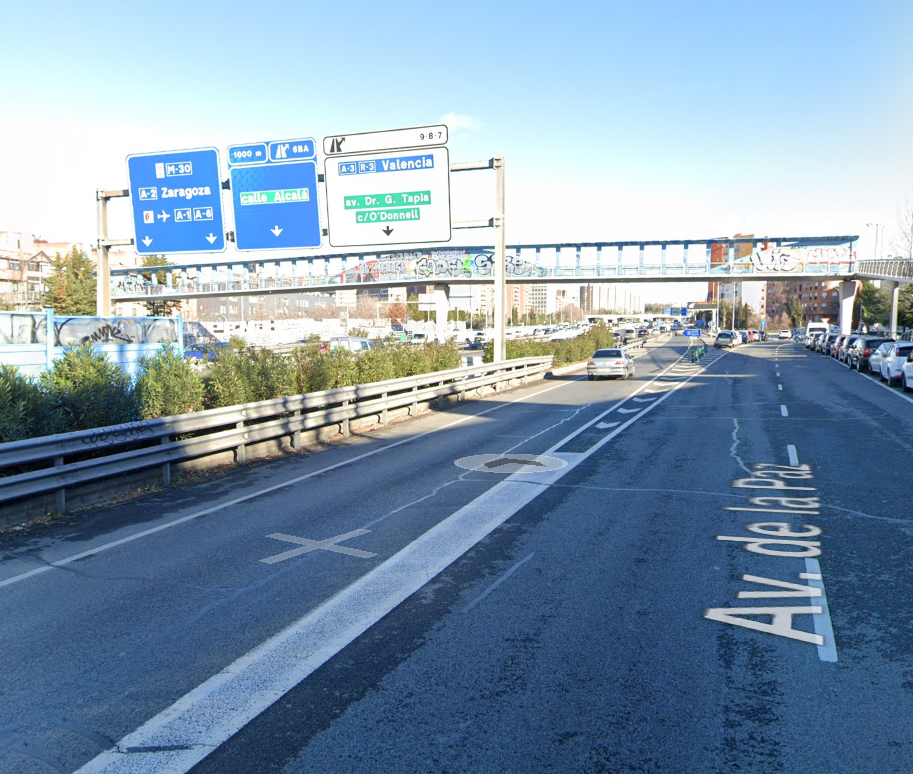

In [56]:
display_img("img/AUTOV. M-30, +01000E Salida 9-8-7 Acceso Vallecas.png")

Está claro que este exceso de volumen de vehículos en hora punta va a causar retenciones en la hora punta, que es cuando algunos usuarios pueden decidir colarse en la cola o disminuir mucho su velocidad. Todo ello contribuye al aumento en el número de colisiones por alcance.

Curiosamente, este cuello de botella también afecta a la accidentalidad de la salida posterior, como comentaba antes, y es que la salida doctor garcía tapia puede cogerse desde la M30 central más adelante. Observe la siguientes dos imágenes.

ValueError: Could not save to JPEG for display

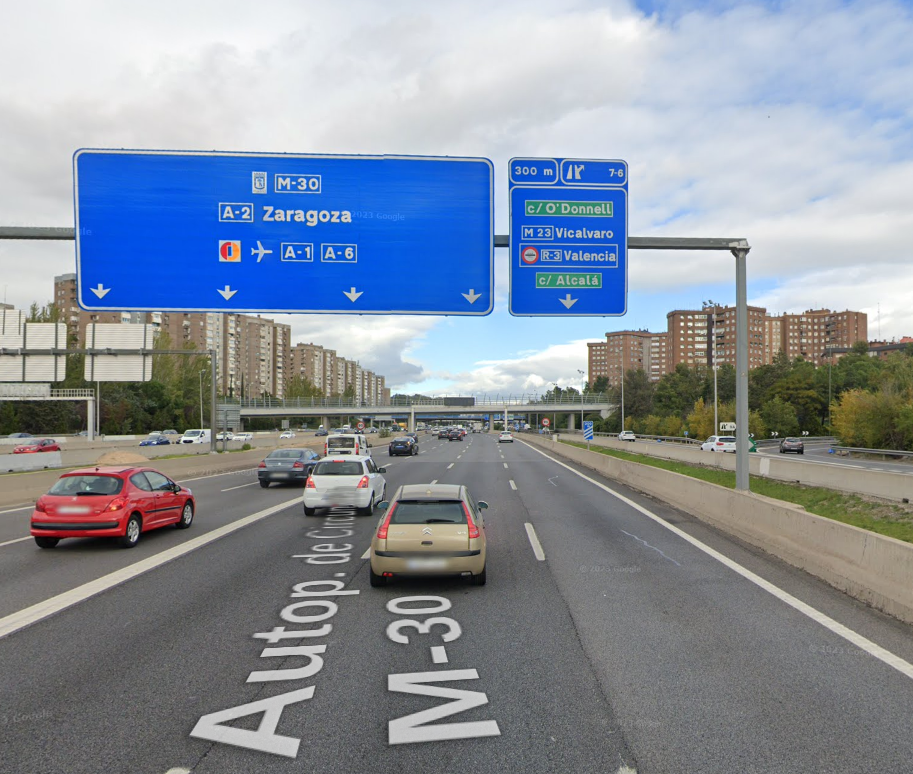

ValueError: Could not save to JPEG for display

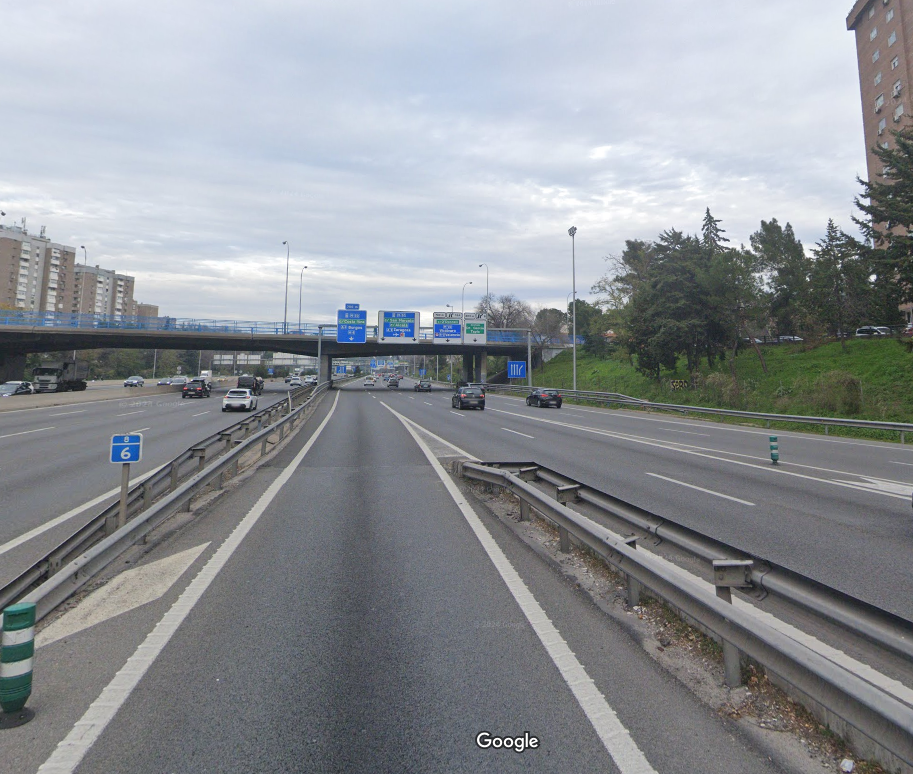

In [59]:
display_img("img/AUTOV. M-30, +00800I INCORPORACION MULTIPLE Google.png")
display_img("img/AUTOV. M-30, +00800I INCORPORACION MULTIPLE Google 2.png")

Como puede observarse, volvemos al punto caliente del comentario anterior AUTOV. M-30, +00800I INCORPORACION MULTIPLE.
Está claro que no es el uso intencionado de la vía permitir (pues no lo marca la señal) el acceso a la avenida Dr. García tapia desde aquí, ya que existen escasos 500m pra cruzar 4 carriles que en hora punta puede estar bastante saturado.

Es decir, la retención en el puente para la salida de Avenida dr garcía tapia intenciondad puede estar causando accidentes más adelante, en este triple merge.

Las recomendaciones para este punto caliente ya están mencionadas, pero cabe recordar una de ella, la de la línea continua. Esto puede evitar colisiones frontales al prohibir el desplazamiento lateral hasta más adelante, cuando más vehículos estén en su carril deseado, sobretodo para evitar que se tome la salida 9

En cuanto al puente, al ser un problema causado por la retención por un cuello de botella no es lógico aplicar un radar. Tampoco hay muchas opciones alternativas ya que es un problema de la infraestructura en sí y de los conductores irresponsables que se intentan saltar la fila.

Quizás pueda ser una solución colocar cámaras para facilitar la resolución de conflictos o endurecer las sanciones por circular a velocidades anormalmente reducidas

# "AUTOV. M-30, +01000I"


      tipo_accidente  num_expediente
0            Alcance              29
1              Caída               1
2   Colisión frontal               2
3  Colisión múltiple               8
4               Otro               1
7439    40.397058
dtype: float64 7439   -3.670518
dtype: float64


/tmp/ipykernel_72054/1764417802.py:18: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df0['hora'] = pd.to_datetime(df0['hora'])


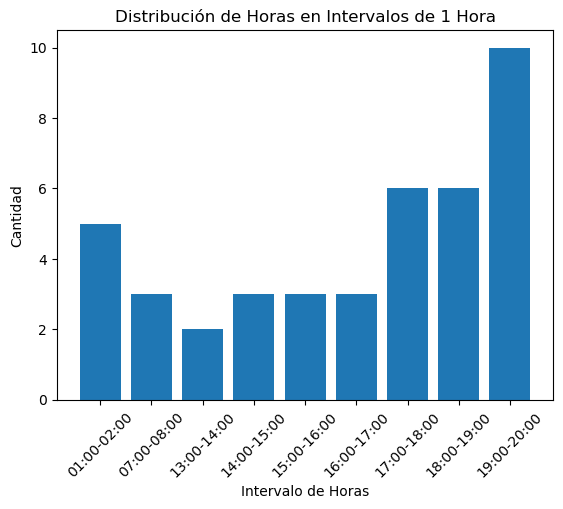

In [61]:
visualizador_accidentes(top_m30_data.copy(),"AUTOV. M-30, +01000I")

Aquí vemos una zona más propensa a accidentes por la noche. Veamos qué sucede

ValueError: Could not save to JPEG for display

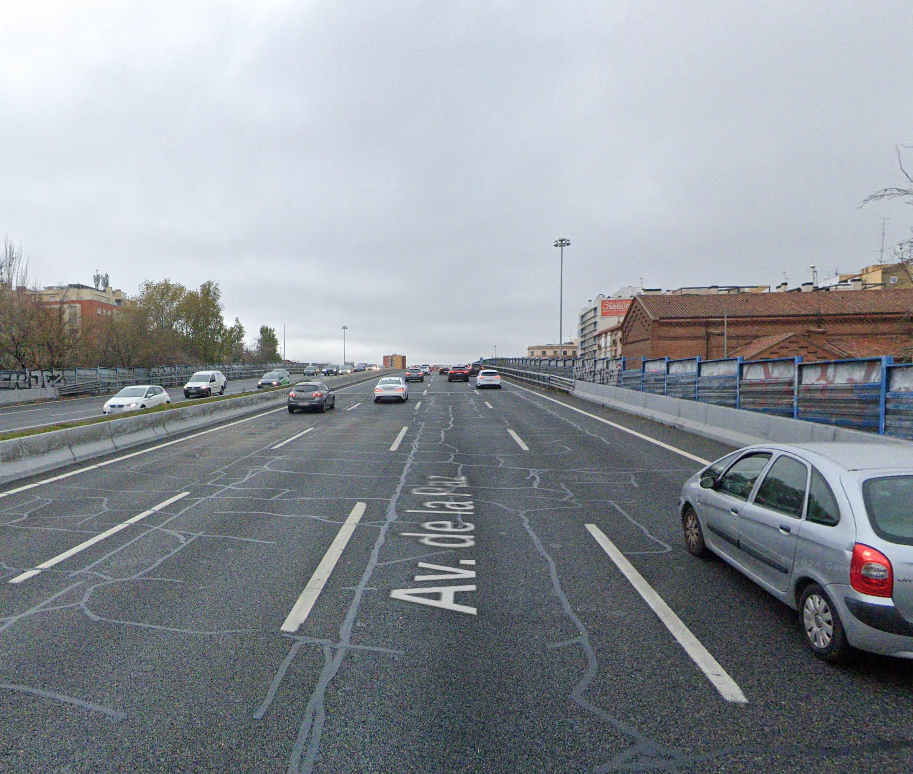

In [62]:
display_img("img/AUTOV. M-30, +01000I GOOGLE.png")

Es el mismo puente que ya comentamos antes. Al parecer la cola se extiende cuando atardece y los accidentes se propagan hasta más atrás.

# "AUTOV. M-30, +03200E"

                 tipo_accidente  num_expediente
0                       Alcance              17
1  Choque contra obstáculo fijo               4
2       Colisión fronto-lateral               3
3              Colisión lateral               2
4             Colisión múltiple              10
5                          Otro               1
6         Solo salida de la vía               1
2872    40.485247
dtype: float64 2872   -3.675269
dtype: float64


/tmp/ipykernel_72054/1764417802.py:18: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df0['hora'] = pd.to_datetime(df0['hora'])


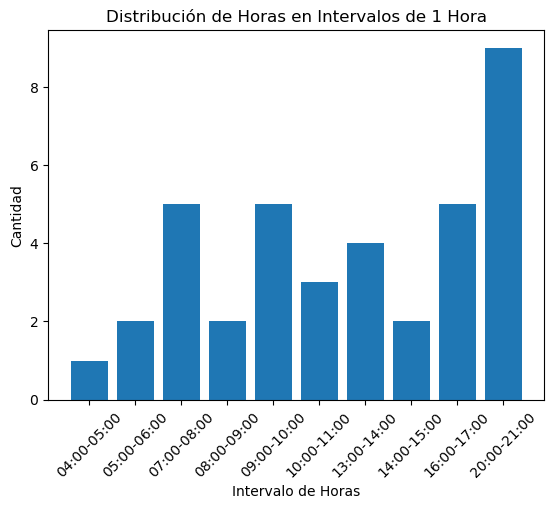

In [63]:
visualizador_accidentes(top_m30_data.copy(), "AUTOV. M-30, +03200E")

Vemos aquí un montón de colisiones múltiples. Conviene desglosar el accidente para intuir qué puede haber ocurrido. También es inusual el choque contra 4 obstáculos fijos.

In [64]:
top_m30_data[top_m30_data['localizacion'] == "AUTOV. M-30, +03200E"]

,num_expediente,fecha,hora,localizacion,numero,cod_distrito,distrito,tipo_accidente,estado_meteorológico,tipo_vehiculo,...,sexo,cod_lesividad,lesividad,coordenada_x_utm,coordenada_y_utm,positiva_alcohol,positiva_droga,numero_pasajeros,fugado,first_word
2872,2022S001820,2022-01-27,10:30:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión fronto-lateral,Despejado,Todo terreno,...,H,14.0,Sin asistencia sanitaria,"442769,131","4481836,124",0.0,0.0,3,No,AUTOV
2873,2022S001820,2022-01-27,10:30:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión fronto-lateral,Despejado,Turismo,...,H,NaN,NaN,"442769,131","4481836,124",0.0,0.0,3,No,AUTOV
2874,2022S001820,2022-01-27,10:30:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión fronto-lateral,Despejado,Turismo,...,M,14.0,Sin asistencia sanitaria,"442769,131","4481836,124",0.0,0.0,3,No,AUTOV
11989,2022S009758,2022-04-08,16:20:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión múltiple,Despejado,Turismo,...,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"442830,272","4481705,977",0.0,0.0,3,No,AUTOV
11990,2022S009758,2022-04-08,16:20:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión múltiple,Despejado,Turismo,...,H,14.0,Sin asistencia sanitaria,"442830,272","4481705,977",0.0,0.0,3,No,AUTOV
11991,2022S009758,2022-04-08,16:20:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión múltiple,Despejado,Turismo,...,H,14.0,Sin asistencia sanitaria,"442830,272","4481705,977",0.0,0.0,3,No,AUTOV
12376,2022S010294,2022-04-11,8:47:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Alcance,Despejado,Motocicleta > 125cc,...,H,NaN,NaN,"442292,754","4481636,065",0.0,0.0,2,No,AUTOV
12377,2022S010294,2022-04-11,8:47:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Alcance,Despejado,Turismo,...,M,NaN,NaN,"442292,754","4481636,065",0.0,0.0,2,No,AUTOV
14863,2022S013062,2022-05-01,13:39:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión múltiple,Despejado,Turismo,...,M,14.0,Sin asistencia sanitaria,"442651,472","4481700,235",0.0,0.0,4,No,AUTOV
14864,2022S013062,2022-05-01,13:39:00,"AUTOV. M-30, +03200E",+03200E,8.0,FUENCARRAL-EL PARDO,Colisión múltiple,Despejado,Turismo,...,H,7.0,Asistencia sanitaria sólo en el lugar del acci...,"442651,472","4481700,235",0.0,0.0,4,No,AUTOV


Queda verificado que son diferentes colisiones múltiples, veamos qué puede haber causado este número inusual de colisiones múltiples

ValueError: Could not save to JPEG for display

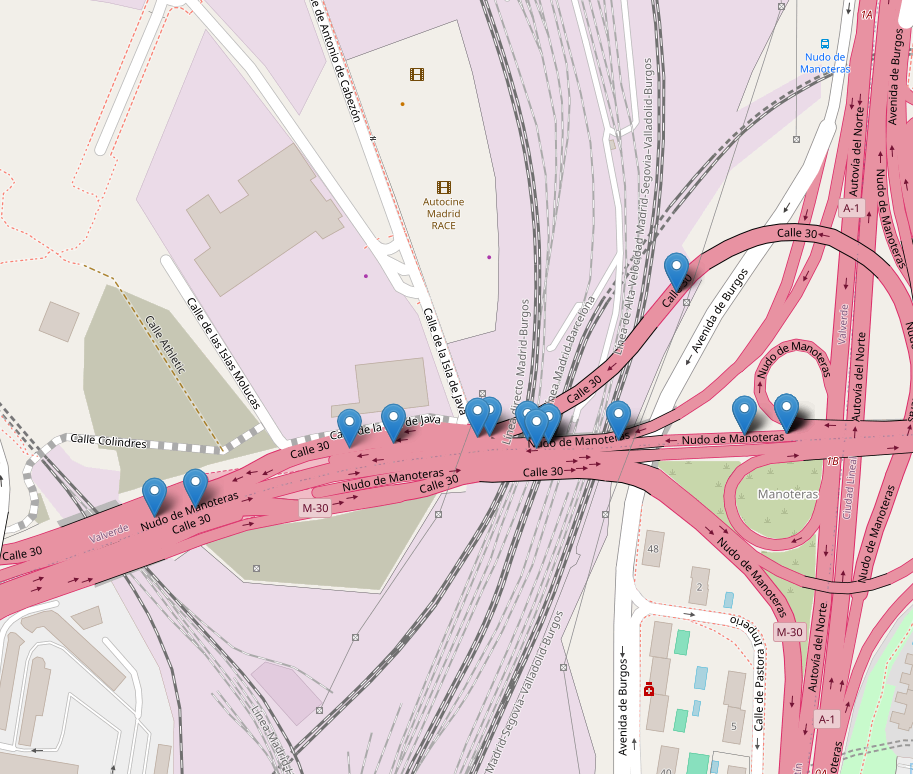

In [65]:
display_img("img/AUTOV. M-30, +03200E OVERVIEW.png")

Parece que los accidentes se centran en una sola dirección

ValueError: Could not save to JPEG for display

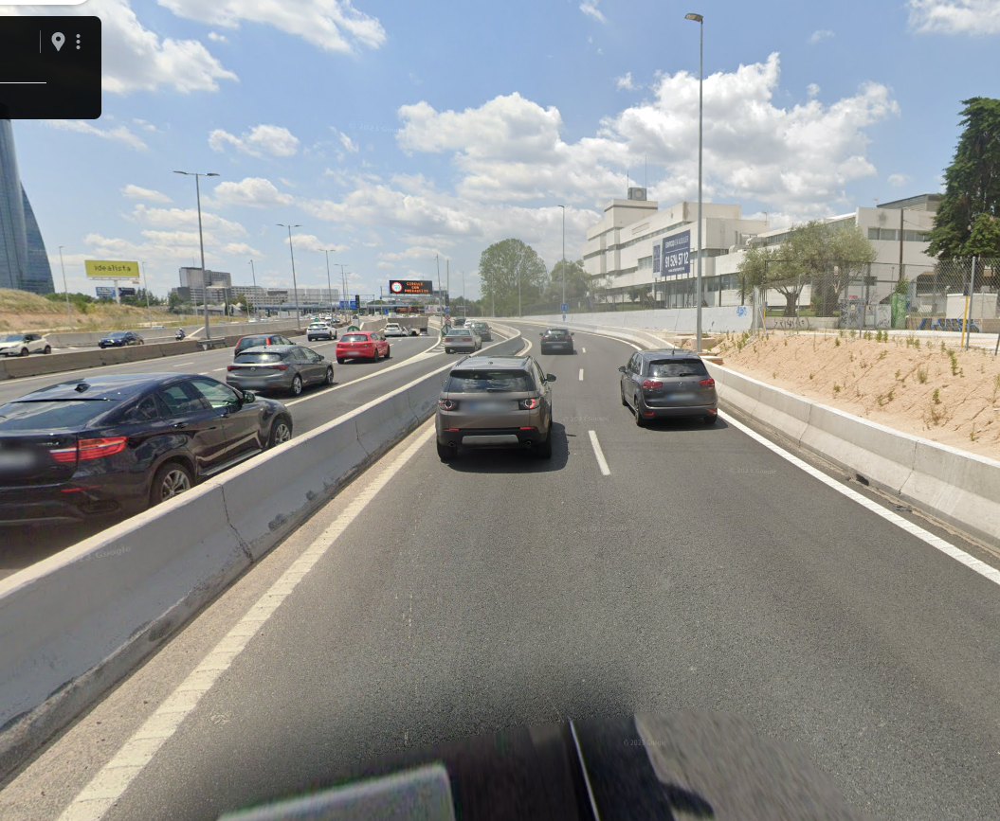

In [66]:
display_img("img/AUTOV. M-30, +03200E DIR-AV ILUSTRACION.png")

El exceso de colisiones múltiples en esta zona se puede deber a un cúmulo de factores. En primer lugar, en la vía más a la derecha, existe una sucesión de curvas peligrosas de radio bastante cortas después de cruzar el puente, a lo que hay que sumarle que la vía tiene unos arcenes estrechos por los separadores de cemento.

La velocidad de acceso al puente es de 60 con señal advirtiendo de curva peligrosa, sin embargo, no existe ningún recordatorio del riesgo de curva peligrosa al final del puente. Lo que puede llevar a los conductores a pensar que se ha acabado el peligro de curva peligrosa, aunque eso no sea cierto, eso causa frenazos y por consiguiente colisiones por alcance. También se ha notado un número alto de colisiones contra obstáculo fijo, eso puede deberse también al mismo problema comentado antes

Se recomienda colocar una señal de sucesión de curvas peligrosas y una señal de recordatorio, velocidad máxima 60.
Es difícil colocar un radar en un puente pero este sería un buen sitio para hacerlo

ValueError: Could not save to JPEG for display

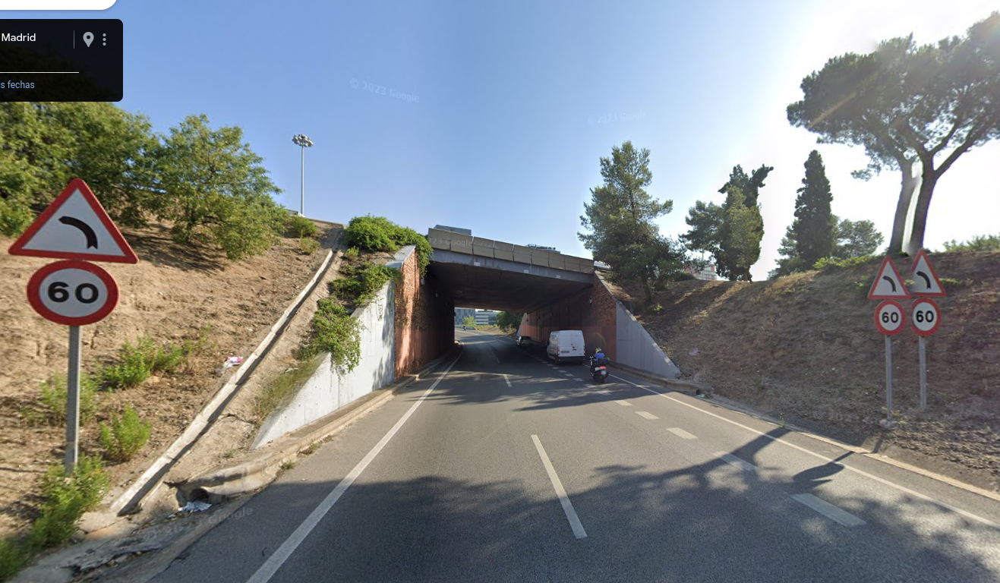

In [68]:
display_img("img/AUTOV. M-30, +03200E Puente.png")

Imagen Final del puente

ValueError: Could not save to JPEG for display

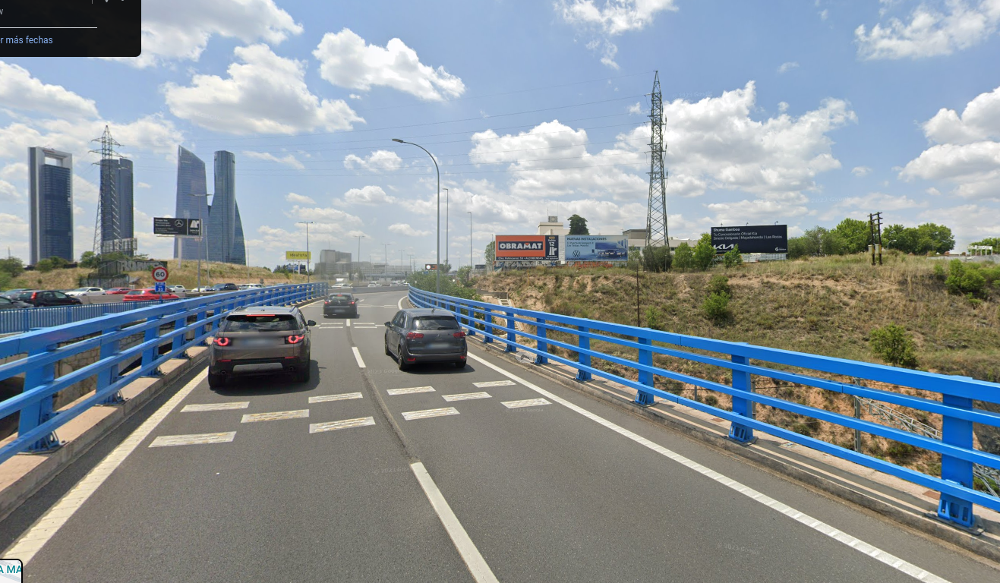

In [69]:
display_img("img/AUTOV. M-30, +03200E Puente Final.png")

Veamos el carril central, donde han ocurrido algunas colisiones por alcance

ValueError: Could not save to JPEG for display

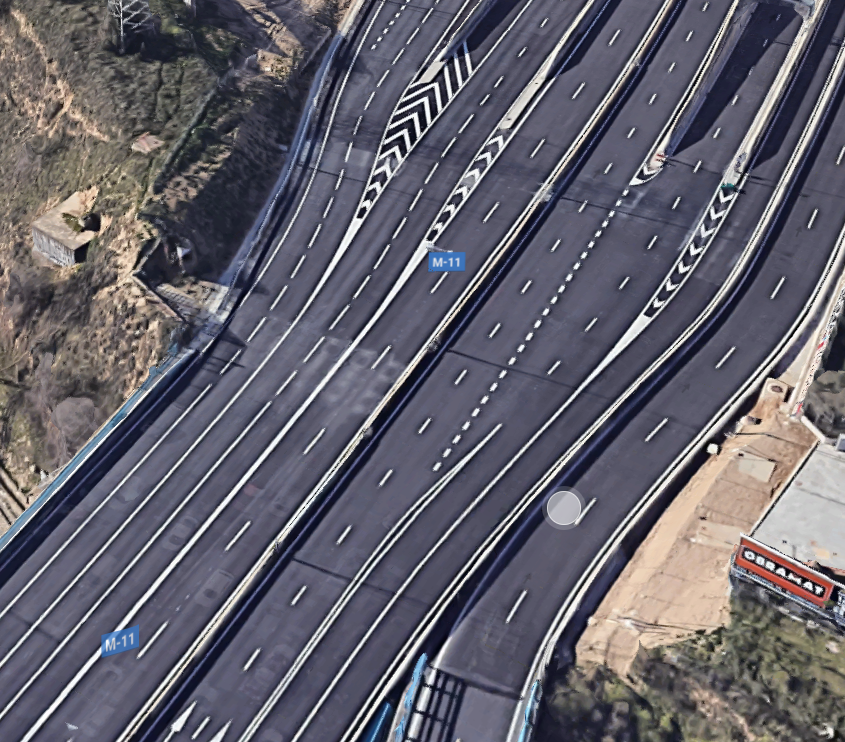

In [70]:
display_img("img/AUTOV. M-30, +03200E GOOGLE CENITAL.png")

El trazado es correcto y no debería llevar a colisiones. No hay más hechos relevantes que analizar. Es posible que por la corta duración del desvío hacia el túnel algunos conductores se incorporen a última hora o tengan que frenar en exceso.

Veamos la imagen de la dirección contraria